![Nuclio logo](https://nuclio.school/wp-content/uploads/2018/12/nucleoDS-newBlack.png)

# TFM - Análisis Exploratorio de Datos (EDA)

### *Descripción del dataset y su contexto:*
El presente dataset contiene información detallada sobre propiedades en venta, incluyendo su precio, ubicación, dimensiones y diversas características adicionales. Cada registro representa un anuncio de un inmueble y cuenta con datos sobre su barrio, distrito, consumo energético y otros atributos socioeconómicos.

El objetivo de este Notebook es analizar el conjunto de datos para extraer insights que permitan comprender mejor el mercado inmobiliario en Madrid y detectar patrones que puedan ser útiles para la toma de decisiones.

### *Objetivos del EDA:*
1. Comprender la estructura del dataset: Identificar el número de registros y columnas, los tipos de datos y la presencia de valores nulos o inconsistencias.
2. Analizar la distribución de las variables: Explorar la variabilidad en precios, metros cuadrados, ubicaciones y otras características relevantes.
3. Detectar relaciones y correlaciones: Investigar posibles asociaciones entre las variables y su impacto en el precio de los inmuebles.
4. Identificar valores atípicos: Detectar posibles errores o anomalías en los datos que puedan afectar el análisis.
5. Generar insights clave: Extraer información relevante para futuros estudios o modelos de predicción del valor de los inmuebles.

Este análisis servirá como base para entender mejor la dinámica entre las variables y obtener un fichero CSV para ejecutar un modelo predictivo del precio de las vviendas en Madrid.

# *1. Librerías y configuración*

In [2709]:
# Principales
import pandas as pd
import numpy as np
from IPython.display import HTML

# Modificaciones
import re
from unidecode import unidecode
import unicodedata
import datetime
import os
import math
from scipy.stats import mode
# Visuzalizaciones
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.io as pio
from plotly.subplots import make_subplots
import plotly.graph_objs as go
from plotly.offline import iplot
import plotly.figure_factory as ff
import missingno as msno
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import RobustScaler
import json
from joblib import dump
import gc

In [2710]:
# Forzar la recolección de basura
gc.collect()

184896

In [2712]:
import warnings

#Ignorar todos los warnings
warnings.filterwarnings("ignore")


In [2713]:
pd.set_option('display.max_info_columns', 110 )
pd.set_option("display.max_columns", None)
pd.set_option('display.max_rows', 80)
pd.set_option('display.float_format', lambda x: '%.2f' % x)
pd.set_option('display.max_colwidth', None)
# Ajustar la configuración para mostrar más filas
# pd.set_option('display.max_rows', 500)

# Inicializar la lista to replace
to_replace=['Null', 'Nan', 'nan', 'NULL', None]

# *2. Funciones*

In [2714]:
# Función que agrupa las columnas por tipo de dato

def columnas_por_tipo(df):
    # Filtrar columnas por tipo de datos
    int_columns = [col for col in df.columns if df[col].dtype.name.startswith('int')]
    float_columns = [col for col in df.columns if df[col].dtype.name.startswith('float')]
    # Lista de columnas que contienen exclusivamente los valores 0, 1 y NaN
    boolean_columns=[col for col in df.columns if set(df[col].dropna().unique()) <= {0, 1}]
    
    numeric_cols = int_columns + float_columns
    num_nobool = list(set(numeric_cols)-set(boolean_columns))
    object_columns = df.select_dtypes(include='object').columns.tolist()
    category_columns = df.select_dtypes(include='category').columns.tolist()
    cols = df.columns.tolist()

    cat_columns=list(set(category_columns) - set(boolean_columns) )
    # Obtener todas las columnas
    all_columns = set(df.columns)
    # Columnas de otros tipos
    other_columns = list(all_columns - set(int_columns) - set(float_columns) - set(object_columns) - set(category_columns))
    cols_noboolean = set(cols) - set(boolean_columns)

    # Contar el número de columnas de cada tipo
    num_int_columns = len(int_columns)
    num_float_columns = len(float_columns)
    num_object_columns = len(object_columns)
    num_category_columns = len(category_columns)
    num_other_columns = len(other_columns)

    # Mostrar los resultados
    print("Número de columnas de tipo entero:", num_int_columns)
    print("Columnas de tipo entero:", int_columns)
    print("------------------------------------------------------")
    print("Número de columnas de tipo float:", num_float_columns)
    print("Columnas de tipo float:", float_columns)
    print("------------------------------------------------------")
    print("Número de columnas de tipo object:", num_object_columns)
    print("Columnas de tipo object:", object_columns)
    print("------------------------------------------------------")
    print("Número de columnas de tipo category:", num_category_columns)
    print("Columnas de tipo category:", category_columns)
    print("------------------------------------------------------")
    print("Número de columnas de otros tipos:", num_other_columns)
    print("Columnas de otros tipos:", other_columns)

    return boolean_columns, numeric_cols, cat_columns, object_columns, other_columns, num_nobool, cols_noboolean

In [2715]:
def dataframe_summary(df):
    """Generamos una función que nos genera un sumario del dataframe, incluyendo tipos de datos, valores únicos..."""
    
    obs = df.shape[0] #Número de filas
    types = df.dtypes #Tipos de datos
    counts = df.apply(lambda x: x.count()) #Número total
    distincts = df.apply(lambda x: x.nunique()) #Valores únicos
    nulls = df.isnull().sum() #Número total de nulos
    missing_ratio = (nulls / obs) * 100 #Porcentaje de missings respecto al total
    skewness = df.select_dtypes(include='number').skew() #Asimetría
    kurtosis = df.select_dtypes(include='number').kurt() #Curtosis
    top_vals = df.apply(lambda x: x.value_counts(dropna=False).index[0]) #Valores más repetidos
    top_counts = df.apply(lambda x: x.value_counts(dropna=False).iloc[0]) #La moda de cada variable
    top_percent = (top_counts / obs) * 100 #Porcentaje del que más se repite
    
    #Concatenamos todos
    summary_df = pd.concat([types, counts, distincts, nulls, missing_ratio, top_vals, top_counts, top_percent, skewness, kurtosis], axis=1)
    
    #Creamos las columnas
    summary_df.columns = ["Type", "Count", "Distinct", "Missing", "Missing_Ratio", "Most_Common", "Most_Common_Count", "Most_Common_Percent", "Skewness", "Kurtosis"]
    columnas_por_tipo(df)
    return summary_df

In [2716]:
def graficobarrascategoricas(df, colname):
    """Genera un gráfico de barras para una variable categórica, mostrando las 10 categorías más frecuentes y agrupando el resto como 'Otros'.

    Parameters:
    df (DataFrame): El DataFrame que contiene los datos.
    colname (str): Nombre de la variable categórica.

    Returns:
    None
    """
    # Obtener las frecuencias de las categorías
    value_counts = df[colname].value_counts()

    # Seleccionar las 10 categorías más frecuentes
    top_10 = value_counts.head(10)

    # Agrupar el resto en 'Otros'
    other_count = value_counts.tail(len(value_counts) - 10).sum()  # Sumar las frecuencias de las categorías restantes
    if other_count > 0:  # Solo agrupar si hay categorías para agrupar
        otros_series = pd.Series({'Otros': other_count})
        top_10 = pd.concat([top_10, otros_series])  # Usamos pd.concat() en lugar de append

    # Crear el gráfico de barras
    return top_10

In [2717]:
def plot_histogram_boxplot(df, input_name, target_name, bins=30, num_groups=4, show_price_legend=True):
    """
    Genera un histograma y un boxplot para una variable numérica con respecto a grupos de precio.
    
    :param df: DataFrame ordenado por precio.
    :param input_name: Nombre de la columna numérica a analizar.
    :param target_name: Nombre de la columna de precio.
    :param bins: Número de bins para el histograma.
    :param num_groups: Número de grupos en los que se dividirá la variable precio.
    :param show_price_legend: Si True, muestra los rangos de los grupos de precio.
    """
    # Crear los grupos de precio
    df["price_group"] = pd.qcut(df[target_name], num_groups, labels=[f"Q{i+1}" for i in range(num_groups)], duplicates='drop')
    
    # Crear la figura con dos subgráficos
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    
    # Histograma sin leyenda de colores
    sns.histplot(df, x=input_name, bins=bins, hue="price_group", element="step", palette="coolwarm", ax=axes[0], kde=True,legend=False)
    axes[0].set_xlabel(input_name)
    axes[0].set_ylabel("Frecuencia")

    # Boxplot
    sns.boxplot(x="price_group", y=input_name, data=df, palette="pastel", ax=axes[1])
    axes[1].set_xlabel("Grupo del target")
    axes[1].set_ylabel(input_name)
    
    # Agregar leyenda con los valores de los grupos de precio
    if show_price_legend:
        price_ranges = df.groupby("price_group")[target_name].agg(["min", "max"])
        labels = [f"{index}: {int(row['min']):,} - {int(row['max']):,}" for index, row in price_ranges.iterrows()]
        axes[0].text(0.95, 0.95, "\n".join(labels), transform=axes[0].transAxes,
                     verticalalignment='top', horizontalalignment='right', fontsize=10, bbox=dict(facecolor='white', alpha=0.6))
    
    plt.tight_layout()
    plt.show()


In [2718]:
def count_duplicate_rows(df):
    """
    Comprobar la cantidad de filas duplicadas en un DataFrame.

    Esta función toma un DataFrame como entrada y devuelve el número de filas duplicadas.
    Si el DataFrame está vacío o no tiene filas duplicadas, devuelve 0.

    Parámetros:
    df (pandas.DataFrame): El DataFrame a comprobar.

    Devuelve:
    int: El número de filas duplicadas en el DataFrame.

    Raises:
    TypeError: Si el parámetro no es un DataFrame de pandas.
    """
    if not isinstance(df, pd.DataFrame):
        raise TypeError("El parámetro debe ser un DataFrame de pandas")

    if df.empty:
        return 0

    duplicate_rows = df.duplicated().sum()
    return duplicate_rows

In [2719]:
def generar_barplot_media_mediana(df, cat_vars, target_var):
    """
    Genera gráficos en dos columnas: barplots con la media y mediana
    de una variable numérica (target_var) frente a varias categóricas.

    :param df: DataFrame de pandas con los datos.
    :param cat_vars: Lista de variables categóricas.
    :param target_var: Variable numérica a analizar (por ejemplo, 'precio').
    """
    filas = len(cat_vars)  # Una fila por variable categórica
    plt.figure(figsize=(15, filas * 5))  # Ajustar tamaño según número de filas

    for i, var in enumerate(cat_vars):
        # Gráfico de la media
        plt.subplot(filas, 2, 2 * i + 1)  # Columna 1: Media
        sns.barplot(x=df[var], y=df[target_var], estimator=np.mean)
        plt.xticks(rotation=90)  # Rotar etiquetas si son largas
        plt.title(f'Media de {target_var} por {var}')
        plt.xlabel(var)
        plt.ylabel(f'Media de {target_var}')

        # Gráfico de la mediana
        plt.subplot(filas, 2, 2 * i + 2)  # Columna 2: Mediana
        sns.barplot(x=df[var], y=df[target_var], estimator=np.median)
        plt.xticks(rotation=90)
        plt.title(f'Mediana de {target_var} por {var}')
        plt.xlabel(var)
        plt.ylabel(f'Mediana de {target_var}')

    plt.tight_layout()  # Ajustar el espacio entre gráficos
    plt.show()

In [2720]:
def categorize_ano_construccion(value):
    # Si el valor es NaN, lo dejamos como NaN
    if pd.isna(value):
        return np.nan
    try:
        # Convertimos el valor a float si es numérico
        value = float(value)

        # Asignamos el valor a las franjas de años correspondientes
        if value < 1973:
            return 'Más de 50 años'
        elif 1973 <= value <= 1993:
            return 'Entre 30 y 50 años'
        elif 1993 < value <= 2013:
            return 'Entre 10 y 30 años'
        elif 2013 < value <= 2018:
            return 'Entre 5 y 10 años'
        elif value > 2018:
            return 'Menos de 5 años'
        else:
            return np.nan  # En caso de que no cumpla con ninguna condición
    except:
        # Si el valor no es un número, lo dejamos como está
        value=str(value).strip()

        return value

In [2721]:
def agrupar_antiguedad(valor):
    if valor in ['Menos de 5 años', 'Menos de 5 Anos','Menos de 5 Años']:
        return 'menos_5'
    elif valor in ['Menos de 10 años','Entre 5 y 10 años']:
        return '5_10'
    elif valor in ['Entre 10 y  15 Años', 'Entre 10 y 15 Años', 'Entre 5 y 10 años', 'Entre 15 y 20 Años', 'Entre 10 y 30 años', 'Entre 10 y 20 años', 'Entre 20 y 30 años', 'Entre 15 y 20 Anos','Entre 10 y 15 Anos', 'Entre 15 y 20 años', 'Entre 20 y 25 Anos','Entre 10 y  15 Anos']:
        return '10_30'
    elif valor in ['Entre 25 y 35 años','Entre 35 y 50 Años','Mas de 25 Años','Entre 20 y 25 Años','Entre 30 y 50 años', 'Entre 35 y 50 Anos']:
        return '30_50'
    elif valor in ['Más de 50 años', 'Mas de 50 anos', 'Mas de 25 Anos']:
        return 'mas_50'
    else:
        return valor

In [2722]:
def extract_num(col):
    try:
        # Si el valor es un número flotante o entero, convertirlo a float (por ejemplo, 1.0 o 2)
        if isinstance(col, (int, float)):
            return float(col)

        # Si el valor es una cadena y contiene un número, extraemos el primer número
        return float(col.split()[0])
    except:
        return np.nan

In [2723]:
def reduce_mem_usage(df, turn_cat=False, silence=True):
    """Itera sobre todo el dataset convirtiendo cada columna en el tipo más adecuado para ahorrar memoria.

    Parameters
    ----------
    df : pd.DataFrame
        Dataframe que se quiere reducir.
    turn_cat : bool, optional
        Transformación de las columnas objeto o string a category, by default False.

    Returns
    -------
    pd.DataFrame
        Dataframe optimizado.
    """

    start_mem = df.memory_usage().sum() / 1024**2  # Memoria inicial

    for col in df.columns:
        col_type = df[col].dtype

        if col_type != object and not isinstance(col_type, pd.CategoricalDtype):
            c_min = df[col].min()
            c_max = df[col].max()

            if pd.api.types.is_numeric_dtype(df[col]):
                if str(col_type)[:3] == 'int':
                    if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                        df[col] = df[col].astype(np.int8)
                    elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                        df[col] = df[col].astype(np.int16)
                    elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                        df[col] = df[col].astype(np.int32)
                    elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                        df[col] = df[col].astype(np.int64)
                else:
                    if c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                        df[col] = df[col].astype(np.float32)
                    else:
                        df[col] = df[col].astype(np.float64)

                # Conversión de float a int si no hay decimales y no hay NaN
                df[col] = df[col].fillna(0)  # Rellenar NaN antes de verificar si son enteros
                # Check if the column is of type float before applying is_integer
                if df[col].dtype.kind == 'f':
                    if all(df[col].apply(float.is_integer)):
                        df[col] = df[col].astype(np.int64)

        # Conversión de objetos a categoría si turn_cat es True
        if turn_cat and col_type == object:
            df[col] = df[col].astype('category')

    end_mem = df.memory_usage().sum() / 1024**2  # Memoria final

    if not silence:
        print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
        print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    return df

In [2724]:
# Función para identificar si es público o privado
def extract_texto(col, texto1, texto2):
    if isinstance(col, str):  # Solo aplicar 'lower()' si el valor es una cadena
        if texto1 in col.lower():
            return texto1
        elif texto2 in col.lower():
            return texto2
    return np.nan

In [2725]:
def asignar_columna(row, diccionario, col_asignar, col_agrupar, colfiltrado, valfiltrado):
    if pd.isnull(row[col_asignar]) and row[colfiltrado] == valfiltrado and pd.notnull(row[col_agrupar]):
        return diccionario.get(row[col_agrupar], 0) + 1
    return row[col_asignar]

In [2726]:
def completar_nulo_con_moda(df, columnas, val):
    """
    val=2 impto la moda
    val=3 imputo la media
    val=1 imputo 1
    val=0 imputo 0
    Aplica la moda para completar valores nulos en columnas específicas y crea una columna asociada
    que indica si los valores fueron imputados.

    Parámetros:
        df (pd.DataFrame): El DataFrame original.
        columnas (list): Lista de columnas a procesar.
        val (int): Método de imputación (2 para moda, 3 para media, 1 o 0 para valores fijos).
    
    Retorna:
        int: Número total de filas que se han cambiado (valores nulos reemplazados).
    """
    filas_cambiadas = 0  # Contador de filas con valores nulos imputados

    for col in columnas:
        # Calcular el valor de imputación
        if val == 2:
            valor = df[col].mode()[0]
        elif val == 3:
            valor = round(df[col].mean())  # Redondear la media
        else:
            valor = val

        # Crear una nueva columna indicadora de imputación
        indicador_col = f"{col}_es_imputado"
        df[indicador_col] = df[col].isnull().astype(int)  # 1 si era nulo, 0 si no

        # Contar valores nulos antes de reemplazar
        filas_cambiadas += df[col].isnull().sum()

        # Reemplazar valores nulos con el valor calculado
        df[col] = df[col].fillna(valor)

    return filas_cambiadas


In [2727]:
def categorizar_cocina(texto):
    if pd.isnull(texto):
        return 'Desconocido'  # Manejar valores nulos
    texto = texto.lower()  # Convertir a minúsculas para evitar problemas de coincidencia
    if 'no amueblada' in texto:
        return 'No_ amueblada'
    elif 'independiente' in texto:
        return 'Independiente'
    elif 'abierta' in texto:
        return 'Abierta'
    elif 'con isla' in texto:
        return 'Isla'
    elif 'amueblada' in texto:
        return 'Amueblada'
    elif 'equipada' in texto:
        return 'Equipada'
    elif 'reformada' in texto:
        return 'Reformada'
    elif 'sin reforma' in texto:
        return 'Sin_reforma'
    else:
        return 'Desconocido'  # Categoría por defecto


In [2728]:
def clasificar_vivienda(row):
    if row['exterior'] == 1:
        return 2  # Valor para exterior
    elif row['interior'] == 1:
        return 0  # Valor para interior
    else:
        return 1  # Valor para el resto

In [2729]:


def calcular_estadistico_por_col(df,  col_agr, columnas, metodo):
    """
    # Calcula un estadístico (media, moda, mediana, etc.) por col para las columnas especificadas.

    # Args:
    #     df: df de Pandas con los datos.
    #      col_agr: Columna por la cual agrupar.
    #     columnas: Lista de columnas para calcular el estadístico.
    #     metodo: Método para calcular el estadístico ('mean', 'median', 'mode').

    # Returns:
    #     Diccionario con los resultados del estadístico por col para cada columna.
    # """
   
def calcular_estadistico_por_col(df, col_agr, columnas, metodo):
    estadistico_por_col = {}

    for columna in columnas:
        if metodo == 'median':
            estadistico_por_col[columna] = df.groupby(col_agr)[columna].median().to_dict()
        elif metodo == 'mean':
            estadistico_por_col[columna] = df.groupby( col_agr)[columna].mean().to_dict()
        elif metodo == 'mode':
            estadistico_por_col[columna] = (
                df.groupby(col_agr)[columna]
                .apply(lambda x: x.dropna().mode().iloc[0] if not x.dropna().mode().empty else np.nan)
                .to_dict()
            )

    return estadistico_por_col



def imputar_valores(df, estadistico_por_col,  col_agr):
    """
    Imputa valores nulos en un df usando los valores calculados por col.

    Args:
        df: df en el cual imputar valores.
        estadistico_por_col: Diccionario con los valores por col (output de calcular_estadistico_por_col).
        col_agr: Columna por la cual agrupar para imputar valores.

    Returns:
        df con los valores imputados.
    """
    df_imputado = df.copy()
    for columna, estadisticos in estadistico_por_col.items():
        for grupo, valor in estadisticos.items():
            # Reemplazar valores nulos con el estadístico correspondiente por grupo
            df_imputado.loc[
                (df_imputado[col_agr] == grupo) & (df_imputado[columna].isnull()),
                columna
            ] = valor
    return df_imputado


In [2730]:
def calcular_est_por_cols(df, cols_agr, columnas, metodo):
    """
    Calcula un estadístico (media, moda, mediana, etc.) por una o varias columnas para las columnas especificadas.
    
    Args:
        df: DataFrame de Pandas con los datos.
        col_agr: Columna o lista de columnas por las cuales agrupar.
        columnas: Lista de columnas para calcular el estadístico.
        metodo: Método para calcular el estadístico ('mean', 'median', 'mode').

    Returns:
        Diccionario con los resultados del estadístico por col para cada columna.
    """
    estadistico_por_col = {}
    
    for columna in columnas:
        if metodo == 'median':
            estadistico_por_col[columna] = df.groupby(list(cols_agr))[columna].median().to_dict()
        elif metodo == 'mean':
            estadistico_por_col[columna] = df.groupby(list(cols_agr))[columna].mean().to_dict()
        elif metodo == 'mode':
            estadistico_por_col[columna] = (
                df.groupby(list(cols_agr))[columna]
                .apply(lambda x: x.dropna().mode().iloc[0] if not x.dropna().mode().empty else np.nan)
                .to_dict()
            )
    
    return estadistico_por_col

def imputar_cols_valores(df, estadistico_por_col, cols_agr):
    """
    Imputa valores nulos en un DataFrame usando los valores calculados por col.

    Args:
        df: DataFrame en el cual imputar valores.
        estadistico_por_col: Diccionario con los valores por col (output de calcular_estadistico_por_col).
        col_agr: Columna o lista de columnas por las cuales agrupar para imputar valores.

    Returns:
        DataFrame con los valores imputados.
    """
    df_imputado = df.copy()
    
    for columna, estadisticos in estadistico_por_col.items():
        for grupo, valor in estadisticos.items():
            # Si `col_agr` es una lista, hay que comparar todas las columnas con `grupo`
            if isinstance(cols_agr, list):
                condicion = (df_imputado[cols_agr] == pd.Series(grupo, index=cols_agr)).all(axis=1)
            else:
                condicion = df_imputado[cols_agr] == grupo

            df_imputado.loc[condicion & df_imputado[columna].isnull(), columna] = valor

    return df_imputado



In [2731]:
def categorizar_suelo(texto):
    # Manejar valores nulos
    if pd.isnull(texto):
        return 'Desconocido'
    
    # Normalizar texto
    texto = texto.lower()
    
    # Palabras clave para cada categoría
    madera_keywords = ['parquet', 'tarima', 'madera', 'pino melis', 'parket']
    gres_keywords = ['gres', 'porcelanato', 'porcelanico']
    piedra_keywords = ['mármol', 'mosaico']
    baldosa_keywords = ['terrazo', 'baldosa']
    otros_keywords = ['sintasol', 'moqueta', 'otros']
    
    # Clasificar según palabras clave
    if any(keyword in texto for keyword in madera_keywords):
        return 'Madera'
    elif any(keyword in texto for keyword in gres_keywords):
        return 'Gres'
    elif any(keyword in texto for keyword in piedra_keywords):
        return 'Piedra'
    elif 'radiante' in texto:
        return 'Radiante'
    elif any(keyword in texto for keyword in baldosa_keywords):
        return 'Baldosa'
    elif any(keyword in texto for keyword in otros_keywords):
        return 'Otros'
    else:
        return 'Desconocido'


In [2732]:
def clasificar_barrios_por_m2(df, num_grupos=5):
    # Calcular el precio promedio por barrio
    codbarrio_precios = df.groupby('cod_barrio')['m2_constr'].mean().reset_index()

    # Clasificar los códigos de barrio en los grupos (calculando los cortes a partir de dftrain)
    codbarrio_precios['cod_barrio_m2_contr'], bins = pd.qcut(
        codbarrio_precios['m2_constr'], q=num_grupos, labels=[1, 2, 3, 4, 5], retbins=True
    )

    # Crear un diccionario de mapeo para asignar grupos a cada barrio en el DataFrame original
    cod_barrio_mapping = dict(zip(codbarrio_precios['cod_barrio'], codbarrio_precios['cod_barrio_m2_contr']))
    df['cod_barrio_m2_contr'] = df['cod_barrio'].map(cod_barrio_mapping)

    # Contar viviendas por grupo
    cod_barrio_m2_contr_counts = df["cod_barrio_m2_contr"].value_counts(dropna=False).sort_index()

    # Mostrar la descripción de cada grupo con su rango de m2_constr
    print("\nClasificación de barrios según m2_constr:")
    for i, (group, count) in enumerate(cod_barrio_m2_contr_counts.items()):
        lower_bound = bins[i]  # Límite inferior del grupo
        upper_bound = bins[i + 1]  # Límite superior del grupo
        print(f"Grupo {group}: {count} viviendas, rango de m2_constr: {lower_bound:.2f} - {upper_bound:.2f}")

         # Guardar los datos necesarios en JSON para reutilización
    datos_guardados = {
        "cod_barrio_mapping": {str(k): int(v) for k, v in cod_barrio_mapping.items()},
        "bins": bins.tolist()
    }

    with open( rutajson +"clasificacion_barrios_m2.json", "w") as f:
        json.dump(datos_guardados, f)


    return df, bins  # Retornamos el dataframe y los límites de los cortes


# Aplicar la misma clasificación en X_val y X_test usando los mismos límites de corte
def aplicar_clasificacion(df, bins):
    # Asignar a cada barrio el grupo que le corresponde usando los mismos límites de `bins` de dftrain
    cod_barrio_mapping = dict(zip(df['cod_barrio'], pd.cut(df['m2_constr'], bins=bins, labels=[1, 2, 3, 4, 5])))
    df['cod_barrio_m2_contr'] = df['cod_barrio'].map(cod_barrio_mapping)
    return df


In [2733]:
def imputar_col_con_mediana(df, cols, mediana_dict=None):
    """
    Imputa los valores nulos de las columnas especificadas con la mediana de cada columna en el DataFrame.
    Si se pasa un diccionario con medianas previamente calculadas, se usa esa mediana.

    Args:
        df (pd.DataFrame): DataFrame de pandas.
        cols (list): Lista de nombres de las columnas donde imputar los valores nulos.
        mediana_dict (dict, opcional): Diccionario con las medianas por columna. Si no se pasa, se calcula la mediana.
    
    Returns:
        pd.DataFrame: DataFrame con los valores nulos de las columnas imputados.
        dict: Diccionario con las medianas calculadas, si no se pasó previamente.
    """
    # Si no se pasa el diccionario, lo creamos
    if mediana_dict is None:
        mediana_dict = {}

    for col in cols:
        # Calculamos la mediana si no está en el diccionario
        if col not in mediana_dict:
            mediana_dict[col] = df[col].median()  # Calcula la mediana de la columna especificada

        # Imputa los nulos con la mediana guardada en el diccionario
        df[col].fillna(mediana_dict[col], inplace=True)  # Imputa los nulos con la mediana

    return df, mediana_dict


In [2734]:


def encode_column(df, column_name):
    # Inicializar el codificador OneHotEncoder
    encoder = OneHotEncoder(sparse_output=False)
    
    # Codificar la columna seleccionada
    encoded_array = encoder.fit_transform(df[[column_name]])
    
    # Convertir el array codificado a un DataFrame
    encoded_df = pd.DataFrame(encoded_array, columns=encoder.get_feature_names_out([column_name]))
    
    # Eliminar la columna original y añadir las columnas codificadas
    df_encoded = pd.concat([df.drop(column_name, axis=1).reset_index(drop=True), encoded_df], axis=1)
    
    return df_encoded
 # Función para codificar una lista de columnas
 
def encode_columns(df, column_list):
    # Iterar sobre cada columna de la lista
    for column in column_list:
        df = encode_column(df, column)  # Llamar a la función encode_column
    return df

In [2735]:

# Función mejorada para manejar las columnas correctamente
def create_col_suma(df, new_column_name, cols):
    df[new_column_name] = 0  # Inicializamos la nueva columna con 0
    for col in cols:
        # Verificamos si el valor es '' o NaN y asignamos 0 en ese caso, de lo contrario sumamos el valor
        df[new_column_name] += df[col].apply(lambda x: 0 if (x == '' or pd.isnull(x)) else x)
    return df


In [2736]:
def plot_scatter_matrix(df, variables, target=None, num_por_fila=5, figsize=(16, 12)):
    """
    Genera gráficos de dispersión para una lista de variables.
    
    Parámetros:
    - df: DataFrame con los datos.
    - variables: Lista de variables numéricas a graficar.
    - target: Variable objetivo (opcional) para colorear los puntos.
    - num_por_fila: Número de gráficos por fila.
    - figsize: Tamaño de la figura.
    """
    num_filas = (len(variables) + num_por_fila - 1) // num_por_fila  # Calcular filas necesarias
    fig, axes = plt.subplots(num_filas, num_por_fila, figsize=figsize)
    axes = axes.flatten()  # Asegurar que sea una lista de ejes
    
    for i, col in enumerate(variables):
        if target:
            sns.scatterplot(data=df, x=col, y=target, ax=axes[i], alpha=0.5)
            axes[i].set_ylabel(target)
        else:
            sns.scatterplot(data=df, x=df.index, y=col, ax=axes[i], alpha=0.5)
            axes[i].set_xlabel("Índice")
        
        axes[i].set_title(col)
    
    # Eliminar gráficos vacíos si hay menos de num_por_fila * num_filas
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()



In [2737]:
def plot_outliers_bar(df, variables, method='IQR'):
    """
    Genera un gráfico de barras con la suma de outliers por variable.
    
    Parámetros:
    - df: DataFrame con los datos.
    - variables: Lista de variables numéricas a analizar.
    - method: Método para detectar outliers ('IQR' o 'z-score').
    """
    outlier_counts = {}
    
    for col in variables:
        if method == 'IQR':
            Q1 = df[col].quantile(0.25)
            Q3 = df[col].quantile(0.75)
            IQR = Q3 - Q1
            outliers = df[(df[col] < Q1 - 1.5 * IQR) | (df[col] > Q3 + 1.5 * IQR)]
        elif method == 'z-score':
            mean = df[col].mean()
            std = df[col].std()
            z_scores = (df[col] - mean) / std
            outliers = df[np.abs(z_scores) > 3]
        else:
            raise ValueError("Método no válido. Use 'IQR' o 'z-score'.")
        
        outlier_counts[col] = len(outliers)
    
    # Crear gráfico de barras
    plt.figure(figsize=(10, 8))
    sns.barplot(x=list(outlier_counts.keys()), y=list(outlier_counts.values()), color='salmon')
    plt.xticks(rotation=90)
    plt.xlabel("Variables")
    plt.ylabel("Número de Outliers")
    plt.title("Cantidad de Outliers por Variable")
    plt.show()



In [2738]:
def stacked_bar_plot_mean(df, x_var, hue_var, value_var, title=None, figsize=(12, 6)):
    """
    Genera un gráfico de barras apiladas basado en la media de una variable.

    Parámetros:
    - df: DataFrame de Pandas con los datos.
    - x_var: Columna para el eje X (variable categórica principal).
    - hue_var: Columna que define las categorías apiladas (los colores).
    - value_var: Variable numérica (por ejemplo, precio) usada para calcular la media.
    - title: Título del gráfico (opcional).
    - figsize: Tamaño de la figura (ancho, alto).
    """
    # Crear una tabla cruzada con la media de value_var
    crosstab = pd.crosstab(index=df[x_var], columns=df[hue_var], values=df[value_var], aggfunc='mean')
    
    # Crear el gráfico apilado
    ax = crosstab.plot(kind='bar', stacked=True, figsize=figsize, colormap='viridis')
    
    # Agregar etiquetas y título
    ax.set_title(title or f"Media de {value_var} por {x_var} y {hue_var}", fontsize=16)
    ax.set_xlabel(x_var, fontsize=14)
    ax.set_ylabel(f"Media de {value_var}", fontsize=14)
    plt.legend(title=hue_var, fontsize=10, loc='upper left')
    plt.tight_layout()
    plt.show()




In [2739]:
# Asegúrate de que las claves en los diccionarios sean cadenas, si es necesario
def convertir_claves_a_str(obj):
    if isinstance(obj, dict):
        return {str(k): convertir_claves_a_str(v) for k, v in obj.items()}
    elif isinstance(obj, list):
        return [convertir_claves_a_str(i) for i in obj]
    else:
        return obj




In [2740]:
import pandas as pd
import matplotlib.pyplot as plt

def stacked_bar_plot_dual(df, x_var, hue_var, value_var, title=None, figsize=(16, 6)):
    """
    Genera dos gráficos de barras apiladas:
    1. Gráfico con los valores reales (media de value_var).
    2. Gráfico con las proporciones respecto al total.

    Parámetros:
    - df: DataFrame de Pandas con los datos.
    - x_var: Columna para el eje X (variable categórica principal).
    - hue_var: Columna que define las categorías apiladas (los colores).
    - value_var: Variable numérica (por ejemplo, precio) usada para calcular la media.
    - title: Título del gráfico (opcional).
    - figsize: Tamaño de la figura (ancho, alto).
    """
    # Crear una tabla cruzada con la media de value_var (valores reales)
    crosstab_mean = pd.crosstab(index=df[x_var], columns=df[hue_var], values=df[value_var], aggfunc='mean')
    
    # Crear una tabla cruzada con las proporciones respecto al total
    crosstab_prop = crosstab_mean.div(crosstab_mean.sum(axis=1), axis=0)  # Normalizar por filas

    # Crear la figura y los ejes
    fig, axes = plt.subplots(1, 2, figsize=figsize)

    # Gráfico 1: Valores reales
    crosstab_mean.plot(kind='bar', stacked=True, ax=axes[0], colormap='viridis')
    axes[0].set_title("Media de Precio por Distrito y Estado", fontsize=14)
    axes[0].set_xlabel(x_var, fontsize=12)
    axes[0].set_ylabel(f"Media de {value_var}", fontsize=12)
    axes[0].legend(title=hue_var, fontsize=10)

    # Gráfico 2: Proporciones
    crosstab_prop.plot(kind='bar', stacked=True, ax=axes[1], colormap='viridis')
    axes[1].set_title("Proporción del Total por Distrito y Estado", fontsize=14)
    axes[1].set_xlabel(x_var, fontsize=12)
    axes[1].set_ylabel("Proporción", fontsize=12)
    axes[1].legend(title=hue_var, fontsize=10)
    axes[1].get_legend().remove() 

    # Ajustar el diseño para evitar superposiciones
    fig.suptitle(title or "Comparación de Valores Reales y Proporciones", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()





In [2741]:

def graficar_booleanas_apiladas(df, lista_columnas, titulo="Distribución de Variables Booleanas"):
    """
    Genera un gráfico de barras apiladas para visualizar la distribución de variables booleanas.
    
    Parámetros:
    - df: DataFrame de pandas con los datos.
    - lista_columnas: Lista de columnas booleanas a incluir en el gráfico.
    - titulo: Título del gráfico (opcional).
    """
    # Crear un DataFrame para almacenar proporciones de valores 0 y 1
    proporciones = pd.DataFrame(index=["0 (No)", "1 (Sí)"])
    
    for col in lista_columnas:
        if col in df.columns:
            counts = df[col].value_counts(normalize=True)
            proporciones[col] = [counts.get(0, 0), counts.get(1, 0)]
        else:
            print(f"La columna '{col}' no existe en el DataFrame.")
    
    # Crear el gráfico de barras apiladas
    ax = proporciones.T.plot(kind="bar", stacked=True, figsize=(12, 6), color=["skyblue", "orange"])
    ax.set_title(titulo, fontsize=16)
    ax.set_xlabel("Variables Booleanas", fontsize=12)
    ax.set_ylabel("Proporción", fontsize=12)
    ax.legend(title="Valores", fontsize=10, loc="upper right")
    plt.xticks(rotation=90, ha="right")
    plt.tight_layout()
    plt.show()


# *3. Carga de datos*

Carga del fichero con las caracteristicas de los pisos

In [2742]:
dfEDA= pd.read_csv('./data/pisosEDA.csv',sep=";",index_col=False,low_memory=False)


Carga del fichero con las caracteristicas adicionales que se van a añadir al modelo

In [2743]:
# Cargar datos adicionales desde una ruta relativa
dfadicionales = pd.read_csv('../01-preprocesamiento-de-datos/02-datos-limpios/Datos_adicionales.csv', sep=";", index_col=False)



In [2744]:
rutajson=('./json/')

# *4. Exploración de datos*

In [2745]:
pd.options.display.float_format = '{:.2f}'.format #Mostramos solamente dos decimales
HTML(dataframe_summary(dfEDA).to_html(classes=["table-bordered", "table-striped", "table-hover"]))

Número de columnas de tipo entero: 3
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'precio']
------------------------------------------------------
Número de columnas de tipo float: 46
Columnas de tipo float: ['precio_anterior', 'descuento', 'EUR/m2', 'm2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'num_plantas', 'inmueble_ingresos', 'alquiler_opcion_a_compra', 'nuda_propiedad', 'tiene_armario', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'fibra_optica', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'acceso_discapacidad', 'armarios', 'codigo_Postal', 'm2_utiles', 'certificado_energetico', 'tiene_jardin', 'num_visitas', 'num

,Type,Count,Distinct,Missing,Missing_Ratio,Most_Common,Most_Common_Count,Most_Common_Percent,Skewness,Kurtosis
title,object,10032,6306,0,0.00,Piso en venta en Madrid,112,1.12,NaN,NaN
url,object,10032,10032,0,0.00,https://www.indomio.es/anuncios/75404850/,1,0.01,NaN,NaN
precio_anterior,float64,54,49,9978,99.46,NaN,9978,99.46,2.38,6.23
descuento,float64,54,35,9978,99.46,NaN,9978,99.46,-2.85,12.30
EUR/m2,float64,7743,5357,2289,22.82,NaN,2289,22.82,0.95,0.56
m2_constr,float64,10032,552,0,0.00,70.00,178,1.77,7.92,133.99
distrito,object,10032,21,0,0.00,Centro,1781,17.75,NaN,NaN
cod_distrito,int64,10032,21,0,0.00,1,1792,17.86,0.62,-0.73
barrio,object,10032,131,0,0.00,Goya,442,4.41,NaN,NaN
cod_barrio,int64,10032,131,0,0.00,42,442,4.41,0.63,-0.74


In [2746]:
HTML(dataframe_summary(dfadicionales).to_html(classes=["table-bordered", "table-striped", "table-hover"])) #Aplicamos formato HTML

Número de columnas de tipo entero: 8
Columnas de tipo entero: ['cod_municipio', 'cod_distrito', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones']
------------------------------------------------------
Número de columnas de tipo float: 36
Columnas de tipo float: ['cod_barrio', 'codigo_Postal', 'm2_areasverdes', 'lineas_metro', 'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano', 'Renta neta media por persona', 'Renta neta media por hogar', 'Mediana de la renta por unidad de consumo', 'Renta bruta media por persona', 'Renta bruta media por hogar', 'Habitantes', 'Hogares', 'Tamaño del hogar (Nº de personas en la vivienda)', 'hog_con_1', 'hog_con_2', 'hog_con_3', 'hog_con_4', 'hog_con_5', 'hog_con_6', 'hog_con_7', 'hog_con_8', 'hog_con_9', 'hog_con_10', 'hog_con_11', 'hog_con_12', 'hog_con_13', 'hog_con_14', 'hog_con_15 y más', 'Comercio_ServiciosMinoristas', 'H

,Type,Count,Distinct,Missing,Missing_Ratio,Most_Common,Most_Common_Count,Most_Common_Percent,Skewness,Kurtosis
cod_municipio,int64,152,1,0,0.00,28079,152,100.00,0.00,0.00
municipio,object,152,1,0,0.00,Madrid,152,100.00,NaN,NaN
cod_distrito,int64,152,21,0,0.00,15,10,6.58,0.06,-1.10
distrito,object,152,21,0,0.00,Ciudad Lineal,10,6.58,NaN,NaN
cod_barrio,float64,131,131,21,13.82,NaN,21,13.82,0.06,-1.08
barrio,object,152,152,0,0.00,Centro,1,0.66,NaN,NaN
codigo_Postal,float64,131,49,21,13.82,NaN,21,13.82,-0.15,-0.83
m2_areasverdes,float64,21,21,131,86.18,NaN,131,86.18,4.32,19.32
num_personas,int64,152,152,0,0.00,139687,1,0.66,2.50,5.99
num_personas_hombres,int64,152,152,0,0.00,70770,1,0.66,2.51,6.03


In [2747]:
print(f"El DataFrame dfEDA tiene {dfEDA.shape[0]} filas y {dfEDA.shape[1]} columnas.")
print(f"El DataFrame dfadicionales tiene {dfadicionales.shape[0]} filas y {dfEDA.shape[1]} columnas.")

El DataFrame dfEDA tiene 10032 filas y 91 columnas.
El DataFrame dfadicionales tiene 152 filas y 91 columnas.


In [2748]:
dfEDA.head(1)

,title,url,precio_anterior,descuento,EUR/m2,m2_constr,distrito,cod_distrito,barrio,cod_barrio,zona,calle,consumoce_ano,letra_ce,emisiones_co2,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,calefaccion,antiguedad,num_plantas,aire_acondicionado,jardin,inmueble_ingresos,alquiler_opcion_a_compra,nuda_propiedad,tipo_inmueble,tiene_armario,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,cocina,fibra_optica,exterior,interior,piscina,porton_electrico,alarma,videoportero,acceso_discapacidad,precio,web,fecha_descarga,actualizacion,armarios,codigo_Postal,m2_utiles,referencia,tipo_suelo,certificado_energetico,tiene_jardin,descripcion_larga,num_visitas,fecha_publicacion,titularanuncio,num_pisos,puerta_seguridad,zonas_verdes,gastos_comunidad,tiene_piscina,tipo_fachada,agua_caliente,nombre_oficina,portero,orientacion_este,orientacion_oeste,orientacion_sur,clasificacion_aire,grupo_cocina,orientacion_norte,emisiones_ano,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion,titular_anuncio
0,"Ático Calle de Núñez de Balboa 2, Recoletos, Madrid",https://www.indomio.es/anuncios/75404850/,NaN,NaN,20.00,100.00,Salamanca,4,Recoletos,41,Recoletos,calle de nunez de balboa 2,"≥ 3,51",F,D,Atico,Para Reformar,Sólo cocina amueblada,1,1.00,1.00,1.00,1.00,1.0,1.00,1.00,Central,NaN,NaN,NaN,NaN,NaN,NaN,NaN,lujo,NaN,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,NaN,1.00,1.00,0.00,1,0.00,0,1.00,1.00,2000000,Indomio.com,2024-11-20,NaN,NaN,28001.00,NaN,NaN,NaN,1.00,NaN,-Atico test atico test atico test atico test atico test atico test atico test atico test atico test atico test atico test atico test,NaN,NaN,NaN,NaN,1.00,NaN,100,1.00,NaN,NaN,NaN,0.5,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,NaN,F,Central,No clasificado en energía,Radiadores,-Atico test atico test atico test atico test atico test atico test atico test atico test atico test atico test atico test atico test


In [2749]:
dfEDA.columns

Index(['title', 'url', 'precio_anterior', 'descuento', 'EUR/m2', 'm2_constr',
       'distrito', 'cod_distrito', 'barrio', 'cod_barrio', 'zona', 'calle',
       'consumoce_ano', 'letra_ce', 'emisiones_co2', 'tipologia', 'estado',
       'amueblado', 'planta', 'dormitorios', 'banos', 'balcon', 'terraza',
       'garaje', 'trastero', 'ascensor', 'calefaccion', 'antiguedad',
       'num_plantas', 'aire_acondicionado', 'jardin', 'inmueble_ingresos',
       'alquiler_opcion_a_compra', 'nuda_propiedad', 'tipo_inmueble',
       'tiene_armario', 'cancha_tenis',
       'carpinteria_exterior_doble_vidrio/pvc',
       'carpinteria_exterior_doble_vidrio/madera',
       'carpinteria_exterior_doble_vidrio/metal',
       'carpinteria_exterior_triple_vidrio/madera',
       'carpinteria_exterior_triple_vidrio/metal',
       'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera',
       'carpinteria_exterior_vidrio/metal', 'chimenea', 'cocina',
       'fibra_optica', 'exterior', 'interi

In [2750]:
dfEDA.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
title,10032,6306,Piso en venta en Madrid,112,NaN,NaN,NaN,NaN,NaN,NaN,NaN
url,10032,10032,https://www.indomio.es/anuncios/75404850/,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
precio_anterior,54.00,NaN,NaN,NaN,812929.63,977732.38,98100.00,197750.00,432000.00,949875.00,4900000.00
descuento,54.00,NaN,NaN,NaN,-7.79,2.99,-23.10,-9.00,-7.25,-5.75,-5.00
EUR/m2,7743.00,NaN,NaN,NaN,3791.18,4003.89,1.02,7.12,3097.00,6434.50,27708.00
...,...,...,...,...,...,...,...,...,...,...,...
letra_emisiones,2150,7,E,897,NaN,NaN,NaN,NaN,NaN,NaN,NaN
tipo_calefaccion,10032,3,No clasif,8210,NaN,NaN,NaN,NaN,NaN,NaN,NaN
energia_calefaccion,10032,6,No clasificado en energía,8850,NaN,NaN,NaN,NaN,NaN,NaN,NaN
instalacion_calefaccion,10032,5,Radiadores,9725,NaN,NaN,NaN,NaN,NaN,NaN,NaN


En esta primera tabla, ya vemos variables con desviación tipica 0, (tiene_armario,inmuebles_ingresos,alquiler_con_opcion_compra) por lo que podremos eliminar esas columnas que no aportan información al estudio.

In [2751]:
# Compramos que la columna url tiene valores únicos
dfEDA['url'].nunique() == len(dfEDA)

True

In [2752]:
# Tratar las columnas para quitar espacios si tuvieran y poner el nombre de las columnas en minúsculas
# para tener desde el primer momento siempre el mismo nombre de columnas.
dfEDA.columns = [col.strip().lower() for col in dfEDA.columns]

In [2753]:
dfEDA.columns.tolist()

['title',
 'url',
 'precio_anterior',
 'descuento',
 'eur/m2',
 'm2_constr',
 'distrito',
 'cod_distrito',
 'barrio',
 'cod_barrio',
 'zona',
 'calle',
 'consumoce_ano',
 'letra_ce',
 'emisiones_co2',
 'tipologia',
 'estado',
 'amueblado',
 'planta',
 'dormitorios',
 'banos',
 'balcon',
 'terraza',
 'garaje',
 'trastero',
 'ascensor',
 'calefaccion',
 'antiguedad',
 'num_plantas',
 'aire_acondicionado',
 'jardin',
 'inmueble_ingresos',
 'alquiler_opcion_a_compra',
 'nuda_propiedad',
 'tipo_inmueble',
 'tiene_armario',
 'cancha_tenis',
 'carpinteria_exterior_doble_vidrio/pvc',
 'carpinteria_exterior_doble_vidrio/madera',
 'carpinteria_exterior_doble_vidrio/metal',
 'carpinteria_exterior_triple_vidrio/madera',
 'carpinteria_exterior_triple_vidrio/metal',
 'carpinteria_exterior_vidrio/pvc',
 'carpinteria_exterior_vidrio/madera',
 'carpinteria_exterior_vidrio/metal',
 'chimenea',
 'cocina',
 'fibra_optica',
 'exterior',
 'interior',
 'piscina',
 'porton_electrico',
 'alarma',
 'videoporter

In [2754]:
print(f"El DataFrame dfadicionalestiene {dfadicionales.shape[0]} filas y {dfadicionales.shape[1]} columnas.")

El DataFrame dfadicionalestiene 152 filas y 48 columnas.


In [2755]:
dfadicionales.columns

Index(['cod_municipio', 'municipio', 'cod_distrito', 'distrito', 'cod_barrio',
       'barrio', 'codigo_Postal', 'm2_areasverdes', 'num_personas',
       'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones',
       'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'lineas_metro',
       'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias',
       'estacion_bus_urbano', 'Renta neta media por persona',
       'Renta neta media por hogar',
       'Mediana de la renta por unidad de consumo',
       'Renta bruta media por persona', 'Renta bruta media por hogar',
       'Habitantes', 'Hogares', 'tamano_medio_del_hogar',
       'Tamaño del hogar (Nº de personas en la vivienda)', 'hog_con_1',
       'hog_con_2', 'hog_con_3', 'hog_con_4', 'hog_con_5', 'hog_con_6',
       'hog_con_7', 'hog_con_8', 'hog_con_9', 'hog_con_10', 'hog_con_11',
       'hog_con_12', 'hog_con_13', 'hog_con_14', 'hog_con_15 y más',
       'Comercio_ServiciosMinoristas', 'Hosteleria_Rest

In [2756]:
#Eliminación de columnas redundantes o que no aportan información al modelo

In [2757]:
columnas_eliminar=['eur/m2','tiene_piscina',"tiene_jardin",'title','precio_anterior','descuento','zona','calle','emisiones_co2','referencia',"fecha_publicacion","titular_anuncio",'titularanuncio',"cocina",
"nombre_oficina","num_visitas" ,'alarma','num_pisos','descuento','consumoce_ano','emisiones_ano', 'calefaccion','aire_acondicionado','fecha_descarga','actualizacion','descripcion_larga','zonas_verdes','nombre_oficina','fibra_optica']
# columnas_eliminar=['tiene_piscina',"tiene_jardin",'title','precio_anterior','EUR/m2','descuento','zona','calle','emisiones_co2','referencia',"fecha_publicacion","titular_anuncio",'titularanuncio',"cocina",
# "nombre_oficina","num_visitas" ,'alarma','num_pisos','descuento','consumoce_ano','emisiones_ano', 'calefaccion','aire_acondicionado','fecha_descarga','actualizacion','descripcion_larga','zonas_verdes','nombre_oficina','fibra_optica']


dfEDA = dfEDA.drop(columns=columnas_eliminar)

In [2758]:
dfEDA.shape

(10032, 64)

## *4.1 Tipo de datos*

In [2759]:
# Función `columnas_por_tipo` que muestra un resumen de los tipo de columnas que hay en el dataframe
boolean_columns, cols_num, cat_columns,object_columns,other_columns,num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 3
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'precio']
------------------------------------------------------
Número de columnas de tipo float: 36
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'num_plantas', 'inmueble_ingresos', 'alquiler_opcion_a_compra', 'nuda_propiedad', 'tiene_armario', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'acceso_discapacidad', 'armarios', 'codigo_postal', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_

### *4.1.1 Transformación del tipo de variables*

Vamos a cambiar el tipo de dato de las siguientes columnas

In [2760]:
dfEDA.rename(columns={'clasificacion_aire': 'aire'}, inplace=True)

cols = ["barrio", "distrito", "letra_ce","letra_emisiones",
        "tipologia", "estado", "tipo_inmueble", "tipo_suelo", "tipo_fachada", "agua_caliente",
        "grupo_cocina", "tipo_calefaccion", "energia_calefaccion",
        "instalacion_calefaccion", "antiguedad","aire"]


for c in cols:
    # Convertir columna a categórica
    dfEDA[c] = dfEDA[c].astype('category')
   

In [2761]:
#Trasformamos a númericas

cols=['tamano_medio_del_hogar']
for c in cols:
    # Reemplazar comas por puntos y forzar conversiones
    dfadicionales[c] = dfadicionales[c].str.replace(',', '.').astype(float)
    

In [2762]:
#Transformar a entero

cols=['cod_barrio', 'cod_distrito','codigo_postal']
for c in cols:
    # Reemplazar comas por puntos y forzar conversiones
    dfEDA[c] = dfEDA[c].astype(int)

## *4.2 Identificacion de valores nulos*

Los valores nulos pueden afectar los análisis estadísticos y las visualizaciones.

Antes de tomar decisiones sobre cómo gestionar los valores nulos, tenemos que evaluar cuántos datos faltan y en qué proporción dentro del conjunto de datos.

Tenemos que entender por qué faltan los datos.

En este conjunto de datos, tomados mediante la técnica de web scraping, tendremos valores nulos fundamentalmente por tres motivos y siempre de manera aleatoria:
  - El proceso de scraping no ha tomado todos los valores de cada vivienda publicada en la web.
  - La web no informaba del dato porque no lo consideró necesario (p. ej., carpinterías).
  - La web no informaba del dato porque la vivienda tenía ausencia de ello (p. ej., piscina).

Los datos faltantes pueden ser:
  - Aleatorios, sin depender de otras variables.
  - Relacionados con otras variables observadas.
  - Los datos faltan debido a factores relacionados con los valores en sí mismos, lo que puede introducir sesgos.


Al tratar los valores nulos tenemos que evitar introducir sesgos que puedan alterar la interpretación de los datos. Si, por ejemplo, los datos faltantes están asociados con patrones específicos, tratarlos incorrectamente podría distorsionar los resultados.


Para tratarlos, revisaremos:
- La cantidad de valores nulos por columna.
- El porcentaje de valores nulos en relación con el total de datos.
- Identificación y eliminación de columnas con más del 90% de valores nulos
- Visualización de los valores nulos para identificar patrones.


In [2763]:
# Verificar valores nulos por columna
valores_nulos = dfEDA.isnull().sum()

print("Valores nulos por columna:")
print(valores_nulos[valores_nulos > 0])

Valores nulos por columna:
letra_ce                                      7881
estado                                        4505
amueblado                                     8811
planta                                        4550
dormitorios                                    224
banos                                          422
balcon                                        8616
terraza                                       7574
garaje                                        8063
trastero                                      7382
ascensor                                      5457
antiguedad                                    6628
num_plantas                                   9816
jardin                                        7997
inmueble_ingresos                            10022
alquiler_opcion_a_compra                     10029
nuda_propiedad                               10017
tipo_inmueble                                 8139
tiene_armario                                 8146
canc

In [2764]:
# Ver porcentaje de valores nulos
porcentaje_nulos = (dfEDA.isnull().sum() / len(dfEDA)) * 100

print("\nPorcentaje de valores nulos por columna:")
print(porcentaje_nulos[porcentaje_nulos > 0])


Porcentaje de valores nulos por columna:
letra_ce                                    78.56
estado                                      44.91
amueblado                                   87.83
planta                                      45.35
dormitorios                                  2.23
banos                                        4.21
balcon                                      85.89
terraza                                     75.50
garaje                                      80.37
trastero                                    73.58
ascensor                                    54.40
antiguedad                                  66.07
num_plantas                                 97.85
jardin                                      79.71
inmueble_ingresos                           99.90
alquiler_opcion_a_compra                    99.97
nuda_propiedad                              99.85
tipo_inmueble                               81.13
tiene_armario                               81.20
cancha_t

Representación grafica de los valores nulos

In [2765]:
# Convertir valores nulos en 1 y valores no nulos en 0
df_nulos = dfEDA.isnull().astype(int)

# Graficar con imshow y ajustar el tamaño de la figura
fig = px.imshow(df_nulos, 
                labels={'x': 'Columnas', 'y': 'Índices', 'color': 'Nulo'},
                color_continuous_scale='blues', 
                title="Mapa de Valores Nulos",
                height=500,
                width=1800)  #

fig.show()


*El análisis de valores nulos nos permite detectar qué columnas requieren tratamiento antes de continuar con el análisis exploratorio. Realizaremos la imputación de esos nulos en variables importantes como dormitorios y baño y evaluar la eliminación de aquellas con un alto porcentaje de valores faltantes si no aportan información significativa al estudio.*

Observaciones:
- Se identifican múltiples columnas con una gran cantidad de valores nulos p.e. "alquiler-opcion_a_compra" ó "acceso_discapacidad" (representadas en azul oscuro).
- Algunas columnas tienen valores ausentes de manera dispersa, como puede ser "letra_ce", mientras que otras presentan grandes bloques de datos faltantes ("videoportero").
- Hay varias variables con una cantidad significativa de valores faltantes, especialmente aquellas relacionadas con características del inmueble, carpintería, eficiencia energética,etc
- La variable target `precio` asi como las variables de ubicación `distrito` y `barrio` no tienen valores nulos.

Vamos a eliminare columnas con mas del 95% de valores nulos ya que aportan muy poca información y manterlas aumenta la complejidad sin ofrecer beneficios.

In [2766]:
# Identificamos las columnas con más del 95% de valores nulos para eliminarlas
for col in dfEDA.columns:
    porcentaje_nulos = dfEDA[col].isnull().mean() * 100
    if porcentaje_nulos > 95:
        print(f'Columna {col}: {porcentaje_nulos:.2f}% nulos')

Columna num_plantas: 97.85% nulos
Columna inmueble_ingresos: 99.90% nulos
Columna alquiler_opcion_a_compra: 99.97% nulos
Columna nuda_propiedad: 99.85% nulos
Columna acceso_discapacidad: 97.53% nulos
Columna tipo_fachada: 98.20% nulos
Columna portero: 97.68% nulos


In [2767]:
#viviendas con columnas inmueble_ingresos,alquiler_opcion_a_compra y nuda_propiedads con valor 1 
dfEDA.query("inmueble_ingresos==1 | alquiler_opcion_a_compra==1 | nuda_propiedad==1").count()

url                                          26
m2_constr                                    26
distrito                                     26
cod_distrito                                 26
barrio                                       26
cod_barrio                                   26
letra_ce                                      8
tipologia                                    26
estado                                       12
amueblado                                    11
planta                                       12
dormitorios                                  25
banos                                        26
balcon                                        6
terraza                                       8
garaje                                       15
trastero                                     13
ascensor                                     11
antiguedad                                   13
num_plantas                                  12
jardin                                  

Las siguientes columnas presentan un alto porcentaje de valores nulos:

- **`inmueble_ingresos`**: 99.91% de los valores son nulos.
- **`alquiler_opcion_a_compra`**: 99.97% de los valores son nulos.
- **`nuda_propiedad`**: 99.87% de los valores son nulos.

Estas columnas se refieren a viviendas con características específicas de transacción:
- **`alquiler_opcion_a_compra`**:viviendas en alquiler con opción a compra según contrato.
- **`inmueble_ingresos`**: Representa viviendas alquiladas que generan ingresos.
- **`nuda_propiedad`**: Corresponde a viviendas donde no se tiene la posesión plena (por ejemplo, derechos limitados sobre la propiedad).


Debido al bajo tamaño de muestra para estas categorías, he decidido eliminar este tipo de viviendas del análisis. El modelo se construirá exclusivamente para viviendas de venta libre de cargas, lo que permitirá obtener resultados más representativos y útiles.

In [2768]:
# Get the index of the rows to be removed
eliminar_filas = dfEDA.query("inmueble_ingresos==1 | alquiler_opcion_a_compra==1 | nuda_propiedad==1").index

# Keep only the rows that are NOT in the index_to_remove
dfEDA = dfEDA[~dfEDA.index.isin(eliminar_filas)]

Elimino las columnas con más de 95% de valores nulos

In [2769]:
# Identificar y eliminar columnas con más del 95% de valores nulos
columnas_a_eliminar = [col for col in dfEDA.columns if dfEDA[col].isnull().mean() * 100 > 95]
print(f"Columnas eliminadas: {columnas_a_eliminar}")

# Eliminar las columnas del DataFrame
dfEDA = dfEDA.drop(columns=columnas_a_eliminar)
print("El DataFrame actualizado tiene estas columnas:")
print(dfEDA.columns)

Columnas eliminadas: ['num_plantas', 'inmueble_ingresos', 'alquiler_opcion_a_compra', 'nuda_propiedad', 'acceso_discapacidad', 'tipo_fachada', 'portero']
El DataFrame actualizado tiene estas columnas:
Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'garaje', 'trastero', 'ascensor',
       'antiguedad', 'jardin', 'tipo_inmueble', 'tiene_armario',
       'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc',
       'carpinteria_exterior_doble_vidrio/madera',
       'carpinteria_exterior_doble_vidrio/metal',
       'carpinteria_exterior_triple_vidrio/madera',
       'carpinteria_exterior_triple_vidrio/metal',
       'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera',
       'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior',
       'piscina', 'porton_electrico', 'videoportero', 'precio', 'web',
     

## *4.3 Identificación variables con varianza nula*

In [2770]:
# Función `columnas_por_tipo` que muestra un resumen de los tipo de columnas que hay en el dataframe
boolean_columns, cols_num, cat_columns,object_columns,other_columns,num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 4
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'precio', 'codigo_postal']
------------------------------------------------------
Número de columnas de tipo float: 30
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'tiene_armario', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'armarios', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte']
------------------------------------------------------
Número de columnas de tipo object: 8
Colum

In [2771]:
# Calcular la desviación estándar de cada columna
dfEDAn=dfEDA[cols_num]
desviaciones = dfEDAn.std()

# Identificar columnas con desviación estándar igual a 0 o cercana 
umbral = 0.01 
columnas_a_eliminar = desviaciones[desviaciones <= umbral].index

# Mostrar las columnas identificadas
print("Columnas con desviación estándar igual a 0 o cercana:")
print(columnas_a_eliminar)



Columnas con desviación estándar igual a 0 o cercana:
Index(['tiene_armario'], dtype='object')


In [2772]:
# Eliminamos  las columna tiene_armario del DataFrame ya que es una columna practicamente constante que no aportará nada al moelo
dfEDA = dfEDA.drop(columns='tiene_armario')

print("Columnas eliminadas. El DataFrame actualizado tiene estas columnas:")
print(dfEDA.columns)


Columnas eliminadas. El DataFrame actualizado tiene estas columnas:
Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'garaje', 'trastero', 'ascensor',
       'antiguedad', 'jardin', 'tipo_inmueble', 'cancha_tenis',
       'carpinteria_exterior_doble_vidrio/pvc',
       'carpinteria_exterior_doble_vidrio/madera',
       'carpinteria_exterior_doble_vidrio/metal',
       'carpinteria_exterior_triple_vidrio/madera',
       'carpinteria_exterior_triple_vidrio/metal',
       'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera',
       'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior',
       'piscina', 'porton_electrico', 'videoportero', 'precio', 'web',
       'armarios', 'codigo_postal', 'm2_utiles', 'tipo_suelo',
       'certificado_energetico', 'puerta_seguridad', 'gastos_comunidad',
       'agua_calien

## *4.4 Identificación de datos duplicados*

Identificamos si existen registros duplicados ya que pueden distorsionar el análisis y deben ser detectados para eliminarlos.

In [2773]:
duplicados = dfEDA.duplicated().sum()

print(f"\nNúmero de registros duplicados: {duplicados}")


Número de registros duplicados: 0


In [2774]:
# Mostrar ejemplos de registros duplicados (si existen)
if duplicados > 0:
    print("\nEjemplo de registros duplicados:")
    display(dfEDA[dfEDA.duplicated()].head())

In [2775]:
dfEDA.shape

(10006, 56)

* Analizaremos si es posible que tengamos el mismo piso en venta en distintas webs, para ello identificamos como primary key la combinación de esas columnas 

['cod_barrio', 'cod_distrito','codigo_postal','m2_constr', 'dormitorios', 'banos', 'precio','estado','planta']

In [2776]:
# Definir las columnas que deben coincidir para ser consideradas duplicadas
columnas_unicas = ['cod_barrio', 'cod_distrito','codigo_postal','m2_constr', 'dormitorios', 'banos', 'precio','estado','planta']

# Crear una columna con la concatenación de los valores de estas columnas
dfEDA['concat_values'] = dfEDA[columnas_unicas ].astype(str).agg('-'.join, axis=1)

# Contar cuántas veces aparece cada combinación de valores en 'concat_values'
conteo = dfEDA['concat_values'].value_counts()

# Filtrar solo las combinaciones que aparecen más de una vez
valores_duplicados = conteo[conteo > 1].index

# Filtrar el DataFrame original para obtener solo las filas con esos valores duplicados
df_duplicados = dfEDA[dfEDA['concat_values'].isin(valores_duplicados)].copy()

# Contar cuántos valores únicos hay en 'web' para cada 'concat_values'
web_count = df_duplicados.groupby('concat_values')['web'].nunique()

# Filtrar solo las combinaciones donde 'web' tiene más de un valor único (diferentes sitios web)
duplicados_dif_web = web_count[web_count > 1].index

# Filtrar el DataFrame original para obtener las filas finales
df_duplicados=df_duplicados[df_duplicados['concat_values'].isin(duplicados_dif_web)]


# Mostrar el resultado ordenado por la cantidad de repeticiones
df_duplicados = df_duplicados.sort_values(by='concat_values', ascending=False)


In [2777]:
dfEDA.shape,df_duplicados.shape

((10006, 57), (253, 57))

In [2778]:
df_duplicados.head()

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,letra_ce,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,antiguedad,jardin,tipo_inmueble,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,exterior,interior,piscina,porton_electrico,videoportero,precio,web,armarios,codigo_postal,m2_utiles,tipo_suelo,certificado_energetico,puerta_seguridad,gastos_comunidad,agua_caliente,orientacion_este,orientacion_oeste,orientacion_sur,aire,grupo_cocina,orientacion_norte,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion,concat_values
7441,https://www.pisos.com/comprar/piso-chamberi_vallehermoso28003-45049733830_100500/,180.00,Chamberí,7,Vallehermoso,76,NaN,Piso,NaN,NaN,1,4.00,3.00,1.00,1.00,1.0,NaN,1.00,Más de 50 años,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1075000,pisos.com,1.00,28003,NaN,Parquet,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,NaN,Central,No clasificado en energía,Radiadores,76-7-28003-180.0-4.0-3.0-1075000-nan-1
1404,https://www.indomio.es/anuncios/96500375/,180.00,Chamberí,7,Vallehermoso,76,E,Piso,NaN,NaN,1,4.00,3.00,1.00,1.00,NaN,0.00,1.00,1960,sin jardin,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,sin piscina,0.00,0.00,1075000,Indomio.com,NaN,28003,NaN,NaN,1.00,0.00,270,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,E,No clasif,No clasificado en energía,Radiadores,76-7-28003-180.0-4.0-3.0-1075000-nan-1
3868,https://www.pisos.com/comprar/piso-chamberi_vallehermoso28003-45872679450_104700/,115.00,Chamberí,7,Vallehermoso,76,NaN,Piso,A Reformar,NaN,NaN,3.00,2.00,NaN,NaN,1.0,NaN,1.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,630000,pisos.com,1.00,28003,102.00,Parquet,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,1.00,NaN,Central,No clasificado en energía,Radiadores,76-7-28003-115.0-3.0-2.0-630000-A Reformar-nan
7885,https://www.redpiso.es/inmueble/piso-en-venta-en-avenida-reina-victoria-vallehermoso-chamberi-madrid-madrid-RP1812024127515,115.00,Chamberí,7,Vallehermoso,76,NaN,Piso,A Reformar,NaN,NaN,3.00,2.00,NaN,NaN,1.0,NaN,1.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.00,NaN,NaN,NaN,NaN,630000,redpiso,1.00,28003,102.00,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,1.00,NaN,No clasif,No clasificado en energía,Radiadores,76-7-28003-115.0-3.0-2.0-630000-A Reformar-nan
4197,https://www.pisos.com/comprar/piso-rios_rosas28003-45908753621_104700/,47.00,Chamberí,7,Ríos Rosas,75,NaN,Piso,A Reformar,NaN,NaN,2.00,1.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,269900,pisos.com,NaN,28003,NaN,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores,75-7-28003-47.0-2.0-1.0-269900-A Reformar-nan


In [2779]:
dfEDA.precio.describe()

count      10006.00
mean      890420.05
std      1160143.61
min        54000.00
25%       239900.00
50%       480000.00
75%      1090000.00
max     19950000.00
Name: precio, dtype: float64

In [2780]:
dfEDA.shape

(10006, 57)

In [2781]:
print(f"Porcentaje de valores nulos en la columna 'precio': {(dfEDA['precio'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'precio': 0.00%


In [2782]:
# Mostrar el número de filas duplicadas iniciales
print(f"Filas duplicadas inicialmente: {df_duplicados.shape[0]}")

# Lista para almacenar las URLs de las filas eliminadas
urls_eliminadas = []

# Paso 2: Iterar sobre las combinaciones duplicadas de 'concat_values'
for concat_value, group in df_duplicados.groupby('concat_values'):
    if len(group) == 2:
        # Obtener las filas duplicadas
        primera_fila = group.iloc[0].copy()  # Asegurarnos de que es una copia independiente
        segunda_fila = group.iloc[1]

        # Verificar si las columnas son iguales entre ambas filas
        if list(primera_fila.index) == list(segunda_fila.index):
            # Rellenar los valores nulos de 'primera_fila' con los valores de 'segunda_fila'
            for col in primera_fila.index:
                if col not in columnas_unicas:  # No tocar las columnas clave
                    if pd.isnull(primera_fila[col]):  
                        primera_fila[col] = segunda_fila[col]
        else:
            print("Las columnas no coinciden entre las dos filas")

        # Guardar la URL de la fila eliminada
        urls_eliminadas.append(segunda_fila['url'])

        # Buscar la fila en dfEDA con la misma 'url' y actualizar solo esas columnas
        dfEDA.loc[dfEDA['url'] == primera_fila['url'], primera_fila.index] = primera_fila.values

        # Eliminar la segunda fila en dfEDA
        dfEDA = dfEDA[dfEDA['url'] != segunda_fila['url']]

        # Eliminar la segunda fila también de df_duplicados
        df_duplicados = df_duplicados[df_duplicados['url'] != segunda_fila['url']]

# Mostrar el número de filas después de la eliminación
print(f"Filas después de eliminar duplicados: {dfEDA.shape[0]}")
print(f"Filas duplicadas restantes: {df_duplicados.shape[0]}")

# Verificar si quedaron filas con todos sus valores nulos
filas_nulas = dfEDA[dfEDA.isnull().all(axis=1)]
print(f"Filas completamente nulas después de la operación: {filas_nulas.shape[0]}")

# Mostrar las URLs de las filas eliminadas
print("URLs de las filas eliminadas:")
print(urls_eliminadas)


Filas duplicadas inicialmente: 253
Filas después de eliminar duplicados: 9910
Filas duplicadas restantes: 157
Filas completamente nulas después de la operación: 0
URLs de las filas eliminadas:
['https://www.pisos.com/comprar/piso-centro_palacio28013-46690088281_102100/', 'https://www.indomio.es/anuncios/95617945/', 'https://www.indomio.es/anuncios/94450029/', 'https://www.pisos.com/comprar/piso-centro_palacio28013-40930978295_100500/', 'https://www.pisos.com/comprar/piso-centro_palacio28013-40901699776_100500/', 'https://www.indomio.es/anuncios/95959513/', 'https://www.redpiso.es/inmueble/piso-en-venta-en-calle-mercedes-arteaga-opanel-carabanchel-madrid-madrid-RP512024128941', 'https://www.redpiso.es/inmueble/casa-en-venta-en-calle-ramon-serrano-vista-alegre-carabanchel-madrid-madrid-RP1372023122036', 'https://www.indomio.es/anuncios/95672083/', 'https://www.pisosmadrid.com.es/propiedad/3874232-piso-en-venta-en-centro-madrid', 'https://www.pisos.com/comprar/piso-centro_embajadores_lava

In [2783]:
print(f"Porcentaje de valores nulos en la columna 'precio': {(dfEDA['precio'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'precio': 0.00%


In [2784]:
dfEDA.shape,df_duplicados.shape

((9910, 57), (157, 57))

In [2785]:
dfEDA.precio.describe()

count       9910.00
mean      887793.66
std      1147550.35
min        54000.00
25%       239000.00
50%       479000.00
75%      1090000.00
max     19950000.00
Name: precio, dtype: float64

#ahora los duplicados que tengo son de mas de dos registros
#comparemos las webs por que duplicados de la misma web no son duplicados

In [2786]:
df_duplicados["estado"].value_counts(dropna=False)

estado
NaN                        149
A Reformar                   7
En Buen Estado               1
Para Reformar                0
Óptimo / Reformado           0
reformado                    0
perfecto estado              0
buen estado                  0
Reformado                    0
Perfecto Estado              0
A Estrenar                   0
Obra Nueva                   0
Nuevo / En Construcción      0
Depende Del Precio           0
Bueno / Habitable            0
Buen estado                  0
Buen Estado                  0
Obra nueva                   0
Name: count, dtype: int64

En Obra nueva es facil tener duplicados por que puede haber varias viviendas con las mismas caracterisicas de localización ,m2, precio, etc. En segunda mano suponemos que se ha publicado la misma vivienda en diferentes webs.

In [2787]:
# Mostrar el número de filas duplicadas iniciales
print(f"Filas duplicadas inicialmente: {df_duplicados.shape[0]}")

# Lista para almacenar las URLs de las filas eliminadas
urls_eliminadas = []

# Paso 2: Iterar sobre las combinaciones duplicadas de 'concat_values'
for concat_value, group in df_duplicados.groupby('concat_values'):
    if len(group) > 2:
        # Ordenar por URL para asegurar consistencia en la selección
        group = group.sort_values(by='url').reset_index(drop=True)
        
        # Obtener las filas duplicadas
        filas = [group.iloc[n] for n in range(len(group))]
        
        # Empezamos con la primera fila (que mantendremos)
        primera_fila = filas[0].copy()

        # Iterar sobre las demás filas (excepto la primera)
        for i in range(1, len(filas)):
            segunda_fila = filas[i]

            # Rellenar solo los valores nulos en primera_fila con los de segunda_fila
            for col in primera_fila.index:
                if pd.isnull(primera_fila[col]) and not pd.isnull(segunda_fila[col]):
                    primera_fila[col] = segunda_fila[col]

            # Añadir la URL de la fila eliminada a la lista
            urls_eliminadas.append(segunda_fila['url'])

        # Actualizar la fila en dfEDA solo si existe
        if primera_fila['url'] in dfEDA['url'].values:
            dfEDA.loc[dfEDA['url'] == primera_fila['url'], primera_fila.index] = primera_fila.values

        # Eliminar todas las filas excepto la primera en dfEDA
        dfEDA = dfEDA[~dfEDA['url'].isin(urls_eliminadas)]

        # Eliminar todas las filas del grupo en df_duplicados
        df_duplicados = df_duplicados[~df_duplicados['url'].isin(urls_eliminadas)]

# Mostrar el número de filas después de la eliminación
print(f"Filas después de eliminar duplicados: {dfEDA.shape[0]}")


# Verificar si quedaron filas con valores NaN en precio
nulos_precio = dfEDA['precio'].isnull().sum()
print(f"Filas con precio nulo después de la operación: {nulos_precio}")

# Mostrar las URLs de las filas eliminadas
print("URLs de las filas eliminadas:")
print(urls_eliminadas)


Filas duplicadas inicialmente: 157
Filas después de eliminar duplicados: 9868
Filas con precio nulo después de la operación: 0
URLs de las filas eliminadas:
['https://www.pisos.com/comprar/piso-centro_palacio28013-45071589194_109300/', 'https://www.pisos.com/comprar/piso-centro_palacio28013-45901640855_106700/', 'https://www.pisos.com/comprar/piso-universidad_malasana28004-45907970863_100500/', 'https://www.pisos.com/comprar/piso-universidad_malasana28004-47573203894_109300/', 'https://www.pisos.com/comprar/piso-universidad_malasana28004-39228179440_108900/', 'https://www.pisos.com/comprar/piso-universidad_malasana28004-45014573835_100500/', 'https://www.pisos.com/comprar/piso-universidad_malasana28004-45881054415_106700/', 'https://www.pisosmadrid.com.es/propiedad/3935291-piso-en-venta-en-centro-madrid', 'https://www.pisosmadrid.com.es/propiedad/4040758-piso-en-venta-en-malasana-madrid', 'https://www.pisosmadrid.com.es/propiedad/4070412-piso-en-venta-en-madrid', 'https://www.pisos.com

In [2788]:
dfEDA.precio.describe()

count       9868.00
mean      887587.07
std      1149757.55
min        54000.00
25%       239000.00
50%       475000.00
75%      1090000.00
max     19950000.00
Name: precio, dtype: float64

In [2789]:
dfEDA.shape

(9868, 57)

In [2790]:
dfEDA.columns.to_list()

['url',
 'm2_constr',
 'distrito',
 'cod_distrito',
 'barrio',
 'cod_barrio',
 'letra_ce',
 'tipologia',
 'estado',
 'amueblado',
 'planta',
 'dormitorios',
 'banos',
 'balcon',
 'terraza',
 'garaje',
 'trastero',
 'ascensor',
 'antiguedad',
 'jardin',
 'tipo_inmueble',
 'cancha_tenis',
 'carpinteria_exterior_doble_vidrio/pvc',
 'carpinteria_exterior_doble_vidrio/madera',
 'carpinteria_exterior_doble_vidrio/metal',
 'carpinteria_exterior_triple_vidrio/madera',
 'carpinteria_exterior_triple_vidrio/metal',
 'carpinteria_exterior_vidrio/pvc',
 'carpinteria_exterior_vidrio/madera',
 'carpinteria_exterior_vidrio/metal',
 'chimenea',
 'exterior',
 'interior',
 'piscina',
 'porton_electrico',
 'videoportero',
 'precio',
 'web',
 'armarios',
 'codigo_postal',
 'm2_utiles',
 'tipo_suelo',
 'certificado_energetico',
 'puerta_seguridad',
 'gastos_comunidad',
 'agua_caliente',
 'orientacion_este',
 'orientacion_oeste',
 'orientacion_sur',
 'aire',
 'grupo_cocina',
 'orientacion_norte',
 'letra_emi

In [2791]:
#eliminamos la columna concat_values
dfEDA=dfEDA.drop(columns="concat_values")

# *5. Variable `target`*
La variable target del analisis es la columna `precio`.


In [2792]:
dfEDA.precio.info()

<class 'pandas.core.series.Series'>
Index: 9868 entries, 0 to 10031
Series name: precio
Non-Null Count  Dtype
--------------  -----
9868 non-null   int64
dtypes: int64(1)
memory usage: 154.2 KB


La columna precio es de tipo int64, la transformamos a float64, ya que el precio de venta de las viviendas es la variable objetivo en nuestro análisis y el tipo de dato float64 es adecuado para manejar valores de precio con precisión decimal.

In [2793]:
dfEDA["precio"] = dfEDA["precio"].astype("float64")

In [2794]:
# Distribución de la variable target en porcentaje
dfEDA["precio"].value_counts(normalize = True)

precio
220000.00    0.01
230000.00    0.01
240000.00    0.01
280000.00    0.01
350000.00    0.01
             ... 
2858000.00   0.00
2930000.00   0.00
3090000.00   0.00
691900.00    0.00
69313.00     0.00
Name: proportion, Length: 1591, dtype: float64

In [2795]:
print(f"Porcentaje de valores nulos en la columna 'precio': {(dfEDA['precio'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'precio': 0.00%


In [2796]:
dfEDA.precio.describe(percentiles=[0.15,0.3,0.45,0.55,0.75,0.9])

count       9868.00
mean      887587.07
std      1149757.55
min        54000.00
15%       185000.00
30%       266500.00
45%       400000.00
50%       475000.00
55%       575000.00
75%      1090000.00
90%      2000000.00
max     19950000.00
Name: precio, dtype: float64

Hay 9869 datos disponibles, es una muestra razonablemente grande y representativa.
El precio promedio es de 887513,3 , esta métrica podría estar influenciada por valores atípicos debido a los precios extremadamente altos.
La desviación estándar es bastante elevada 1149722,65, lo que indica una gran variabilidad en los precios.

El precio más bajo registrado es 54.000, lo que sugiere que incluye viviendas de bajo costo.
El precio más alto es 19.950.000 lo que sugiere la presencia de viviendas de lujo o atípicas.

Hay una fuerte asimetría positiva en la distribución, ya que el valor medio 890.192,68 es mucho mayor que la mediana 475.000. Esto sugiere que unos pocos precios extremadamente altos están influyendo en la media.



In [2797]:
dfEDA.query("precio==54000")

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,letra_ce,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,antiguedad,jardin,tipo_inmueble,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,exterior,interior,piscina,porton_electrico,videoportero,precio,web,armarios,codigo_postal,m2_utiles,tipo_suelo,certificado_energetico,puerta_seguridad,gastos_comunidad,agua_caliente,orientacion_este,orientacion_oeste,orientacion_sur,aire,grupo_cocina,orientacion_norte,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion
8595,https://www.redpiso.es/inmueble/apartamento-en-venta-en-calle-picos-de-europa-nueva-numancia-puente-de-vallecas-madrid-madrid-RP022023115210,25.00,Puente De Vallecas,13,Numancia,136,G,Apartamento,A Reformar,NaN,NaN,1.00,1.00,NaN,NaN,NaN,NaN,NaN,Más de 50 años,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54000.00,redpiso,NaN,28038,NaN,Baldosa,0.00,NaN,NaN,Gas Butano,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,G,No clasif,No clasificado en energía,Radiadores
9992,https://www.pisosmadrid.com.es/propiedad/4079424-piso-en-venta-en-puerta-bonita-madrid,25.00,Carabanchel,11,Puerta Bonita,115,NaN,Piso,NaN,NaN,NaN,1.00,1.00,NaN,NaN,0.0,NaN,NaN,NaN,sin jardin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,sin piscina,NaN,NaN,54000.00,pisosmadrid,NaN,28025,NaN,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores


In [2798]:
dfEDA.query("precio==19950000")

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,letra_ce,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,antiguedad,jardin,tipo_inmueble,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,exterior,interior,piscina,porton_electrico,videoportero,precio,web,armarios,codigo_postal,m2_utiles,tipo_suelo,certificado_energetico,puerta_seguridad,gastos_comunidad,agua_caliente,orientacion_este,orientacion_oeste,orientacion_sur,aire,grupo_cocina,orientacion_norte,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion
1649,https://www.indomio.es/anuncios/96571765/,720.00,Salamanca,4,Castellana,46,A,Atico,En Buen Estado,NaN,NaN,5.00,6.00,NaN,1.00,4 privado,1.00,1.00,Entre 5 y 10 años,NaN,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1 propia y 2 comunitaria,0.00,0.00,19950000.00,Indomio.com,5.00,28006,NaN,NaN,0.00,0.00,NaN,NaN,0.00,1.00,0.00,Desconocido,sin_informacion,0.00,A,No clasif,No clasificado en energía,Radiadores


## *5.1 Valores atípicos*

In [2799]:
# Detectar valores atípicos con IQR
Q1 = dfEDA['precio'].quantile(0.25)
Q3 = dfEDA['precio'].quantile(0.75)
IQR = Q3 - Q1
limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

# Filtrar valores atípicos
outliers = dfEDA[(dfEDA['precio'] < limite_inferior) | (dfEDA['precio'] > limite_superior)]
print(f'Cantidad de valores atípicos en precio: {len(outliers)}')

Cantidad de valores atípicos en precio: 797


In [2800]:
outliers

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,letra_ce,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,antiguedad,jardin,tipo_inmueble,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,exterior,interior,piscina,porton_electrico,videoportero,precio,web,armarios,codigo_postal,m2_utiles,tipo_suelo,certificado_energetico,puerta_seguridad,gastos_comunidad,agua_caliente,orientacion_este,orientacion_oeste,orientacion_sur,aire,grupo_cocina,orientacion_norte,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion
14,https://www.indomio.es/anuncios/87473239/,650.00,Fuencarral-El Pardo,8,Mirasierra,87,D,Chalet,Bueno / Habitable,NaN,NaN,4.00,5.00,1.00,1.00,1.0,NaN,NaN,NaN,NaN,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1,0.00,0.00,2800000.00,Indomio.com,NaN,28035,NaN,NaN,1.00,0.00,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,D,Individual,No clasificado en energía,Radiadores
19,https://www.indomio.es/anuncios/88519211/,420.00,Salamanca,4,Recoletos,41,NaN,Piso,Bueno / Habitable,NaN,6,6.00,5.00,NaN,NaN,NaN,0.00,1.00,NaN,sin jardin,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,sin piscina,0.00,0.00,4500000.00,Indomio.com,NaN,28001,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
38,https://www.indomio.es/anuncios/88772919/,300.00,Chamartín,5,Hispanoamérica,54,NaN,Piso,Bueno / Habitable,NaN,2,5.00,5.00,NaN,1.00,NaN,1.00,1.00,NaN,sin jardin,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1,0.00,0.00,3000000.00,Indomio.com,NaN,28016,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
39,https://www.indomio.es/anuncios/88772921/,322.00,Retiro,3,Jerónimos,35,NaN,Piso,Bueno / Habitable,NaN,5,4.00,3.00,NaN,1.00,NaN,1.00,1.00,1965,sin jardin,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,sin piscina,0.00,0.00,2500000.00,Indomio.com,NaN,28014,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
43,https://www.indomio.es/anuncios/88962637/,329.00,Salamanca,4,Recoletos,41,NaN,Piso,Bueno / Habitable,NaN,6,5.00,5.00,NaN,NaN,NaN,0.00,1.00,1930,sin jardin,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,sin piscina,0.00,0.00,4200000.00,Indomio.com,NaN,28001,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9668,https://www.pisosmadrid.com.es/propiedad/4034585-piso-en-venta-en-salamanca-madrid,509.00,Centro,1,Cortes,13,NaN,Piso,NaN,NaN,NaN,4.00,3.00,NaN,NaN,1.0,1.00,NaN,NaN,sin jardin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,sin piscina,NaN,1.00,7400000.00,pisosmadrid,NaN,28014,NaN,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
9746,https://www.pisosmadrid.com.es/propiedad/4046996-adosado-en-venta-en-chamartin-madrid,450.00,Centro,1,Cortes,13,NaN,Adosado,NaN,NaN,NaN,5.00,6.00,NaN,NaN,1.0,NaN,NaN,NaN,comunitario,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,3300000.00,pisosmadrid,NaN,28014,NaN,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
9752,https://www.pisosmadrid.com.es/propiedad/4047935-casa-en-venta-en-aravaca-madrid,825.00,Moncloa-Aravaca,9,Aravaca,97,NaN,Ca

Observaciones:

- Se han revisado algunas de las urls de las webs de donde se hizo el *Web Scraping* de los anuncios con precios atipicos y hemos verificado que son correctos.

## *5.2 Distribución*

In [2801]:
# HISTOGRAMA
fig = px.histogram(dfEDA,x="precio", nbins=100,title='Precio en Euros', labels={'value': 'Precio'})
 # Definir divisiones personalizadas del eje x
fig.update_xaxes(
     tickvals=[0,  1000000, 2000000,  3000000, 4000000,  5000000,6000000,7000000,8000000,9000000,10000000]
 )
fig.show()

In [2802]:
#Asimetri y kurtosis

print("Asimetria (distr. normal=0): %f" % dfEDA['precio'].skew())
print("Kurtosis (distr. normal=3): %f" % dfEDA['precio'].kurt() )

Asimetria (distr. normal=0): 4.170492
Kurtosis (distr. normal=3): 31.461214


Observaciones:
- La distribución está fuertemente sesgada a la derecha ya que la mayoría de los inmuebles tienen precios concentrados en el rango bajo (por debajo de 1 millón de euros, sobre todo en un rango de 200k€ - 400k€). A medida que el precio aumenta, la frecuencia de inmuebles disminuye drásticamente.
- Existen algunos inmuebles con precios muy elevados (por encima de 5M€, hasta casi los 20M€),picos pronunciados con colas muy largas, lo que sugiere que hay propiedades de lujo o con precios excepcionalmente altos (outliers) dentro del dataset.
- La mayor parte del mercado parece estar en rangos de precios menores al millon de euros pero hay un número reducido de inmuebles en rangos más altos, lo que indica que las viviendas de lujo son menos frecuentes.

La variable `precio` no sigue una distribución normal. Esto podría ser relevante al aplicar técnicas estadísticas que asumen normalidad. Será útil realizar una transformación de datos (como logaritmos) o usar métricas robustas para manejar los valores extremos. 


# *6. Union datos pisos y datos adicionales*

Además del web scraping realizado en páginas webs de venta de viviendas, se ha recopilado información adicional, proveniente de diferentes webs, entre ellas los datos abiertos del Ayuntamiento de Madrid. Estos datos han sido organizados en un archivo clasificado por barrios o distritos. Posteriormente, este conjunto de datos se integra con nuestra base de datos de viviendas, con el objetivo de enriquecer el modelo y mejorar su precisión.

Algunas columnas de los datos adicionales están informadas a nivel de distrito y otras a nivel de barrio

In [2803]:
dfadicionales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 152 entries, 0 to 151
Data columns (total 48 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   cod_municipio                                     152 non-null    int64  
 1   municipio                                         152 non-null    object 
 2   cod_distrito                                      152 non-null    int64  
 3   distrito                                          152 non-null    object 
 4   cod_barrio                                        131 non-null    float64
 5   barrio                                            152 non-null    object 
 6   codigo_Postal                                     131 non-null    float64
 7   m2_areasverdes                                    21 non-null     float64
 8   num_personas                                      152 non-null    int64  
 9   num_personas_hombres 

En el conjunto de datos dfadicionales podemos asumir que los valores nulos son 0 por que si no estan informados es que no tienen valor

## *6.1 Merge datos pisos y datos adicionales*

En primer lugar seleccionamos las columnas que tienen informados los datos a nivel de barrio

In [2804]:
dfEDA.shape

(9868, 56)

In [2805]:
# Seleccionar solo las columnas informadas a nivel de barrio
columns_to_add = ['cod_barrio',  'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones']


# Filtrar el DataFrame adicional para mantener solo las columnas seleccionadas
df_adicional_filtered = dfadicionales[columns_to_add]
#podemos asignar 0 para aquellas columnas que no tengan valor.
df_adicional_filtered =df_adicional_filtered .fillna(0)

# Realizar el merge 
df_merged_barrio = pd.merge(dfEDA, df_adicional_filtered, on='cod_barrio', how='left')

# Copiar el DataFrame resultante 
dfEDA = df_merged_barrio.copy()


Comprobamos el numero de filas y columnas de nuestros dataframes

In [2806]:
dfEDA.shape, df_adicional_filtered.shape

((9868, 62), (152, 7))

In [2807]:
dfadicionales.columns

Index(['cod_municipio', 'municipio', 'cod_distrito', 'distrito', 'cod_barrio',
       'barrio', 'codigo_Postal', 'm2_areasverdes', 'num_personas',
       'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones',
       'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'lineas_metro',
       'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias',
       'estacion_bus_urbano', 'Renta neta media por persona',
       'Renta neta media por hogar',
       'Mediana de la renta por unidad de consumo',
       'Renta bruta media por persona', 'Renta bruta media por hogar',
       'Habitantes', 'Hogares', 'tamano_medio_del_hogar',
       'Tamaño del hogar (Nº de personas en la vivienda)', 'hog_con_1',
       'hog_con_2', 'hog_con_3', 'hog_con_4', 'hog_con_5', 'hog_con_6',
       'hog_con_7', 'hog_con_8', 'hog_con_9', 'hog_con_10', 'hog_con_11',
       'hog_con_12', 'hog_con_13', 'hog_con_14', 'hog_con_15 y más',
       'Comercio_ServiciosMinoristas', 'Hosteleria_Rest

In [2808]:
#ahora añadimos las columnas que estan a nivel de distrito
#lineas_metro	salidas_metro	estaciones_metroligero	estaciones_cercanias	estacion_bus_urbano	num_lineas_buses	Renta neta media por persona	Renta neta media por hogar	Mediana de la renta por unidad de consumo	Renta bruta media por persona	Renta bruta media por hogar	Habitantes	Hogares	Tamaño medio del hogar	Tamaño del hogar (Nº de personas en la vivienda)	hog_con_1	hog_con_2	hog_con_3	hog_con_4	hog_con_5	hog_con_6	hog_con_7	hog_con_8	hog_con_9	hog_con_10	hog_con_11	hog_con_12	hog_con_13	hog_con_14	hog_con_15 y más
columns_to_add_d = ['cod_distrito','lineas_metro','salidas_metro','estaciones_metroligero','estaciones_cercanias','estacion_bus_urbano',
                    'Renta neta media por persona','Renta neta media por hogar','Mediana de la renta por unidad de consumo','Renta bruta media por persona',
                    'Renta bruta media por hogar','Habitantes','Hogares','tamano_medio_del_hogar','Tamaño del hogar (Nº de personas en la vivienda)',
                    'hog_con_1','hog_con_2','hog_con_3','hog_con_4','hog_con_5','hog_con_6','hog_con_7','hog_con_8','hog_con_9','hog_con_10','hog_con_11',
              	    'hog_con_12','hog_con_13','hog_con_14','hog_con_15 y más','Comercio_ServiciosMinoristas', 'Hosteleria_Restauracion',
                    'Salud_Bienestar_Educacion', 'Servicios_Profesionales','Cultura_Entretenimiento','m2_areasverdes']
#las filas con el cod_barrio nulo son las filas que solo tienen distrito
df_adicional_filtered_d = dfadicionales[dfadicionales['cod_barrio'].isna()][columns_to_add_d]


In [2809]:
#Al igual que antes podemos rellenar con 0 los valores que faltan por que no son valores perdidios si no que si no tienen valor su valor es 0.
df_adicional_filtered_d=df_adicional_filtered_d.fillna(0)
# Unir los DataFrames por 'cod_distrito'
dfEDA = pd.merge(dfEDA, df_adicional_filtered_d, on='cod_distrito', how='left')

In [2810]:
dfEDA.shape,df_adicional_filtered_d.shape

((9868, 97), (21, 36))

In [2811]:
dfEDA.columns = dfEDA.columns.str.replace(' ', '_',regex=False)
dfEDA.columns = [col.strip().lower() for col in dfEDA.columns]
dfEDA.rename(columns={'tamaño_del_hogar_(nº_de_personas_en_la_vivienda)': 'tam_hogar'}, inplace=True)
#eliminamos la columna Habitantes por que tiene la misma información que num_personas
dfEDA=dfEDA.drop(columns="habitantes")

In [2812]:
dfEDA.columns

Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'garaje', 'trastero', 'ascensor',
       'antiguedad', 'jardin', 'tipo_inmueble', 'cancha_tenis',
       'carpinteria_exterior_doble_vidrio/pvc',
       'carpinteria_exterior_doble_vidrio/madera',
       'carpinteria_exterior_doble_vidrio/metal',
       'carpinteria_exterior_triple_vidrio/madera',
       'carpinteria_exterior_triple_vidrio/metal',
       'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera',
       'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior',
       'piscina', 'porton_electrico', 'videoportero', 'precio', 'web',
       'armarios', 'codigo_postal', 'm2_utiles', 'tipo_suelo',
       'certificado_energetico', 'puerta_seguridad', 'gastos_comunidad',
       'agua_caliente', 'orientacion_este', 'orientacion_oeste',
       'orientacion_su

In [2813]:
#Comprobamos el número de filas y columnas finales
dfEDA.shape

(9868, 96)

# *7. Análisis estadístico inicial*

## *7.1 Análisis univariado*
El análisis univariado nos va a permitir estudiar la distribución de cada variable por separado, identificando patrones, valores atípicos y posibles problemas en los datos.

Ejecutamos de nuevo la funcion columnas_por_tipo para cargar las variables con las nuevas columnas incluidas en el  dataframe

In [2814]:
# Función `columnas_por_tipo` que muestra un resumen de los tipo de columnas que hay en el dataframe
boolean_columns, cols_num, cat_columns,object_columns,other_columns,num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 9
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'codigo_postal', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones']
------------------------------------------------------
Número de columnas de tipo float: 64
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacio

### *7.1.1 Variables numéricas*



En nuestro dataset existen dos tipos de variables cuantitativas:

- **Discretas**: Son aquellas que únicamente pueden tomar un conjunto limitado de valores aislados y separados, generalmente representados como números enteros.
- **Continuas**: Son aquellas que pueden asumir cualquier valor dentro de un intervalo o rango específico.


Vamos a analizar las variables númericas mediante histogramas para observar su distribución y boxplots ó graficos de violin para detectar posibles valores atípicos.

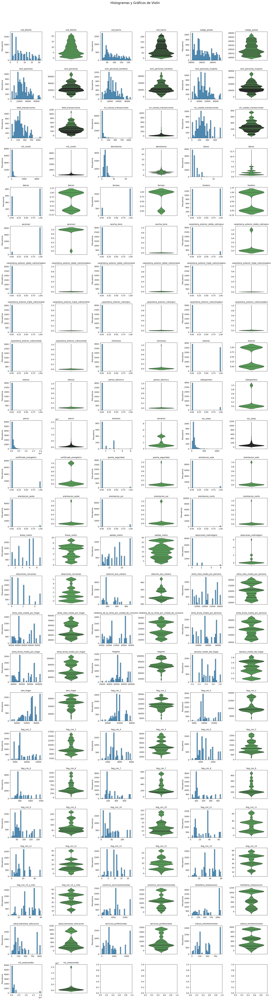

In [2815]:
# Gráfico con histogramas y violín

# Parámetros
var_porfila = 3  # Número de variables por fila
graf_porvariable = 2  # Histograma y violín
tot_var = len(cols_num)

# Calcular el número de filas y columnas
n_cols = var_porfila * graf_porvariable  # Total de columnas por fila
n_rows = math.ceil(tot_var / var_porfila)  # Número de filas necesarias

# Crear subplots dinámicamente
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 3 * n_rows))
fig.suptitle('Histogramas y Gráficos de Violín', fontsize=16)

if n_rows == 1:
    axes = axes.reshape(1, -1)  # Convierte a 2D si hay solo una fila

# Añadir gráficos
for i, col in enumerate(cols_num):
    row = i // var_porfila  # Fila correspondiente
    col_hist = (i % var_porfila) * graf_porvariable  # Columna del histograma
    col_violin = col_hist + 1  # Columna del gráfico de violín

    # Histograma
    sns.histplot(dfEDA[col].dropna(), bins=30, ax=axes[row, col_hist])
    axes[row, col_hist].set_title(f'{col}', fontsize=10)
    axes[row, col_hist].set_xlabel("")
    axes[row, col_hist].set_ylabel("Frecuencia")

    # Gráfico de violín

    sns.violinplot(y=dfEDA[col].dropna(), ax=axes[row, col_violin], inner="stick", color='green', alpha=0.7)

    axes[row, col_violin].set_title(f'{col}', fontsize=10)
    axes[row, col_violin].set_ylabel("")
    axes[row, col_violin].set_xlabel("")

# Ajustar el diseño
plt.tight_layout(rect=[0, 0, 1, 0.96])


Observaciones:
- A primera vista vemos que tenemos dos tipos de variables númericas, discretas y continuas. Además muchas de las variables discretas son binarias.
Variables continuas: precio,m2_constr,etc
Variables binarias: variables de orientacion, carpinteria,exterior,...
Variables discretas no binarias:dormitorios , banos,..

- En los histogramas (azules) que muestran cómo se distribuyen los valores de cada variable , se  pueden identificar distribuciones sesgadas en algunas variables continuas, con datos concentrados en ciertos rangos. Por ejemplo tanto  `precio` como  `m2_constr`y viv_nuevas_transaciones tienen distribuciones sesgadas a la derecho con acumulacion de valores bajos .
- En el caso de las variables binarias tienen solo dos valores posibles (0 o 1), indicando la presencia o ausencia de una característica en el inmueble como es el caso de `balcon`, `terraza`, `trastero`, `ascensor`, `nuda_propiedad`, `acceso_discapacidad`.
 Los gráficos de violín (verdes) y los histogramas nos muestran cuáles de estas variables tienen una distribución altamente desbalanceada (p.e interior ó tiene_armario)
- Sobre las variables con un solo valor pueden eliminarse del análisis o reemplazar los valores nulos por 0 si se asume que la ausencia del dato significa que la característica no está presente, como por ejemplo  `cancha_tenis`, `tiene_piscina`.
- Algunas variables como `num_plantas`, `num_personas`, `total_transacciones`, `lineas_metro`, `hogares`, `servicios_profesionales`, tienen una distribución amplia, lo que sugiere una gran variabilidad en los datos.

### *7.1.2 Variables categóricas*
Para las variables categóricas, vamos a utilizar gráficos de barras para realizar el analisis ya que ayudan a visualizar la frecuencia de cada categoría.

In [2816]:
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 9
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'codigo_postal', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones']
------------------------------------------------------
Número de columnas de tipo float: 64
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacio

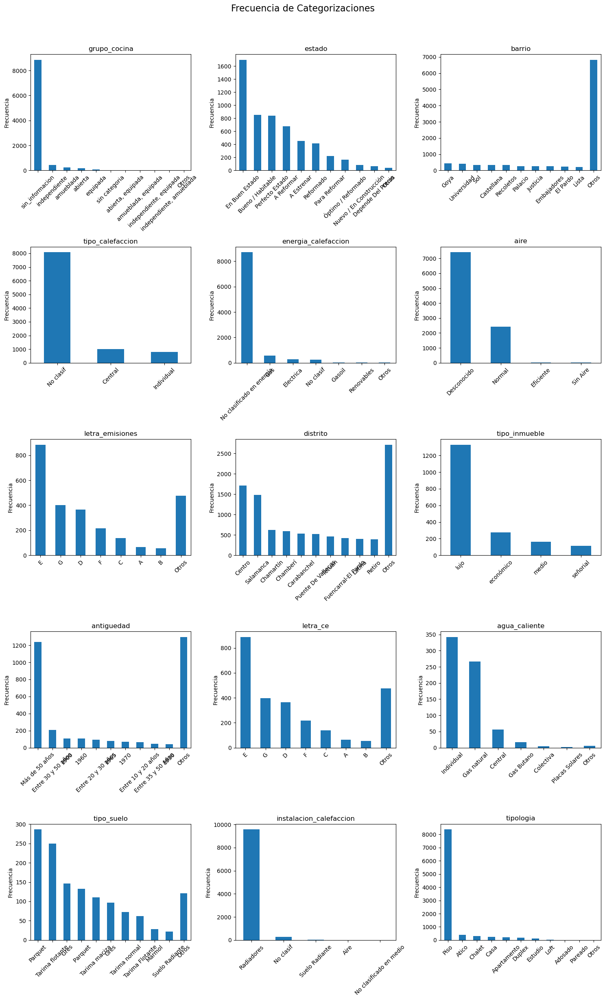

In [2817]:
# Definir el número de gráficos por fila
num_por_fila = 3
listacol = cols_cat
# Calcular el número de filas necesarias
num_filas = (len(listacol) + num_por_fila - 1) // num_por_fila  # Redondea hacia arriba para cubrir todos los gráficos

# Crear la figura con subplots
fig, axes = plt.subplots(nrows=num_filas, ncols = num_por_fila, figsize=(15, 5 * num_filas))
fig.suptitle("Frecuencia de Categorizaciones", fontsize=16)

# Asegurarse de que `axes` es 2D
# axes = axes.reshape(num_filas, num_por_fila)
# Bucle para crear los gráficos en cada fila
for i, col in enumerate(listacol):
    # Obtener la fila y columna correspondiente
    row = i // num_por_fila
    col_idx = i % num_por_fila

    # Crear el gráfico de barras
    top_10 = graficobarrascategoricas(dfEDA, col)

    # Dibujar el gráfico de barras
    top_10.plot(kind='bar', ax=axes[row, col_idx])

    # Configurar los títulos y etiquetas
    axes[row, col_idx].set_title(f'{col}', fontsize=12)
    axes[row, col_idx].set_xlabel("")
    axes[row, col_idx].set_ylabel("Frecuencia")

    # Rotar las etiquetas del eje X
    axes[row, col_idx].tick_params(axis='x', rotation=45)

    # Ajustar el diseño
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el diseño para que no se superpongan

Observaciones: En varias variables, hay una categoría dominante.
- `tipo_fachada`: Tiene una variedad de materiales, pero "Ladrillo" es el más común, lo que puede reflejar tendencias constructivas predominantes en la región.
- `tipo_calefaccion`: La mayoría de los inmuebles no tienen calefacción o no se ha especificado.
- `tipologia`: Nos indica que existen mucho más ofertas de "pisos" que de otra tipología de vivienda.
- `tipo_inmueble`: La categoría "lujo" tiene una mayor representación en comparación con otras categorías como "económico" o "medio". Hay que verificar si es por presencia de nulos en las observaciones de la mayoría de los inmuebles.
- `estado`: Presenta una mayor cantidad de registros en "En buen estado" y "Buena/muy buena calidad", indicando que la mayoría de los inmuebles ofertados están en condiciones óptimas.
- `letra_ce`: Muestra que muchos inmuebles tienen clasificaciones energéticas bajas (E, G, D), lo que puede ser un factor importante para compradores interesados en eficiencia.
- Existen categorias con muchos valores diferentes que se pueden agrupar para realizar el analisis, p.e. antiguedad ó estado.

## *7.2 Análisis bivariado*
El análisis bivariado nos permite estudiar la relación entre dos variables, ya sean numéricas o categóricas.

### *7.2.1 Variables numéricas*


#### *7.2.1.1 Pairplots*
Utilizaremos *Pairplots* para ver la relación entre nuestra target `precio` y algunas de las variables numéricas más relevantes identificadas después de la exploración del análisis univariado.

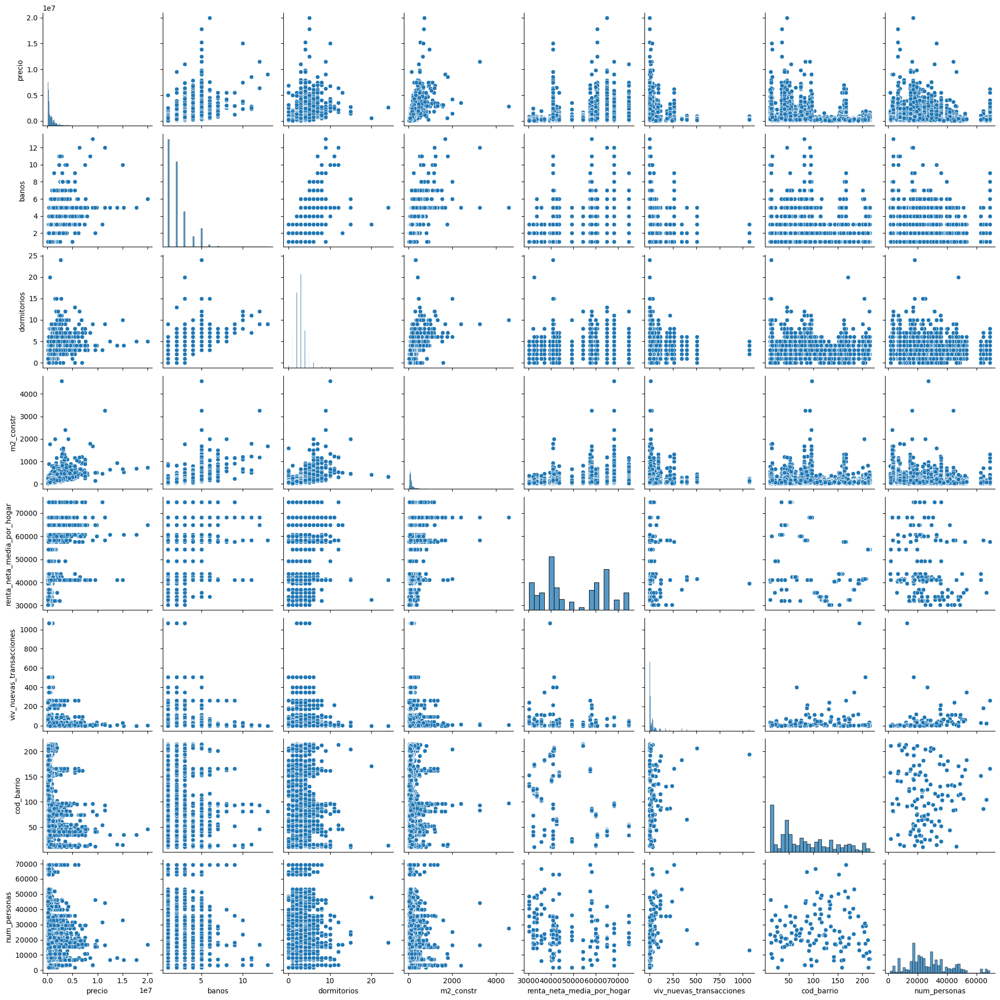

In [2818]:
cols = ['precio', 'banos', 'dormitorios', 'm2_constr', 'renta_neta_media_por_hogar', 'viv_nuevas_transacciones', 'cod_barrio','num_personas']
sns.pairplot(dfEDA[cols])

In [2819]:
dfEDA.query("banos==9")

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,letra_ce,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,antiguedad,jardin,tipo_inmueble,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,exterior,interior,piscina,porton_electrico,videoportero,precio,web,armarios,codigo_postal,m2_utiles,tipo_suelo,certificado_energetico,puerta_seguridad,gastos_comunidad,agua_caliente,orientacion_este,orientacion_oeste,orientacion_sur,aire,grupo_cocina,orientacion_norte,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion,num_personas,num_personas_hombres,num_personas_mujeres,total_transacciones,viv_nuevas_transacciones,viv_usadas_transacciones,lineas_metro,salidas_metro,estaciones_metroligero,estaciones_cercanias,estacion_bus_urbano,renta_neta_media_por_persona,renta_neta_media_por_hogar,mediana_de_la_renta_por_unidad_de_consumo,renta_bruta_media_por_persona,renta_bruta_media_por_hogar,hogares,tamano_medio_del_hogar,tam_hogar,hog_con_1,hog_con_2,hog_con_3,hog_con_4,hog_con_5,hog_con_6,hog_con_7,hog_con_8,hog_con_9,hog_con_10,hog_con_11,hog_con_12,hog_con_13,hog_con_14,hog_con_15_y_más,comercio_serviciosminoristas,hosteleria_restauracion,salud_bienestar_educacion,servicios_profesionales,cultura_entretenimiento,m2_areasverdes
3299,https://www.pisos.com/comprar/chalet-chamartin_prosperidad28043-31682869252_102100/,1150.00,Chamartín,5,Prosperidad,52,NaN,Chalet,NaN,NaN,NaN,8.00,9.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5500000.00,pisos.com,NaN,28002,NaN,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores,36027,16072,19955,383,43,340,7.00,20.00,0.00,1.00,275.00,30506.00,74842.00,34650.00,42678.00,104706.00,59133.00,2.45,20435.00,16135.00,9450.00,7148.00,3507.00,1406.00,536.00,234.00,113.00,56.00,32.00,13.00,14.00,9.00,45.00,45.00,693.00,274.00,228.00,505.00,220.00,214209.00
3310,https://www.pisos.com/comprar/chalet-piovera28043-42584894465_101800/,1150.00,Hortaleza,16,Piovera,166,C,Chalet,En Buen Estado,1.0,NaN,7.00,9.00,NaN,1.00,1.0,1.00,NaN,Entre 10 y 20 años,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,propia,NaN,NaN,5500000.00,pisos.com,1.00,28033,NaN,NaN,1.00,NaN,NaN,NaN,1.00,0.00,0.00,Normal,sin_informacion,0.00,C,No clasif,Gas,Radiadores,69176,33831,35345,674,262,412,2.00,9.00,6.00,1.00,325.00,21766.00,57506.00,26950.00,29047.00,76741.00,74740.00,2.65,19312.00,20136.00,14860.00,13430.00,4488.00,1448.00,565.00,235.00,110.00,61.00,38.00,13.00,8.00,4.00,32.00,32.00,1114.00,603.00,596.00,1135.00,486.00,1758173.00
4591,https://www.pisos.com/comprar/piso-ciudad_universitaria28035-39187802387_101800/,901.00,Moncloa-Aravaca,9,Ciudad Universitaria,93,NaN,Piso,NaN,NaN,NaN,7.00,9.00,NaN,1.00,NaN,NaN,NaN,Entre 10 y 20 años,privado,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,propia,NaN,NaN,2900000.00,pisos.com,1.00,28040,NaN,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,1.00,NaN,Central,No clasificado en energía,Radiadores,16364,7603,8761,109,8,101,6.00,14.00,1.00,3.00,351.00,26694.00,68238.00,30450.00,36592.00,93541.00,47279.00,2.58,14738.00,12794.00,8103.00,6623.00,2892.00,1159.00,489.00,212.00,109.00,44.00,26.00,18.00,11.00,2.00,59.00,59.00,532.00,200.00,235.00,347.00,207.00,19901426.00
6402,https://www.pisos.com/comprar/piso-justicia_chueca28004-44221121007_992392/,225.00,Centro,1,Justicia,14,NaN,Piso,A Reformar,NaN,4,9.00,9.00,1.00,NaN,NaN,1.00,1.00,Más de 50 años,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.00,NaN,NaN,NaN,NaN,1290000.00,pisos.com,4.00,28004,205.00,Parquet,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,NaN,No cl

Observaciones:
- `precio` vs. `m2_constr`: Hay una correlación positiva, a medida que aumenta el tamaño construido (metros cuadrados), el precio tiende a incrementarse. La dispersión muestra una nube de puntos con una tendencia ascendente.
- `precio` vs. `dormitorios`: Al igual que en las variables de metros construidos, el precio aparenta tener una tendencia ascendente.Aunque se ven algunos valores atipicos que tendremos que analizar.
- `precio` vs. `cod_barrio`: La relación entre precio y código de barrio es menos clara. Es probable que el gráfico refleje precios variados dentro de cada barrio, y que el barrio afecte, pero de manera categórica. Será necesario analizar la comparación de medias por barrio.
- `precio` vs. `banos`: La mayoría de los datos están agrupados en la parte inferior izquierda del gráfico. Muchas viviendas tienen precios bajos y cuentan con un número reducido de baños.Es posible que haya una ligera correlación entre el número de baños y el precio de la vivienda. A medida que aumenta el número de baños ,aumente el precio de la vivienda.Hay un par de puntos alejados del grupo principal. Por ejemplo, un punto representa una vivienda con un precio muy alto pero con un número reducido de baños. Esto podría ser un error en los datos o una vivienda especial.
- `precio` vs.`viv_nuevas_transacciones`: Podemos ver una concentracion de transaciones d precios bajos en la esquina inferior izquierda.
-  `precio` vs. `renta neta media por hogar`. Muchos de los datos están concentrados en la esquina inferior izquierda del gráfico. Esto sugiere que la mayoría de las viviendas tienen precios bajos y están asociadas con hogares de renta media más baja. Aunque podemos ver algunos casos donde el precio de las viviendas o la renta media varía significativamente (posibles valores atípicos).

#### *7.2.1.2 Matriz de correlación y heatmap*
Utilizamos la matriz de correlación para  identificar relaciones entre variables numéricas.

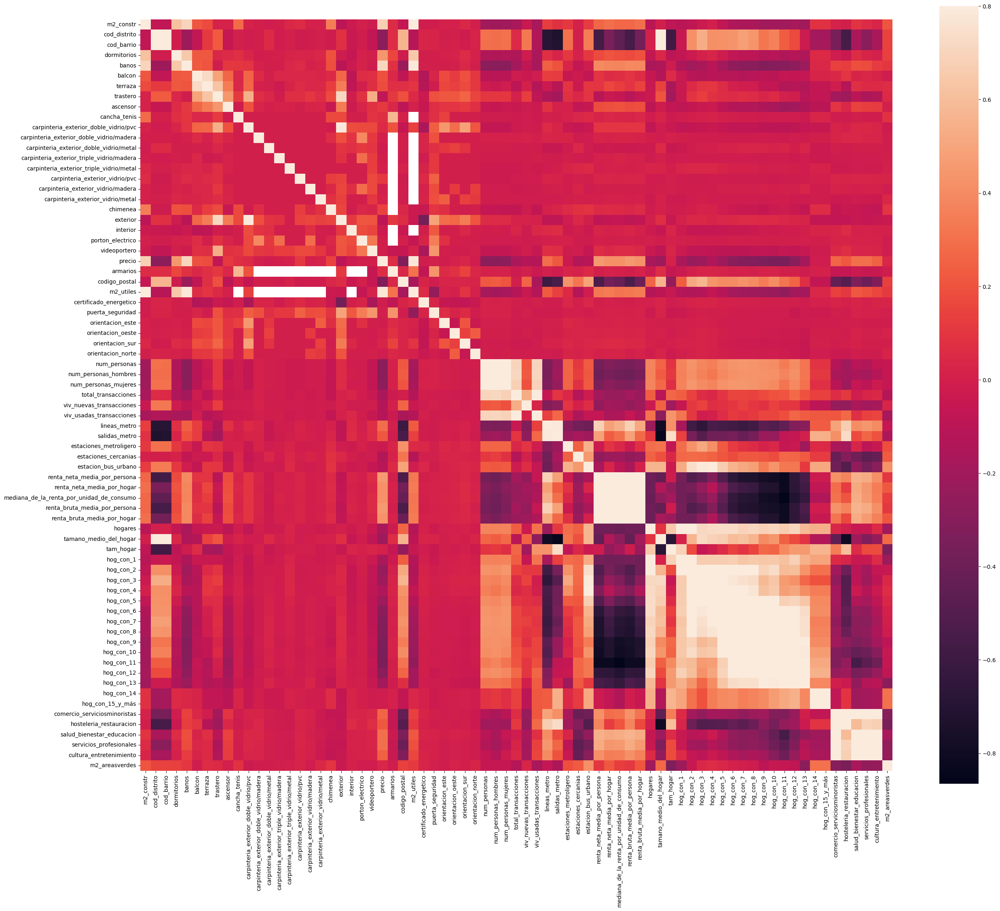

In [2820]:
dfcorr =dfEDA.corr(numeric_only=True).copy()
f, ax = plt.subplots(figsize=(30, 25))
sns.heatmap(dfcorr, vmax=0.8, square=True);

El mapa de calor nos sirve para conocer las variables y sus relaciones.
A primera vista vemos que alguna variable'inmuebles_ingresos ó cancha_tenis que son lineas completamente blancas , lo que parece indicar ausencia de datos.
Tambien se puede observar que hay algunas variables muy correladas entre ellas.
Vamos a estudiar de que varibles se trata.

In [2821]:
# Establecer un umbral para la correlación (80%)
threshold = 0.90

# Identificar pares de variables con correlación
correlations = []
already_seen = set()

for col in dfcorr.columns:
    for row in dfcorr.index:
        if abs(dfcorr.loc[row, col]) > threshold and col != row:
            pair = tuple(sorted((row, col)))  # Crear pares únicos
            if pair not in already_seen:
                correlations.append((row, col, dfcorr.loc[row, col]))
                already_seen.add(pair)  # Marcar par como ya visto

# Imprimir los resultados
print("Pares de variables con correlación mayor al 90%:")
for var1, var2, corr in correlations:
    print(f"{var1} y {var2}: {corr:.2f}")


Pares de variables con correlación mayor al 90%:
m2_utiles y m2_constr: 0.98
cod_barrio y cod_distrito: 0.99
num_personas_hombres y num_personas: 1.00
num_personas_mujeres y num_personas: 1.00
num_personas_mujeres y num_personas_hombres: 0.98
renta_neta_media_por_hogar y renta_neta_media_por_persona: 0.95
mediana_de_la_renta_por_unidad_de_consumo y renta_neta_media_por_persona: 0.97
renta_bruta_media_por_persona y renta_neta_media_por_persona: 1.00
renta_bruta_media_por_hogar y renta_neta_media_por_persona: 0.96
mediana_de_la_renta_por_unidad_de_consumo y renta_neta_media_por_hogar: 0.98
renta_bruta_media_por_persona y renta_neta_media_por_hogar: 0.95
renta_bruta_media_por_hogar y renta_neta_media_por_hogar: 1.00
renta_bruta_media_por_persona y mediana_de_la_renta_por_unidad_de_consumo: 0.97
renta_bruta_media_por_hogar y mediana_de_la_renta_por_unidad_de_consumo: 0.98
renta_bruta_media_por_hogar y renta_bruta_media_por_persona: 0.96
hog_con_1 y hogares: 0.99
hog_con_3 y hog_con_2: 0.96

Podemos observar que tenemos muchas variables con una correlación significativa, es tan fuerte que podría indicar multicolinealidad, es decir, que básicamente ofrecen la misma información.

Mostramos la correlación de la variable 'target' con las demás variables numéricas

In [2822]:
dfcorr[['precio']].sort_values(by = 'precio',ascending = False).style.background_gradient()

,precio
precio,1.000000
m2_utiles,0.778173
banos,0.707543
m2_constr,0.674621
renta_bruta_media_por_persona,0.450327
renta_neta_media_por_persona,0.449267
dormitorios,0.443961
renta_bruta_media_por_hogar,0.426238
mediana_de_la_renta_por_unidad_de_consumo,0.422643
renta_neta_media_por_hogar,0.418733


Observaciones:
- Se puede apreciar una fuerte correlación entre la variable *target* `precio` con: `m2_utiles`, `m2_constr`, y `banos`.
- Existe una correlación más baja pero igualmente importante con: `cod_distrito`,`dormitorios`, `renta neta media por persona`, `renta_bruta_media_por_hogar`, `mediana de la renta por unidad de consumo`, `renta bruta media por persona`, `renta bruta media por hogar`, `salud_bienestar_educacion`, `servicios_profesionales`, y `lineas_metro`.
- Hay una correlación más baja con: `Nuda propiedad`, `codigo_postal`, `hog_con_7`, `hog_con_8`, `hog_con_9`, y `hog_con_10`, `hog_con_11`.

#### *7.2.1.3 Histogramas y distribución de variables numéricas* 
Seleccionamos un subconjunto de variables numéricas para hacer el estudio ya que identificamos que tienen alta correlación con la variable target 'precio'.

In [2823]:
dfEDA.columns

Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'garaje', 'trastero', 'ascensor',
       'antiguedad', 'jardin', 'tipo_inmueble', 'cancha_tenis',
       'carpinteria_exterior_doble_vidrio/pvc',
       'carpinteria_exterior_doble_vidrio/madera',
       'carpinteria_exterior_doble_vidrio/metal',
       'carpinteria_exterior_triple_vidrio/madera',
       'carpinteria_exterior_triple_vidrio/metal',
       'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera',
       'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior',
       'piscina', 'porton_electrico', 'videoportero', 'precio', 'web',
       'armarios', 'codigo_postal', 'm2_utiles', 'tipo_suelo',
       'certificado_energetico', 'puerta_seguridad', 'gastos_comunidad',
       'agua_caliente', 'orientacion_este', 'orientacion_oeste',
       'orientacion_su

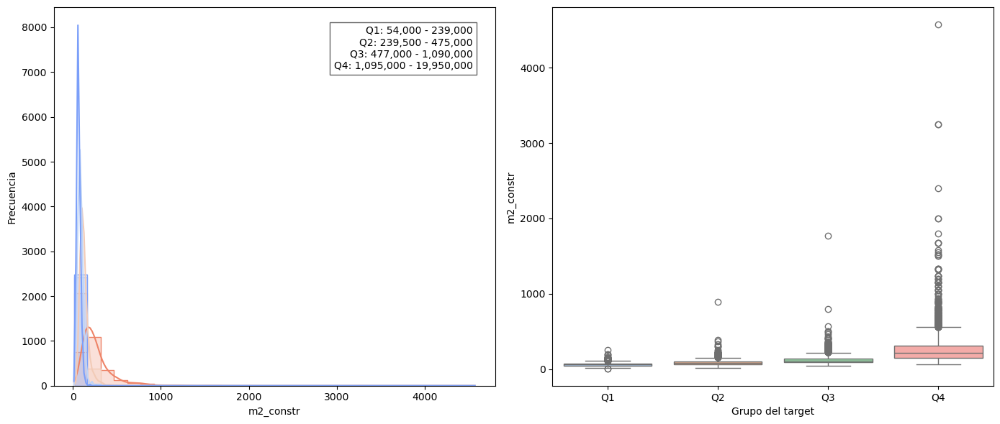

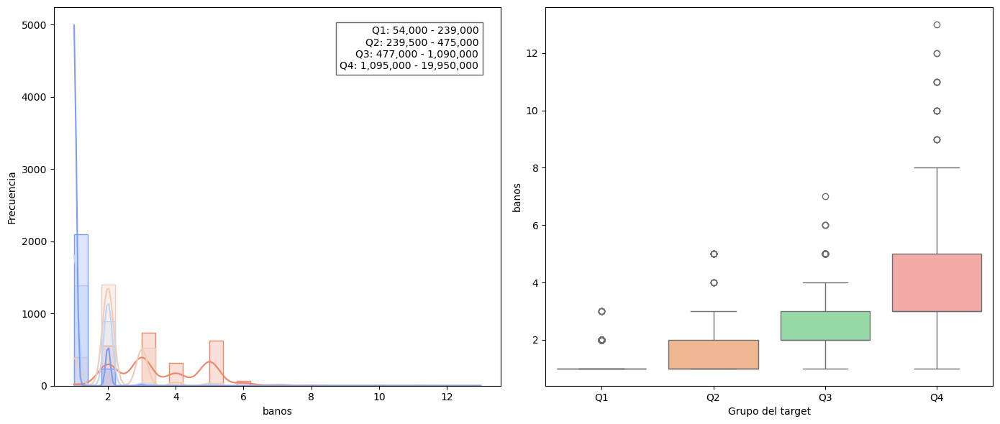

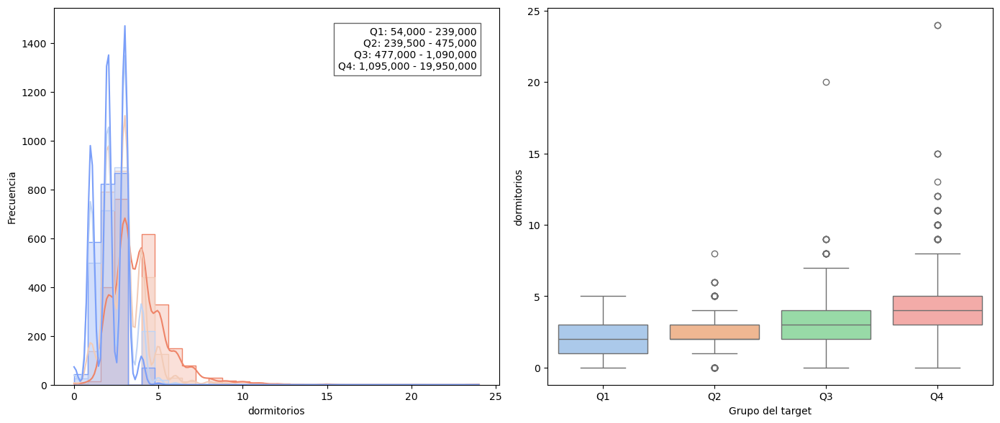

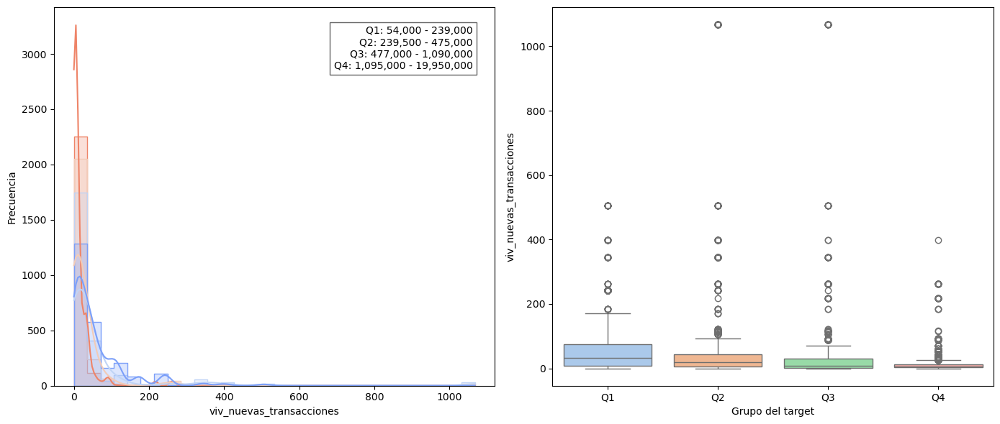

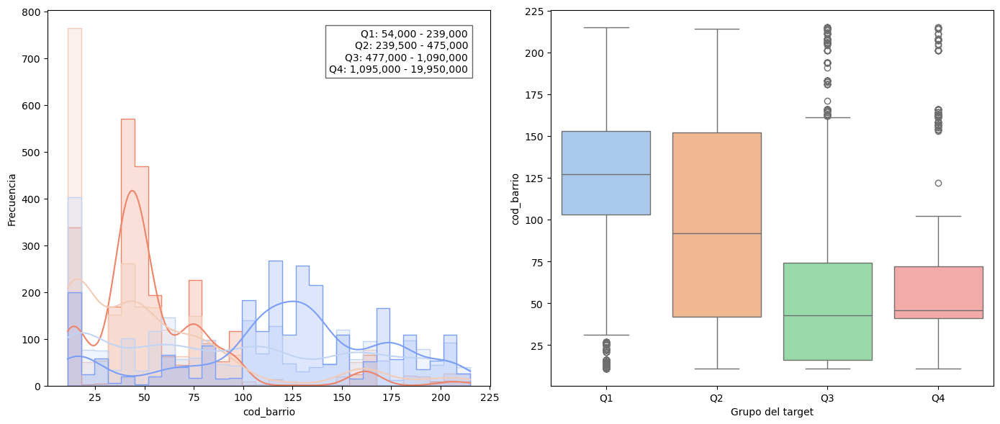

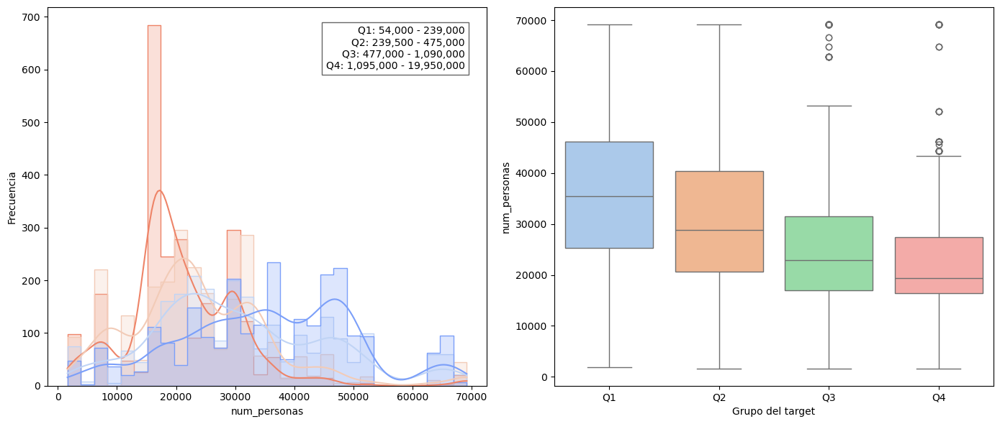

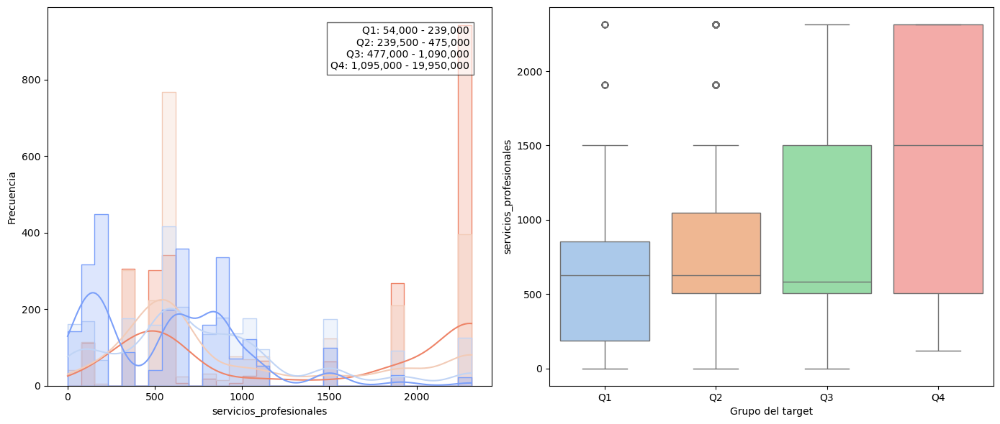

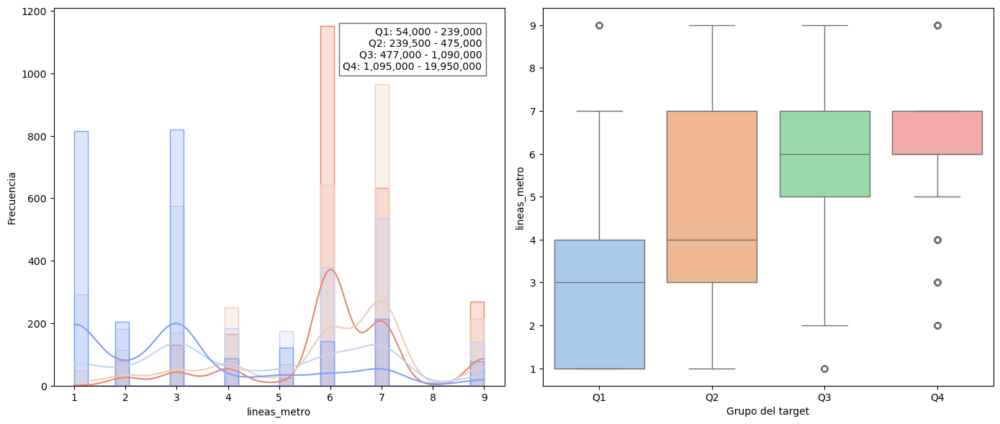

In [2824]:
# Definir columnas numéricas a analizar
cols_var_num = [
     'm2_constr', 'banos', 'dormitorios', 'viv_nuevas_transacciones',  'cod_barrio', 
      'num_personas','servicios_profesionales', 'lineas_metro'
]

# Ordenar el dataset solo una vez si es necesario
dfEDA_sorted = dfEDA.sort_values('precio')

# Generar los gráficos con la transformación logarítmica en precio
for col in cols_var_num:
   plot_histogram_boxplot(df=dfEDA_sorted, input_name=col, target_name='precio')

Observaciones:
- En los histogramas, las variables m2_constr,dormitorios,baños, presentan una distribución sesgada a la derecha. Esto significa que la mayoría de los valores están concentrados en el rango bajo, mientras que hay algunas propiedades con valores extremadamente altos.
- En los boxplots, los valores extremos o *outliers* son muy evidentes, especialmente en variables como `m2_constr` .
- Existe una relación clara entre los metros cuadrados y el precio, donde a mayor tamaño del inmueble, mayor suele ser el precio. Sin embargo, la dispersión es alta, lo que indica que no siempre un inmueble más grande es más caro, probablemente debido a la ubicación o características adicionales. Los boxplots muestran una gran cantidad de valores atípicos, lo que sugiere que existen propiedades que, aún con tamaños pequeños, tienen precios extremadamente altos. Esto podría deberse a factores como la ubicación premium o características de lujo.
- Se observa una tendencia donde los inmuebles con más dormitorios y baños tienen un precio más alto. Sin embargo, el boxplot muestra que hay valores extremos, donde algunas viviendas con pocos dormitorios y baños tienen precios elevados, lo que podría ser indicativo de la ubicación de estas viviendas.
- Se evidencian diferencias significativas en los precios dependiendo del distrito o barrio. Los distritos más exclusivos tienen un precio significativamente más alto, mientras que en otras zonas el precio es más accesible. El boxplot muestra una gran dispersión en algunos distritos, lo que sugiere una combinación de propiedades de alto y bajo costo dentro del mismo distrito.
- Existe una correlación positiva entre la renta media del hogar y el precio del inmueble: las zonas con mayores ingresos tienden a tener propiedades más caras. El boxplot muestra una variabilidad considerable, lo que sugiere que aunque la renta media sea alta, hay excepciones con propiedades accesibles dentro de esas áreas.
- En cuanto al numero de personas podemos observar que haymas personas en los distritos con las viviedas mas baratas.
- No parece haber una relación lineal clara entre el número de líneas de metro cercanas y el precio del inmueble. En el boxplot, se observa una dispersión importante, lo que indica que la cercanía a múltiples líneas de metro no es un factor determinante del precio por sí solo, pero podría influir dependiendo de la zona.

### *7.2.2 Variables categóricas*
Analizamos la relación de la variable target `precio` con las variables categóricas.

Generamos barplots con la media y mediana de la variable a analizar (precio)  frente a varias categóricas.

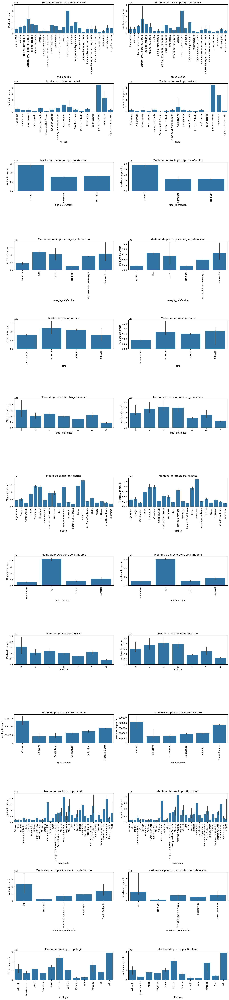

In [2825]:
# de las variables categoricas quitamos barrio y antiguedad  y lo analizamos despues en un grafico a parte para mejorar la visualización

# Filtrar las variables categóricas excepto "barrio" y "antiguedad"que tienen muchas categorias y el grafico no se ve con claridad.
cols_a = [col for col in cols_cat if col not in ["barrio", "antiguedad"]]

# Generar gráficos de barras de media y mediana del precio
generar_barplot_media_mediana(dfEDA, cols_a, 'precio')




Observaciones:
- Se observan diferencias significativas en el precio promedio en función de distintas variables categóricas. 
- Se identifican algunas categorías en variables como `tipo_inmueble`, `distrito`, `barrio`, `estado` y `tipologia` que presentan precios significativamente más altos o bajos.
- En las variables `distrito`, se evidencian diferencias claras en el precio medio entre distintas zonas, lo que indica que la ubicación es un factor determinante en el valor de los inmuebles.
- En algunos gráficos, los intervalos de confianza son amplios, lo que indica que existe una gran dispersión en los precios dentro de ciertas categorías. Algunas variables como `energía_calefaccion`, `letra_ce` o `tipo_suelo` parecen tener un impacto menos significativo en el precio, ya que las diferencias entre categorías son menores.

Conclusión:
- Identificar las variables categóricas más influyentes: Variables como `tipo_inmueble`, `distrito`, `barrio`, `estado` y `tipologia` deben ser consideradas en cualquier análisis predictivo, ya que tienen un alto impacto en el precio.
- Reducir la cantidad de categorías poco representadas: Algunas categorías tienen muy pocos registros y podrían agruparse en una categoría más general para mejorar la interpretación de los datos.
- Analizar la interacción entre variables: Analizaremos si ciertas combinaciones de categorías influyen aún más en el precio, por ejemplo, la tipologia de un inmueble dentro de un distrito específico.
- Considerar la eliminación o transformación de variables menos relevantes: Si algunas variables categóricas no tienen una variación significativa en los precios, podrían descartarse en análisis posteriores.

### *7.2.3 Combinación de variables categoricas vs precio*


##### Distrito y m2_contr vs precio

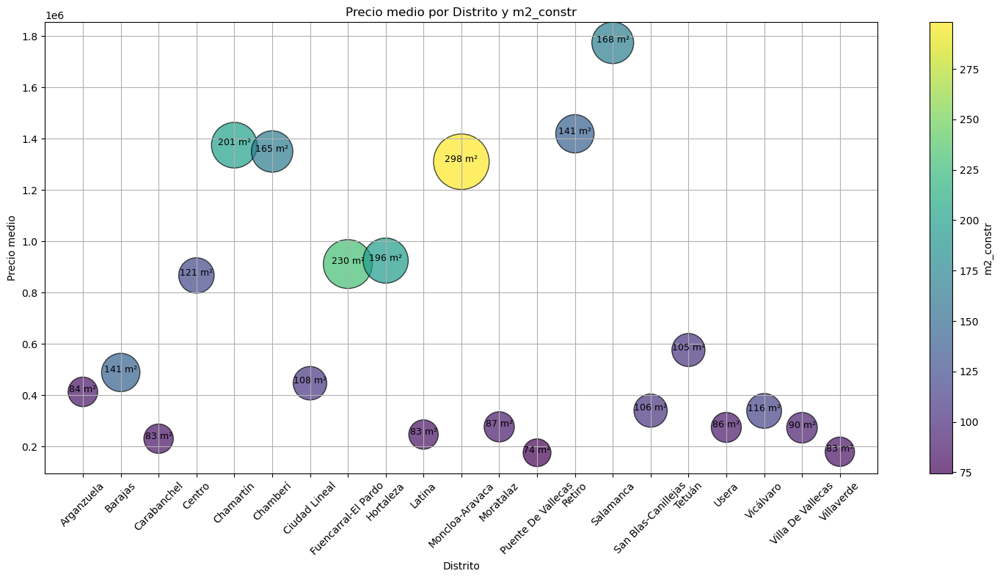

In [2826]:

# Agrupación de datos
stats = dfEDA.groupby('distrito').agg({'precio': 'mean', 'm2_constr': 'mean'}).reset_index()

# Crear gráfico de burbujas con colores diferenciados
plt.figure(figsize=(15, 8))

# Usar una escala de colores para `m2_constr`
scatter = plt.scatter(
    stats['distrito'], stats['precio'],
    s=stats['m2_constr'] * 10,  # Tamaño según `m2_constr`
    c=stats['m2_constr'],       # Color según `m2_constr`
    cmap='viridis',             # Paleta de colores
    alpha=0.7, edgecolors='black'
)

plt.colorbar(scatter, label='m2_constr')  # Barra de color para referencia
plt.xticks(rotation=45)
plt.title('Precio medio por Distrito y m2_constr')
plt.xlabel('Distrito')
plt.ylabel('Precio medio')
plt.grid(True)

# Añadir etiquetas de m2 en cada burbuja
for i in range(len(stats)):
    plt.text(stats['distrito'][i], stats['precio'][i], f"{int(stats['m2_constr'][i])} m²", fontsize=9, ha='center')

plt.tight_layout()
plt.show()


Se observa que las viviendas tienden a ser más amplias dependiendo del distrito, y también presentan precios más elevados. Sin embargo, el distrito con el precio medio más alto es Salamanca, pero este no coincide con las viviendas de mayor tamaño en términos de metros cuadrados construidos. Esto indica que en Salamanca, el alto precio podría estar más relacionado con factores como la ubicación, o demanda, más que con el tamaño de las viviendas.

##### Dormitorios+baños con respecto distrito y el precio

Para analizar la relación entre el número de dormitorios y baños, su ubicación y el precio, vamos a generar una gráfica de calor que muestra el precio promedio de las viviendas (en miles de euros) en función de la suma de dormitorios y baños (eje X) y la ubicación (eje Y, que representa los diferentes distritos). 
El color azul representa precios más bajos y el rojo precios más altos.


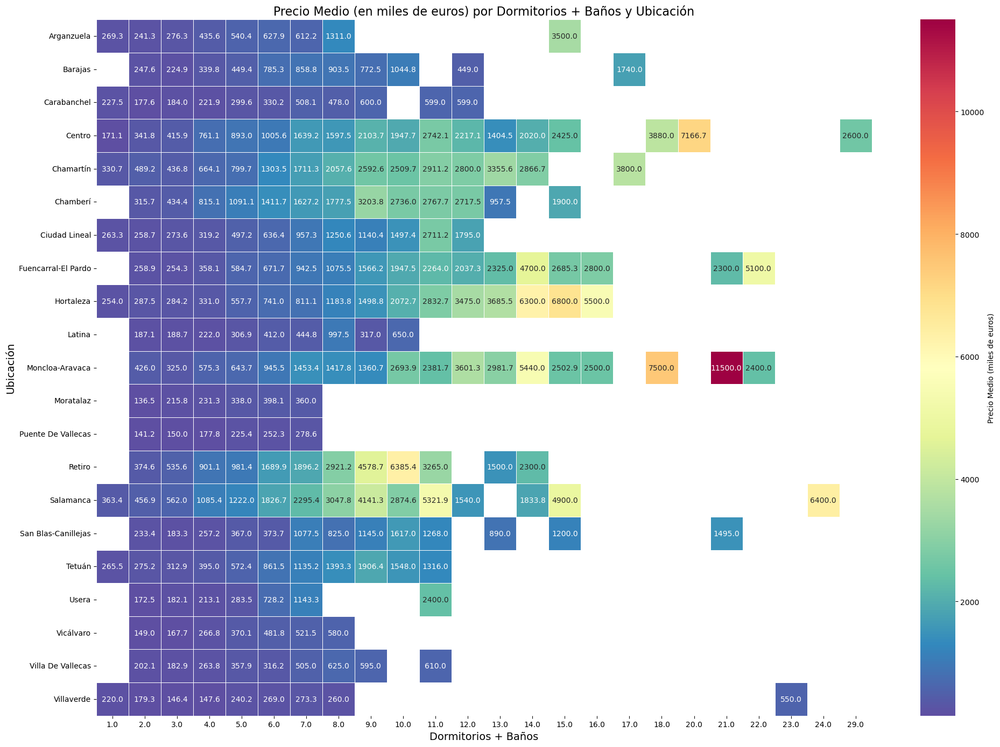

In [2827]:
# Agrupar por distrito y dormitorios + baños, convertir precio a miles de euros
dfEDA["dormitorios_banos"] = dfEDA["dormitorios"] + dfEDA["banos"]
heatmap_data = (dfEDA.groupby(['distrito', 'dormitorios_banos'])['precio'].mean() / 1000).unstack()

# Crear el heatmap con la paleta invertida
plt.figure(figsize=(20, 14))
sns.heatmap(heatmap_data, 
            cmap='Spectral_r',  # Invertir la paleta de colores (r para reverse)
            annot=True,         # Mostrar valores numéricos
            fmt=".1f",          # Formato de los números
            linewidths=0.5,     # Separación entre celdas
            cbar_kws={'label': 'Precio Medio (miles de euros)'})  # Etiqueta para la barra de color

# Personalización del gráfico
plt.title('Precio Medio (en miles de euros) por Dormitorios + Baños y Ubicación', fontsize=16)
plt.xlabel('Dormitorios + Baños', fontsize=14)
plt.ylabel('Ubicación', fontsize=14)
plt.tight_layout()

# Mostrar el gráfico
plt.show()


A medida que aumenta la cantidad de dormitorios y baños, los precios tienden a ser más elevados.Sin embargo, este  patrón no es uniforme en todos los distritos, lo que indica que otros factores como la ubicación específica tienen un impacto significativo.
Algunos distritos presentan precios elevados incluso para viviendas más pequeñas, lo que sugiere que la ubicación puede ser el principal determinante del precio en esos casos (por ejemplo, distritos exclusivos como Salamanca).

En otros distritos, los precios parecen estar más relacionados con el tamaño de la vivienda.
Los distritos más asequibles tienen predominio de colores azulados incluso para viviendas más grandes.
Análisis de valores atípicos:

Puede haber distritos donde viviendas más grandes no correspondan proporcionalmente a precios más altos, lo cual podría indicar factores externos como demanda, nivel socioeconómico o antigüedad de las propiedades

In [2828]:
#Elimino la variable creada para la visualizacion
dfEDA=dfEDA.drop(columns="dormitorios_banos")

# *8. Generación de un fichero para el desarrollo de un modelo inicial baseline*



Vamos a generar un primer modelo baseline con los datos en bruto.

In [2829]:
dfEDA.shape

(9868, 96)

In [2830]:
# Exportar CSV de control para generación de un primer modelo baseline
dfEDA.to_csv("dfbaseline_sin_process.csv",index=False)

# *9. Limpieza y procesamiento de datos*
Dependiendo de la cantidad de valores nulos y duplicados detectados, se pueden tomar las siguientes acciones:
- Eliminar registros duplicados si no aportan valor al análisis.
- Gestionar valores faltantes:
    Aquellos valores nulos que se imputarán a un valor fijo ("Desconcido" en categoricas, 0 en númericas) se realizaran en este capitulo.
    La imputación de nulos que conlleve la utilización de estadisticos, ya sea la moda,la mediana o la media del conjunto de datos, se realizará la imputación después de dividir entre train,validacion y test. Esto garantizará que la información de los tres conjuntos de datos permanezca independiente.
    Si lo realizaramos antes el modelo de entrenamiento podría beneficiarse de información del conjunto de validación o test, generando resultados optimistas y poco realistas.Además garantiza que las métricas obtenidas en validación y test sean fiables y representen el rendimiento del modelo en datos desconocidos.


## *9.1 Variables categóricas: agrupación e imputación de nulos*


 
- *Algunas variables categóricas previamente definidas se convertirán en numéricas tras su agrupación, con el objetivo de utilizarlas en el modelo.** Ejemplos de estas variables incluyen `estado` y `letra_ce`.  
- *Las variables categóricas que se conserven como tales al finalizar este capítulo tendrán sus valores nulos imputados con "Desconocido".*



In [2831]:
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 9
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'codigo_postal', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones']
------------------------------------------------------
Número de columnas de tipo float: 64
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacio

Veamos el porcentaje de nulos de cada varaible

In [2832]:
# Iterar sobre las columnas categóricas y mostrar solo las que tienen valores nulos > 0%
for col in cols_cat:
    porcentaje_nulos = (dfEDA[col].isna().sum() / len(dfEDA)) * 100
    if porcentaje_nulos > 0:
        print(f"Porcentaje de valores nulos en la columna '{col}': {porcentaje_nulos:.2f}%")


Porcentaje de valores nulos en la columna 'estado': 44.19%
Porcentaje de valores nulos en la columna 'letra_emisiones': 78.48%
Porcentaje de valores nulos en la columna 'tipo_inmueble': 80.92%
Porcentaje de valores nulos en la columna 'antiguedad': 66.03%
Porcentaje de valores nulos en la columna 'letra_ce': 78.48%
Porcentaje de valores nulos en la columna 'agua_caliente': 93.03%
Porcentaje de valores nulos en la columna 'tipo_suelo': 86.54%


Revisamos los valores que toma cada variable

### *9.1.1 Distrito y Barrio*

La columnas distrito y barrio no tiene valores nulos

In [2833]:
dfEDA['distrito'].value_counts(dropna=False)

distrito
Centro                 1714
Salamanca              1485
Chamartín               625
Chamberí                596
Carabanchel             532
Puente De Vallecas      520
Tetuán                  459
Fuencarral-El Pardo     422
Latina                  403
Retiro                  395
Ciudad Lineal           392
Moncloa-Aravaca         373
San Blas-Canillejas     344
Arganzuela              290
Hortaleza               289
Villaverde              288
Villa De Vallecas       229
Usera                   194
Vicálvaro               116
Moratalaz               103
Barajas                  99
Name: count, dtype: int64

In [2834]:
dfEDA['barrio'].value_counts(dropna=False)

barrio
Goya           432
Universidad    411
Sol            339
Castellana     325
Recoletos      325
              ... 
La Paz           8
Aeropuerto       7
Valderrivas      3
Horcajo          1
El Goloso        1
Name: count, Length: 131, dtype: int64

Observaciones:
- No se necesita hacer agrupación.
- No se necesita imputar nulos.

### *9.1.2 Estado*

In [2835]:
dfEDA['estado'].value_counts(dropna=False)

estado
NaN                        4361
En Buen Estado             1697
Bueno / Habitable           853
Perfecto Estado             839
A Reformar                  678
A Estrenar                  450
Reformado                   413
Para Reformar               219
Óptimo / Reformado          168
Nuevo / En Construcción      85
Depende Del Precio           64
Obra Nueva                   17
reformado                    11
Obra nueva                    7
Buen Estado                   3
Buen estado                   1
buen estado                   1
perfecto estado               1
Name: count, dtype: int64

Creamos un diccionario de mapeo para agrupar las categorías y posteriormente convertirlas a numéricas:
NaN: 0, Para reformar: 1, Buen estado: 2, Perfecto estado: 3, Reformado: 4, Obra nueva: 5

In [2836]:
estado_map = {
    "en buen estado": 2,
    "buen estado": 2,
    "bueno / habitable": 2,
    "perfecto estado": 3,
    "a estrenar": 5,
    "reformado": 4,
    "a reformar": 1,
    "para reformar": 1,
    "estado a reformar": 1,
    "óptimo / reformado": 4,
    "nuevo / en construcción": 5,
    "depende del precio": 1,
    "estado obra nueva": 5,
    "obra nueva": 5
}

dfEDA["estado"] = dfEDA["estado"].str.lower() 
dfEDA['estado'] = dfEDA['estado'].replace(estado_map)
dfEDA['estado'].value_counts(dropna=False)
print(f"Porcentaje de valores nulos en la columna 'estado': {(dfEDA['estado'].isna().sum() / len(dfEDA) * 100):.2f}%")


Porcentaje de valores nulos en la columna 'estado': 44.19%


In [2837]:
# Imputamos 0 a los valores nulos
dfEDA["estado"] = dfEDA["estado"].fillna(0)
dfEDA["estado"].value_counts(dropna=False)

estado
0.00    4361
2.00    2555
1.00     961
3.00     840
4.00     592
5.00     559
Name: count, dtype: int64

In [2838]:
dfEDA["estado"]=dfEDA["estado"].astype(int)

Hemos creado un diccionario llamado estado_map para asignar un valor numérico a cada descripción del estado de una vivienda, agrupando términos similares bajo un mismo número, convirtiendo datos categóricos en valores númericos, para que los modelos de análisis pueden manejarlos fácilmente.
Los valores asignados siguen una escala jerárquica: desde 0 valores faltantes, 1 para viviendas en mal estado (por ejemplo, "a reformar"), hasta 5 para viviendas nuevas o en perfecto estado. Esta transformación simplifica el análisis y añade consistencia a la información del dataset. 

### *9.1.3 Antigüedad*

In [2839]:
dfEDA["antiguedad"].value_counts(dropna=False)

antiguedad
NaN                   6516
Más de 50 años        1239
Entre 30 y 50 años     206
1900                   106
1960                   106
                      ... 
 1951                    1
 1994                    1
 1990                    1
 1979                    1
 1923                    1
Name: count, Length: 165, dtype: int64

Se agrupa la columna en 5 categorias :'menos_5','5_10', '10_30','30_50' y 'mas_50'

In [2840]:

dfEDA["antiguedad"]=dfEDA["antiguedad"].str.strip()
dfEDA['antiguedad'] = dfEDA['antiguedad'].str.replace(r'^\s+|\s+$', '', regex=True)

# Aplicamos la función para agrupar el año en que fue construida la vivienda
dfEDA['antiguedad'] = dfEDA['antiguedad'].apply(categorize_ano_construccion)

# Aplicacamos la funcion agrupar_antiguedad para agrupar las disintas categorias de antigüedad
dfEDA['antiguedad'] = dfEDA['antiguedad'].apply(agrupar_antiguedad)


In [2841]:
# Verificamos los primeros registros para comprobar que la agrupación fue realizada correctamente
dfEDA['antiguedad'].value_counts(dropna=False)


antiguedad
NaN        6516
mas_50     2341
30_50       522
10_30       391
menos_5      72
5_10         26
Name: count, dtype: int64

In [2842]:
print(f"Porcentaje de valores nulos en la columna 'antiguedad': {(dfEDA['antiguedad'].isna().sum() / len(dfEDA) * 100):.2f}%")


Porcentaje de valores nulos en la columna 'antiguedad': 66.03%


In [2843]:
dfEDA['antiguedad'] = dfEDA['antiguedad'].astype('category')

Observaciones:
- Se imputarán los nulos con el valor 'Desconocido'.

### *9.1.4 Tipo de suelo* 

In [2844]:
dfEDA["tipo_suelo"].value_counts(dropna=False)

tipo_suelo
NaN                                  8540
Parquet                               286
Tarima flotante                       250
 Gres                                 146
 Parquet                              133
Tarima maciza                         110
Gres                                   97
 Tarima normal                         73
 Tarima Flotante                       62
Mármol                                 28
Suelo Radiante                         22
 Baldosa                               21
 Terrazo                               16
 Sintasol                              16
 Otros                                 14
Terrazo                                 7
 Porcelánico                            7
Parket                                  6
Tarima                                  5
Moqueta                                 4
Tarima normal                           3
Madera                                  3
 Mosaico Hidráulico                     3
Radiante-refrescante   

Se agrupa en las siguientes categorias :
         'Madera','Gres','Piedra','Radiante','Baldosa','Otros'
  

In [2845]:
# Asegurarse de que todos los valores sean cadenas, manejar valores NaN
dfEDA['tipo_suelo'] = dfEDA['tipo_suelo'].astype(str).str.lower().apply(unidecode).str.strip()
# Aplicar la función a la columna
dfEDA['tipo_suelo'] = dfEDA['tipo_suelo'].apply(categorizar_suelo)

Observaciones:
- Se imputarán los nulos con el valor 'Desconocido'.

### *9.1.5 Letra de consumo / Letra emisiones (certificado energético)*

In [2846]:
# Chequeo de valores columnas letra_ce
dfEDA["letra_ce"].value_counts(dropna=False)

letra_ce
NaN    7744
E       887
G       398
D       364
F       216
C       139
A        65
B        55
Name: count, dtype: int64

In [2847]:
# Chequeo de valores columnas letra_ce
dfEDA["letra_emisiones"].value_counts(dropna=False)

letra_emisiones
NaN    7744
E       885
G       400
D       364
F       216
C       139
A        65
B        55
Name: count, dtype: int64

Se realiza la siguiente codificación ordinal (ordinal encoding) en la letra de calificacion energetica de consumo y emisiones {"A": 7, "B": 6, "C": 5, "D": 4, "E": 3, "F": 2, "G": 1}

In [2848]:
mapeo_calificacion = {"A": 7, "B": 6, "C": 5, "D": 4, "E": 3, "F": 2, "G": 1}

for col in ["letra_ce", "letra_emisiones"]:
    # Asegurarte de que las columnas sean categóricas, y agregar el valor 0 como categoría
    if dfEDA[col].dtype.name == 'category':
        dfEDA[col] = dfEDA[col].cat.add_categories([0])
    
    # Aplicar el mapeo y rellenar los nulos
    dfEDA[col] = dfEDA[col].map(mapeo_calificacion).fillna(0).astype('int')

# Verificar los resultados
print(dfEDA[["letra_ce", "letra_emisiones"]].head())


   letra_ce  letra_emisiones
0         2                2
1         3                3
2         0                0
3         0                0
4         0                0


Al igual que el estado se han transformado las  variables 'letra_ce' y 'letra_emisiones' a enteras para utilizarla en el modelo

In [2849]:
dfEDA["letra_ce"].value_counts(dropna=False)

letra_ce
0    7744
3     887
1     398
4     364
2     216
5     139
7      65
6      55
Name: count, dtype: int64

### *9.1.6 Tipología de propiedad*

In [2850]:
dfEDA['tipologia'].value_counts(dropna=False)

tipologia
Piso           8369
Atico           408
Chalet          291
Casa            258
Apartamento     212
Duplex          170
Estudio         111
Loft             32
Adosado          12
Pareado           3
Bungalow          1
Villa             1
Name: count, dtype: int64

Se realiza una recategorización de las categorias de Tipologia agrupandola en las siguietes categorias: Piso,Atico,  Chalet ,Casa   ,Duplex,Estudio 
Esta categorización se realiza teniendo en cuenta la distribucion de precios por tipologia

In [2851]:


# Diccionario de mapeo para agrupar valores en la columna 'tipo_propiedad'
mapeo_tipologia = {
    'Piso': 'Piso',
    'Apartamento': 'Piso',
    'Ático': 'Atico',
    'Atico': 'Atico',
    'Dúplex': 'Duplex',
    'Duplex': 'Duplex',
    'Estudio': 'Estudio',
    'Loft': 'Piso',
    'Chalet': 'Chalet',
    'Chalet Adosado': 'Chalet',
    'Chalet Pareado': 'Chalet',
    'Adosado': 'Casa',
    'Pareado': 'Casa',
    'Villa': 'Chalet',
    'Bungalow': 'Casa',
    'Casa': 'Casa'
}

dfEDA['tipologia'] = dfEDA['tipologia'].replace(mapeo_tipologia)
dfEDA['tipologia'].value_counts(dropna=False)


tipologia
Piso       8613
Atico       408
Chalet      292
Casa        274
Duplex      170
Estudio     111
Name: count, dtype: int64

In [2852]:
print(f"Porcentaje de valores nulos en la columna 'tipologia': {(dfEDA['tipologia'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'tipologia': 0.00%


Observaciones:
- No se necesita imputar nulos.

### *9.1.7 Calefacción*

Tenemos 3 variables asociadas a la calefaccion instalacion_calefaccion,energia_calefaccion y tipo_calefaccion. Además tenemos una columna asociada a la generación del agua caliente de la vivienda. Analizaremos los valores que tiene cada una de ellas.


In [2853]:

dfEDA["instalacion_calefaccion"].value_counts(dropna=False)

instalacion_calefaccion
Radiadores                 9565
No clasif                   265
Suelo Radiante               21
Aire                         13
No clasificado en medio       4
Name: count, dtype: int64

Observaciones:
- Existe poca variabilidad en los datos teniendo una mayoría de valores de 'Radiadores', eliminaremos esta columna.


In [2854]:
dfEDA['agua_caliente'].value_counts(dropna=False)

agua_caliente
NaN                9180
 Individual         342
 Gas natural        267
 Central             56
 Gas Butano          17
 Colectiva            4
 Placas Solares       2
Name: count, dtype: int64

La columna `calefaccion` y `agua_caliente` se combinan y se dividen en dos nuevas columnas:

1. **`ins_comunitaria`**: Esta columna indica si el sistema es de calefacción individual o comunitaria.  
2. **`energia`**: Representa el tipo de energía utilizado para generar calefacción y/o agua caliente, clasificado como renovable, eléctrica, gas o gasoil.

Adicionalmente, en la columna `energia`, se asignan valores numéricos del 1 al 4, de acuerdo con el nivel de contaminación y modernidad de la fuente de energía:
- **1**: Energía menos contaminante y más actualizada.
- **4**: Energía más contaminante y menos eficiente.

y en la columna ins_comunitaria`, se asignan valores numéricos del 0 al 2.
0 desconocido
1 individual
2 comunitario

Este enfoque permite desglosar la información de manera más clara y facilita el análisis del impacto ambiental y la eficiencia de los sistemas energéticos.

In [2855]:

# Reemplazar 'Colectiva' por 'Central'
dfEDA['agua_caliente'] =dfEDA['agua_caliente'].str.strip()
dfEDA['agua_caliente'] = dfEDA['agua_caliente'].replace('Colectiva', 'Central')

In [2856]:
# Verificar los resultados
print(dfEDA['agua_caliente'].value_counts())

agua_caliente
Individual        342
Gas natural       267
Central            60
Gas Butano         17
Placas Solares      2
Name: count, dtype: int64


In [2857]:


dfEDA['energia_calefaccion'].value_counts(dropna=False)

energia_calefaccion
No clasificado en energía    8708
Gas                           579
Electrica                     289
No clasif                     265
Gasoil                         17
Renovables                     10
Name: count, dtype: int64

In [2858]:

dfEDA['tipo_calefaccion'].value_counts(dropna=False)

tipo_calefaccion
No clasif     8080
Central       1002
Individual     786
Name: count, dtype: int64

In [2859]:
#Realizamos la agrupación de tipo_calefaccion con agua_caliente en cal_comunitaria
#si tipo_calefaccion'ó agua_caliente es central valdrá 2, de los que no son centrales si cualquiera de los dos es individual el valor es 1 y si no 0

#dfEDA["tipo_calefaccion"] = dfEDA["tipo_calefaccion"].str.lower() 
# Definir las condiciones
condiciones = [
    (dfEDA["tipo_calefaccion"] == "Central") | (dfEDA["agua_caliente"] == "Central"),  # Si cualquiera es central
    (dfEDA["tipo_calefaccion"] == "Individual") | (dfEDA["agua_caliente"] == "Individual")  # Si cualquiera es individual
]

# # Valores para cada condición
valores = [2, 1]

# # Crear la nueva variable en el DataFrame
dfEDA["ins_comunitaria"] = np.select(condiciones, valores, default=0)
dfEDA["ins_comunitaria"]=dfEDA["ins_comunitaria"].fillna(0)

In [2860]:
dfEDA["agua_caliente"] = dfEDA["agua_caliente"].str.lower() 
dfEDA["energia_calefaccion"] = dfEDA["energia_calefaccion"].str.lower() 
#Ahora creamos una columna que indique el tipo de enrgia que utiliza la calafaccion y el agua
#agua_caliente,Gas natural  ,Gas Butano  ,Placas Solares  
# energia_calefaccion Gas     ,      Electrica      ,  Gasoil                        
# Definir las condiciones para la columna 'energia'
condiciones = [
    (dfEDA["agua_caliente"] == "placas solares") | (dfEDA["energia_calefaccion"] == "renovables"),  # Renovables
    (dfEDA["energia_calefaccion"] == "electrica"),  # Eléctrica
    (dfEDA["agua_caliente"].isin(["gas natural", "gas butano"])) | (dfEDA["energia_calefaccion"] == "gas"),  # Gas
    (dfEDA["energia_calefaccion"] == "gasoil")  # Gasoil
]

# Valores correspondientes a cada condición
valores = [4, 3, 2, 1]

# Asignar valores a la nueva columna 'energia'
dfEDA["energia"] = np.select(condiciones, valores, default=0)

 

In [2861]:
dfEDA["energia"].value_counts(dropna=False)

energia
0    8703
2     847
3     289
1      17
4      12
Name: count, dtype: int64

In [2862]:
dfEDA["ins_comunitaria"].value_counts(dropna=False)

ins_comunitaria
0    7780
1    1049
2    1039
Name: count, dtype: int64

             
Agrupadas las variables Observaciones: 'agua_caliente', 'energia_calefaccion', y 'tipo_calefaccion' ya que se refieren al mismo servicio para el inmueble y de esta manera ayudamos a completar datos faltantes.
#Ademas eliminamos la variable instalacion_calefaccion por que tiene muy poca variabilidad

In [2863]:

# Eliminamos las columnas que ya no se utilizaran
cols_eliminar=['agua_caliente','energia_calefaccion','tipo_calefaccion','instalacion_calefaccion']
dfEDA=dfEDA.drop(columns=cols_eliminar)

### *9.1.8 Tipo de inmueble*

La variable `tipo_inmueble` ha recopilado información basada en los adjetivos presentes en el título del anuncio. Los valores que se identifican son: lujo, económico y señorial.

In [2864]:
dfEDA['tipo_inmueble'].value_counts(dropna=False)

tipo_inmueble
NaN          7985
lujo         1331
económico     276
medio         163
señorial      113
Name: count, dtype: int64

Observaciones:
- No se necesita hacer agrupación.
- Se imputarán los nulos con el valor 'Desconocido'.

### *9.1.9 Tipo de cocina*

In [2865]:
dfEDA["grupo_cocina"].value_counts(dropna=False)

grupo_cocina
sin_informacion                       8853
independiente                          446
amueblada                              231
abierta                                187
equipada                                80
sin categoria                           26
abierta, equipada                        8
amueblada, equipada                      8
independiente, equipada                  4
independiente, amueblada                 3
reformada                                2
independiente, amueblada, equipada       2
Sin reforma                              2
amplia, amueblada                        2
amplia                                   2
abierta, amueblada, equipada             2
abierta, amueblada                       2
con isla, amueblada                      1
amplia, equipada                         1
equipada independiente                   1
amplia, amueblada, equipada              1
independiente equipada                   1
abierta, con isla                        

La variable `cocina` presentaba una gran diversidad de descripciones asociadas tomadas de campos de texto del anuncio. Para unificar la información, se seleccionaron una serie de palabras clave que permitieron crear una agrupación coherente. Las categorías finales establecidas son las siguientes:

- **No_amueblada**
- **Independiente**
- **Abierta**
- **Isla**
- **Amueblada**
- **Equipada**
- **Reformada**
- **Sin_reforma**

   

In [2866]:
# Aplicar la función categorizar_cocina a la columna 'grupo_cocina'
dfEDA['grupo_cocina'] = dfEDA['grupo_cocina'].apply(categorizar_cocina)

In [2867]:
# Mostrar el resultado
print(dfEDA['grupo_cocina'].value_counts())


grupo_cocina
Desconocido      8881
Independiente     457
Amueblada         242
Abierta           200
Equipada           81
Reformada           2
Sin_reforma         2
Isla                2
No_ amueblada       1
Name: count, dtype: int64


In [2868]:
dfEDA['grupo_cocina'] = dfEDA['grupo_cocina'].str.strip() 
dfEDA['grupo_cocina'] = dfEDA['grupo_cocina'].str.replace(' ', '_')  

In [2869]:
print(f"Porcentaje de valores nulos en la columna 'grupo_cocina': {(dfEDA['grupo_cocina'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'grupo_cocina': 0.00%


### *9.1.10 Aire acondicionado*

Al igual que la variable `cocina`, la columna `aire_acondicionado` contenía una amplia variedad de descripciones provenientes de campos de texto en los anuncios o de un campo específico que indicaba el tipo de aire acondicionado de la vivienda. En algunos casos, simplemente se informaba si la vivienda disponía o no de aire acondicionado. 

Para unificar esta información, se agruparon los datos en las siguientes categorías: **Normal**, **Eficiente**, **Sin Aire**. Los valores nulos fueron asignados a una nueva categoría denominada **Desconocido**.

In [2870]:
dfEDA["aire"].value_counts(dropna=False)

aire
Desconocido    7408
Normal         2423
Eficiente        26
Sin Aire         11
Name: count, dtype: int64

In [2871]:
dfEDA['aire'] = dfEDA['aire'].str.strip() 
dfEDA['aire'] = dfEDA['aire'].str.replace(' ', '_')  


In [2872]:
print(f"Porcentaje de valores nulos en la columna 'aire': {(dfEDA['aire'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'aire': 0.00%


Observaciones:
- No se necesita agrupar.
- No se necesita imputar nulos.

### *9.1.11 Piscina*

La columna `piscina` presentaba una situación similar a la de `aire_acondicionado`. Dependiendo de la fuente de los datos (webs), algunas describían si la vivienda contaba o no con piscina, mientras que otras incluían información relacionada en campos de texto que también mencionaban otros aspectos de la vivienda. 

La combinación de los diferentes datasets y el tratamiento de los datos resultó en valores variados en esta columna, como:

- `sin piscina`
- `1`
- `comunitaria`
- `1.0`
- `propia`
- `privada`
- `1 propia y 2 comunitaria`
- `1 piscina de adultos y 1 piscina de niños`
- `con salorium`

Para simplificar y unificar esta información, se agruparon los valores de la siguiente manera:

- **"sin piscina"**: Se asignó el valor `0`.
- **"comunitaria"**, **"1.0"**, **"1 piscina de adultos y 1 piscina de niños"**, **"con salorium"**: Se agruparon bajo la categoría `comunitaria` y se les asignó el valor `1`.
- **"propia"**, **"privada"**: Se agruparon bajo la categoría `propia` y se les asignó el valor `2`.



In [2873]:
dfEDA["piscina"].value_counts(dropna=False)

piscina
NaN                                          5786
sin piscina                                  3338
1                                             381
comunitaria                                   178
1.0                                            97
propia                                         76
privada                                         9
1 propia y 2 comunitaria                        1
1 piscina de adultos y 1 piscina de ninos       1
con salorium                                    1
Name: count, dtype: int64

In [2874]:
# Definir el mapeo ordinal
piscina_mapping = {
    "sin piscina": 0,
    "comunitaria": 1,
    "propia": 2,
    "privada": 2,
    "1 piscina de adultos y 1 piscina de niños": 1,  # Se agrupa como "Comunitaria"
    "con salorium": 1  # Se agrupa como "Comunitaria"
}
# Aplicar el mapeo ordinal a la columna "piscina"
dfEDA["piscina"] = dfEDA["piscina"].map(piscina_mapping)

In [2875]:
dfEDA["piscina"] .value_counts(dropna=False)

piscina
NaN     6266
0.00    3338
1.00     179
2.00      85
Name: count, dtype: int64

In [2876]:
# Imputar valores faltantes como "Sin piscina" (0)
dfEDA["piscina"].fillna(0, inplace=True)

In [2877]:
dfEDA["piscina"] .value_counts(dropna=False)

piscina
0.00    9604
1.00     179
2.00      85
Name: count, dtype: int64

In [2878]:
dfEDA["piscina"]=dfEDA["piscina"].astype(int)

### *9.1.12 Planta*

In [2879]:
dfEDA['planta'].value_counts(dropna=False)

planta
NaN                            4456
1                              1363
2                               827
3                               718
4                               549
5                               337
6                               300
0                               186
2.0                             138
1.0                             134
7                               127
Planta baja                     115
3.0                             100
4.0                              82
Entreplanta                      74
8                                60
5.0                              58
9                                48
6.0                              34
planta baja                      27
Principal                        17
7.0                              15
10                               15
11                               12
bajo                             12
13                               11
8.0                               8
12                   

En la columna `planta`, se realizó un proceso de transformación para convertir valores en formato de texto (como "primera planta" o "1ª planta") a valores numéricos. Además, se asignaron valores específicos a determinadas categorías para unificar y estandarizar la información:

- **Transformaciones principales**:
  - "Entreplanta" se asignó el valor `0.5`.
  - "Semisótano" se asignó el valor `-0.5`.
  - "Sótano" se asignó el valor `-1`.
  - "Baja" o equivalentes se asignaron el valor `0`.

- **Casos especiales**:
  - Las tipologías de vivienda como **Casa** y **Chalet** se asignaron el valor `0`, ya que no contaban con valor en esta columna.
  - Para una vivienda cuyo dato indicaba "Más de 20", se le asignó el valor `22` como aproximación.

Este proceso permitió homogenizar los datos en la columna, facilitando su interpretación y uso en análisis posteriores.

Se van a agrupar los valores encontrados

In [2880]:
dfEDA['planta'] = dfEDA['planta'].str.replace(' ,', '').str.strip()
dfEDA.loc[dfEDA['planta'] == 'Entreplanta', 'planta'] = 0.5
# Sustituir "Planta baja" por 0 en la columna 'planta'
val=('Planta baja','bajo','Planta baja, principal','planta baja')
dfEDA['planta'] = dfEDA['planta'].replace(val, 0)
# Reemplazar "Semi-sótano" por "-0,5" en la columna 'planta'
dfEDA['planta'] = dfEDA['planta'].replace('Semi-sótano', -0.5)
val=('Sótano (-1), 6','Sótano (-1), 2')
dfEDA['planta'] = dfEDA['planta'].replace(val, -1)

# Eliminar esta fila por que son 3 viviendas
dfEDA = dfEDA[dfEDA['planta'] != 'Planta baja, de la 1 a la 3, 5']
dfEDA = dfEDA[dfEDA['planta'] != 'De la principal a la 2']

# Actualizar la columna planta para las filas que cumplen con las condiciones
dfEDA.loc[(dfEDA['planta'] == 'Principal') & (dfEDA['tipologia'] == 'Piso'), 'planta'] = 3
# Actualizar la columna planta para las filas que cumplen con las condiciones
dfEDA.loc[(dfEDA['planta'] == 'Principal') & (dfEDA['tipologia'] == 'Apartamento'), 'planta'] = 3
# A los chalets y las casas les asigno planta 0
dfEDA.loc[dfEDA['tipologia'] == 'Chalet', 'planta'] = 0
dfEDA.loc[dfEDA['tipologia'] == 'Casa', 'planta'] = 0
dfEDA['planta'] = dfEDA['planta'].replace('Más de 20', 22)

# Hay áticos con valor 'planta = 1' en los datos, puede ser un error en la web de la vivieda, poner como nulos para asignarles el valor de la última planta en el barrio
dfEDA.loc[(dfEDA['planta'] == 1) & (dfEDA['tipologia'] == 'Atico'), 'planta'] = np.nan

dfEDA["planta"].value_counts(dropna=False)


planta
 NaN     4045
 1       1241
 2        827
 3        716
 0        706
 4        548
 5        337
 6        299
 0        186
 2.0      137
 1.0      130
 7        127
 3.0      100
 4.0       82
0.50       73
 8         60
 5.0       58
 9         48
 6.0       34
 10        15
 7.0       15
 11        12
 13        11
 3         10
 8.0        8
 12         6
 9.0        5
 14         5
 22         4
 -1         4
-0.50       4
 15         3
 0.0        2
 -1         2
 10.0       2
 17         1
 27         1
 16         1
 20         1
 18         1
Name: count, dtype: int64

In [2881]:
print(f"Porcentaje de valores nulos en la columna 'planta': {(dfEDA['planta'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'planta': 41.00%


Los valores nulos de la columna planta se imputaran despues de la division entre train,validacion y test

### *9.1.13 Jardín*

In [2882]:

dfEDA["jardin"].value_counts(dropna=False)

jardin
NaN            7857
sin jardin     1494
comunitario     278
privado         237
1                 1
Name: count, dtype: int64

La columna `jardín` presentaba información inconsistente según la fuente de datos. En algunas webs, había una columna específica que indicaba si la vivienda disponía o no de jardín, mientras que en otras, esta información aparecía en un campo de texto que también detallaba el tipo de jardín (privado o comunitario). 

Para unificar esta información, se realizó la siguiente asignación:
- **Sin jardín**: `0`
- **Comunitario**: `1`
- **Privado**: `2`

Además, se asumió que la ausencia de datos implicaba que la vivienda no tenía jardín, por lo que a estos casos se les asignó el valor `0`. 

Este enfoque permitió estandarizar la información y garantizar la coherencia en el análisis posterior.

In [2883]:

# Definir el mapeo ordinal
jardin_mapping = {
    "sin jardin": 0,
    "comunitario": 1,
    "privado": 2
}

# Aplicar el mapeo ordinal a la columna "jardin"
dfEDA["jardin"] = dfEDA["jardin"].map(jardin_mapping)

# Si jardin_codificado sigue teniendo NaN (casos donde jardin era NaN), podemos asumir "Sin jardín" = 0
dfEDA["jardin"].fillna(0, inplace=True)
dfEDA["jardin"]=dfEDA["jardin"].astype(int)



In [2884]:
dfEDA["jardin"].value_counts(dropna=False)

jardin
0    9352
1     278
2     237
Name: count, dtype: int64

Variable convertida a entero para utilizarla en el modelo

### *9.1.14 Imputación de nulos de las variables categóricas*

Las varibles categoricas que tenian nulos fueron letra_emisiones   78.48
tipo_inmueble     80.93
antiguedad        66.03
letra_ce          78.48 con esos porcentajes. Se les asigno el valor Desconocido

In [2885]:
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 16
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'letra_ce', 'estado', 'jardin', 'piscina', 'codigo_postal', 'letra_emisiones', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'ins_comunitaria', 'energia']
------------------------------------------------------
Número de columnas de tipo float: 64
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'm2_utiles', 'cert

In [2886]:
# Filtrar columnas categóricas con porcentaje de nulos mayor a 0
columnas_cat_con_nulos = (dfEDA[cols_cat].isnull().mean() * 100)[dfEDA[cols_cat].isnull().mean() * 100 > 0]
columnas_cat_con_nulos

tipo_inmueble   80.93
antiguedad      66.03
dtype: float64

In [2887]:
for col in columnas_cat_con_nulos.index:  # Iterar sobre las columnas categóricas con nulos
    if dfEDA[col].dtype.name == 'category':  # Verificar si es una columna categórica
        dfEDA[col] = dfEDA[col].cat.add_categories('Desconocido')  # Añadir la nueva categoría

dfEDA[columnas_cat_con_nulos.index] = dfEDA[columnas_cat_con_nulos.index].fillna('Desconocido')

# Confirmar los cambios
print(dfEDA[columnas_cat_con_nulos.index].isnull().sum())

tipo_inmueble    0
antiguedad       0
dtype: int64


Por tanto las variables categóricas que contenían valores nulos fueron las siguientes, con los respectivos porcentajes de datos faltantes:

- **letra_emisiones**: 78.48%
- **tipo_inmueble**: 80.93%
- **antigüedad**: 66.03%
- **letra_ce**: 78.48%

A estas categorías con valores nulos se les asignó el valor **"Desconocido"** para completar la información y facilitar el análisis posterior. 

## *9.2 Variables booleanas: agrupación e imputación de nulos*

In [2888]:
cols_booleanas_con_nulos = (dfEDA[cols_bool].isnull().mean() * 100)[dfEDA[cols_bool].isnull().mean() * 100 > 0]
cols_booleanas_con_nulos

balcon                                      85.81
terraza                                     75.39
trastero                                    73.38
ascensor                                    54.29
cancha_tenis                                69.27
carpinteria_exterior_doble_vidrio/pvc       65.66
carpinteria_exterior_doble_vidrio/madera    69.29
carpinteria_exterior_doble_vidrio/metal     69.29
carpinteria_exterior_triple_vidrio/madera   69.29
carpinteria_exterior_triple_vidrio/metal    69.29
carpinteria_exterior_vidrio/pvc             69.29
carpinteria_exterior_vidrio/madera          69.29
carpinteria_exterior_vidrio/metal           69.29
chimenea                                    69.24
exterior                                    44.91
interior                                    69.27
porton_electrico                            69.29
videoportero                                66.62
puerta_seguridad                            69.04
dtype: float64

Las variables booleanas presentaban los siguientes porcentajes de valores nulos en los datos:

- **balcón**: 85.81%
- **terraza**: 75.39%
- **trastero**: 73.38%
- **ascensor**: 54.29%
- **cancha_tenis**: 69.27%
- **carpintería_exterior_doble_vidrio/pvc**: 65.66%
- **carpintería_exterior_doble_vidrio/madera**: 69.29%
- **carpintería_exterior_doble_vidrio/metal**: 69.29%
- **carpintería_exterior_triple_vidrio/madera**: 69.29%
- **carpintería_exterior_triple_vidrio/metal**: 69.29%
- **carpintería_exterior_vidrio/pvc**: 69.29%
- **carpintería_exterior_vidrio/madera**: 69.29%
- **carpintería_exterior_vidrio/metal**: 69.29%
- **chimenea**: 69.24%
- **exterior**: 44.91%
- **interior**: 69.27%
- **portón_eléctrico**: 69.29%
- **videoportero**: 66.62%
- **puerta_seguridad**: 69.04%

Este análisis muestra que varias de estas variables tienen un porcentaje elevado de valores nulos, lo cual debe ser considerado cuidadosamente para su tratamiento en el análisis o modelado posterior. 

#### *9.2.1 Ascensor*

Desde el año 2006, la normativa exige que todas las viviendas con más de 3 alturas dispongan de ascensor. Por ello, se decidió que las viviendas cuya antigüedad corresponda a los rangos `menos_5`, `5_10`, `10_30` deben tener asignado el valor `1` en la columna `ascensor`, indicando que disponen de este equipamiento. 

A pesar de esta transformación, aún quedó un 54.29% de valores nulos en la columna, por lo que hariamos un tratamiento adicional para manejar estos datos faltantes y garantizar una mayor consistencia en el análisis. 

In [2889]:

#El codigo tecnico obligó desde el 2006 a que todas las viviendas tuvieran ascensor siempre que tengan mas de 3 alturas
dfEDA.loc[
    ((dfEDA['antiguedad'].isin(['menos_5', '5_10', '10_30'])) | 
     (dfEDA['estado'] == 'Obra nueva')) & 
    ((dfEDA['tipologia'] != 'Chalet') & (dfEDA['tipologia'] != 'Casa')), 
    'ascensor'
] = 1
columnas_binarias_con_nulos = (dfEDA['ascensor'].isnull().mean() * 100)[dfEDA['ascensor'].isnull().mean() * 100 > 0]
columnas_binarias_con_nulos


array([53.75494071])

Seguimos teniendo un 54,34 % de valores nulos en ascensor

Observaciones:
Le aplicaremos la moda por barrio para la imputación de nulos

#### 9.2.2 Balcón, Terraza, Trastero

En el caso de las variables `balcón`, `terraza`, `trastero`, `chimenea` y `cancha_tenis`, se decidió asumir que la ausencia de información sobre estas características significa que el inmueble no dispone de ellas. Por lo tanto, para los valores nulos en estas columnas, se asignó un valor que indica la no existencia de dichas características.



In [2890]:
#Las columnas `balcon`, `terraza` , y `trastero` son columnas significativos y no tenemos forma de saber si los valores faltantes no están por que las viviendas no tienen o porque se desconoce el dato. Vamos a a aplicar la moda para quitar los valores nulos pero crearemos a su vez una columna asociada que indique si el valor de la fila es real o se ha completado con la moda.
cols_con_0=['balcon', 'terraza', 'trastero','chimenea','cancha_tenis' ]
# a estas columnas los valores nulos les imputo 0
dfEDA[cols_con_0]=dfEDA[cols_con_0].fillna(0)


#### *9.2.3 Carpinterias*



Para las variables relacionadas con carpinterías, se establecerá un diccionario que asigne un valor numérico basado en su calidad y eficiencia energética. Este método permite una clasificación lógica que refleja cómo el precio de las carpinterías incrementa proporcionalmente con la mejora de su eficiencia. 

Adicionalmente, los valores nulos se imputarán con el valor `0`, indicando ausencia de información específica sobre la carpintería.



In [2891]:
# Diccionario para asignar valores de eficiencia
eficiencia_carpinteria = {
    'carpinteria_exterior_vidrio/metal': 1,
    'carpinteria_exterior_vidrio/madera': 2,
    'carpinteria_exterior_vidrio/pvc': 3,
    'carpinteria_exterior_doble_vidrio/metal': 4,
    'carpinteria_exterior_doble_vidrio/madera': 5,
    'carpinteria_exterior_doble_vidrio/pvc': 6,
    'carpinteria_exterior_triple_vidrio/metal': 7,
    'carpinteria_exterior_triple_vidrio/madera': 8
}

# Crear una columna nueva con los valores de eficiencia
def calcular_eficiencia(row):
    valores = [eficiencia_carpinteria[col] for col in eficiencia_carpinteria if row[col] == 1]
    return max(valores) if valores else None

dfEDA['eficiencia_carpinteria'] = dfEDA.apply(calcular_eficiencia, axis=1)
dfEDA['eficiencia_carpinteria'] = dfEDA['eficiencia_carpinteria'].fillna(0)

dfEDA=dfEDA.drop(columns=['carpinteria_exterior_triple_vidrio/madera','carpinteria_exterior_triple_vidrio/metal',
                          'carpinteria_exterior_vidrio/metal','carpinteria_exterior_vidrio/madera',
                          'carpinteria_exterior_vidrio/pvc','carpinteria_exterior_doble_vidrio/metal',
                          'carpinteria_exterior_doble_vidrio/madera','carpinteria_exterior_doble_vidrio/pvc'])


In [2892]:
dfEDA["eficiencia_carpinteria"].value_counts(dropna=False)

eficiencia_carpinteria
0.00    9457
6.00     370
1.00      12
2.00       9
4.00       7
5.00       5
3.00       5
8.00       1
7.00       1
Name: count, dtype: int64

In [2893]:
dfEDA["eficiencia_carpinteria"]=dfEDA["eficiencia_carpinteria"].astype(int)

#### *9.2.4 Interior/Exterior*

Redefiniremos la columna "exterior" y le asignaremos valores numéricos en función del siguiente criterio:
Si la columna "exterior" tiene  valor 1, se transforma en 2;
Si la columna "interior" tiene valor 1, se le asigna 0;
Y  para el resto de las filas, se asigna un valor de 1., ya que suponemos que hay menos viviendas totalmente interiores.

In [2894]:
dfEDA["interior"].value_counts(dropna=False)

interior
NaN     6835
0.00    3007
1.00      25
Name: count, dtype: int64

In [2895]:
dfEDA["exterior"].value_counts(dropna=False)

exterior
NaN     4431
0.00    2890
1.00    2546
Name: count, dtype: int64

In [2896]:
# Crear una nueva columna basada en las condiciones de 'exterior' e 'interior'
# Aplicar la función fila por fila
dfEDA['exterior'] = dfEDA.apply(clasificar_vivienda, axis=1)
dfEDA['exterior'] =dfEDA['exterior'].astype(int)
dfEDA=dfEDA.drop(columns="interior")


### 9.2.5 Imputación de nulos de las variables booleanas


In [2897]:
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 18
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'letra_ce', 'estado', 'jardin', 'exterior', 'piscina', 'codigo_postal', 'letra_emisiones', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'ins_comunitaria', 'energia', 'eficiencia_carpinteria']
------------------------------------------------------
Número de columnas de tipo float: 54
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'chimenea', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'lineas_metro', 'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano', 'renta_neta_media_por_persona', 'renta_neta_media_por_hogar', 'mediana_de_la_renta_po

In [2898]:
columnas_binarias_con_nulos = (dfEDA[cols_bool].isnull().mean() * 100)[dfEDA[cols_bool].isnull().mean() * 100 > 0]
columnas_binarias_con_nulos

ascensor           53.75
porton_electrico   69.29
videoportero       66.62
puerta_seguridad   69.04
dtype: float64

La imputación de valores nulos se realizará utilizando la **moda de cada barrio** después de dividir los datos en los conjuntos de entrenamiento, validación y test. Este procedimiento asegura que la información entre los conjuntos permanezca independiente, evitando fugas de datos (*data leakage*). 




## *9.3 Variables numéricas: agrupación e imputación de nulos*

In [2899]:
# Función `columnas_por_tipo` que muestra un resumen de los tipo de columnas que hay en el dataframe
boolean_columns, cols_num, cat_columns,object_columns,other_columns,num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 18
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'letra_ce', 'estado', 'jardin', 'exterior', 'piscina', 'codigo_postal', 'letra_emisiones', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'ins_comunitaria', 'energia', 'eficiencia_carpinteria']
------------------------------------------------------
Número de columnas de tipo float: 54
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'chimenea', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'lineas_metro', 'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano', 'renta_neta_media_por_persona', 'renta_neta_media_por_hogar', 'mediana_de_la_renta_po

In [2900]:
num_nobool

['precio',
 'estaciones_cercanias',
 'm2_utiles',
 'hog_con_15_y_más',
 'hog_con_1',
 'salud_bienestar_educacion',
 'hog_con_12',
 'hog_con_3',
 'cod_distrito',
 'hog_con_2',
 'renta_neta_media_por_persona',
 'num_personas_mujeres',
 'num_personas',
 'renta_bruta_media_por_hogar',
 'hog_con_9',
 'estaciones_metroligero',
 'letra_emisiones',
 'hog_con_14',
 'hog_con_7',
 'energia',
 'renta_neta_media_por_hogar',
 'armarios',
 'servicios_profesionales',
 'cod_barrio',
 'jardin',
 'm2_constr',
 'hogares',
 'lineas_metro',
 'hog_con_10',
 'm2_areasverdes',
 'hog_con_5',
 'cultura_entretenimiento',
 'dormitorios',
 'tam_hogar',
 'hog_con_4',
 'codigo_postal',
 'letra_ce',
 'hog_con_6',
 'viv_nuevas_transacciones',
 'piscina',
 'ins_comunitaria',
 'banos',
 'eficiencia_carpinteria',
 'hosteleria_restauracion',
 'viv_usadas_transacciones',
 'total_transacciones',
 'estado',
 'num_personas_hombres',
 'exterior',
 'hog_con_13',
 'tamano_medio_del_hogar',
 'comercio_serviciosminoristas',
 'hog_c

In [2901]:
# Filtrar columnas númericas con porcentaje de nulos mayor a 0
columnas_cat_con_nulos = (dfEDA[num_nobool].isnull().mean() * 100)[dfEDA[num_nobool].isnull().mean() * 100 > 0]
columnas_cat_con_nulos

m2_utiles     77.22
armarios      87.45
dormitorios    2.26
banos          4.26
dtype: float64

Al igual que las variables binarias , las variables númericas no binarias la imputación de nulos se realizará despues de dividir entre train,validacion y test para garantizar que la información de estos tres conjuntos de datos permanezca independiente, ya que el criterio que se va a seguir para realizar esta imputación será la mediana del valor por barrio.


### *9.3.1 Metros cuadrados útiles*

In [2902]:
dfEDA["m2_utiles"].value_counts(dropna=False)

m2_utiles
NaN       7619
60.00       62
75.00       56
50.00       55
80.00       53
          ... 
480.00       1
556.00       1
176.00       1
151.00       1
198.00       1
Name: count, Length: 279, dtype: int64

In [2903]:
print(f"Porcentaje de valores nulos en la columna 'm2_utiles': {(dfEDA['m2_utiles'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'm2_utiles': 77.22%


En la columna de m2_utiles tenemos un 77,22% de valores nulos. Calculamos para los valores que no son nulos la relación entre los m2_contr y los m2_utiles, obtenemos el siguiente resultado  count   2248.00
mean       1.18
std        0.16
min        1.00
25%        1.08
50%        1.15
75%        1.24
max        3.64, es por ello que calculamos m2_utililes como el 0.85 de los m2_constr.

In [2904]:
# Calcular la relación solo cuando 'm2_utiles' no sea nulo
dfEDA.loc[dfEDA["m2_utiles"].notnull(), "porc"] = dfEDA["m2_constr"] / dfEDA["m2_utiles"]
dfEDA.porc.describe()

count   2248.00
mean       1.18
std        0.16
min        1.00
25%        1.08
50%        1.15
75%        1.24
max        3.64
Name: porc, dtype: float64

In [2905]:
# Para los valores nulos calculamos los m2_utiles como 0.8 de los contruidos
# También podríamos calcular el índice con los valores que tenemos
def calcular_utiles(m2_constr):
    return m2_constr * 0.85 # aplicar el cálculo de los m2_utiles
# Aplicar la función únicamente donde 'm2_utiles' es nulo
dfEDA.loc[dfEDA["m2_utiles"].isnull(), "m2_utiles"] = dfEDA.loc[dfEDA["m2_utiles"].isnull(), "m2_constr"].apply(calcular_utiles)


In [2906]:
print(f"Porcentaje de valores nulos en la columna 'm2_utiles': {(dfEDA['m2_utiles'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'm2_utiles': 0.00%


In [2907]:
dfEDA=dfEDA.drop(columns="porc")

Por tanto en la columna `m2_utiles`, se identificó un **77.22% de valores nulos**. Para abordar esta situación, se calculó la relación entre `m2_constr` y `m2_utiles` para los valores no nulos, obteniendo los siguientes estadísticos:

- **Cantidad de observaciones (count):** 2248
- **Promedio (mean):** 1.18
- **Desviación estándar (std):** 0.16
- **Mínimo (min):** 1.00
- **Percentil 25 (25%):** 1.08
- **Mediana (50%):** 1.15
- **Percentil 75 (75%):** 1.24
- **Máximo (max):** 3.64

Con base en este análisis, se decidió estimar los valores faltantes de `m2_utiles` como el **85% de los `m2_constr`** (`m2_utiles = 0.85 * m2_constr`). Este enfoque se fundamenta en que, en promedio, los metros útiles suelen representar aproximadamente un 85% de los metros construidos, lo que simplifica el tratamiento de los datos faltantes y garantiza consistencia en el análisis.



### *9.3.2 Amueblado*

In [2908]:
dfEDA["amueblado"].value_counts(dropna=False)

amueblado
NaN                       8685
1.0                        705
Sí                         252
No                         153
Sólo cocina amueblada       61
Parcialmente amueblado       9
1                            2
Name: count, dtype: int64

Para la columna `amueblado`, se creó un diccionario de mapeo para asignar valores numéricos a las diferentes categorías, representando el nivel de amueblado del inmueble. 

Se asignó el valor `1` a las viviendas completamente amuebladas, mientras que las no amuebladas recibieron el valor `0`. Las categorías intermedias, como "Sólo cocina amueblada" y "Parcialmente amueblado", fueron asignadas con valores proporcionales (`0.1` y `0.5`, respectivamente) para reflejar su nivel de equipamiento.

Adicionalmente, los valores nulos fueron imputados con `0`, ya que se asume que, en general, los inmuebles sin especificación de amueblado tienden a venderse sin muebles.



In [2909]:

# Crear un diccionario de mapeo para convertir los valores
amueblado_map = {
    "Sí": 1,
    "No": 0,
    "1.0": 1,
    "0.0": 0,
    "0": 0,
    "Sólo cocina amueblada": 0.1,
    "Parcialmente amueblado": 0.5
}

# Aplicar el mapeo a la columna "amueblado" e imputar los valores nulos con 0
dfEDA['amueblado'] = dfEDA['amueblado'].map(amueblado_map)
dfEDA['amueblado']=dfEDA['amueblado'].fillna(0)
dfEDA['amueblado']=dfEDA['amueblado'].astype(float)
dfEDA["amueblado"].value_counts(dropna=False)



amueblado
0.00    8840
1.00     957
0.10      61
0.50       9
Name: count, dtype: int64

### *9.3.3 Baños*

In [2910]:
#### Baños
dfEDA['banos'].value_counts(dropna=False)

banos
1.00     3912
2.00     3083
3.00     1285
5.00      670
NaN       420
4.00      374
6.00       74
7.00       22
8.00       11
10.00       5
9.00        4
11.00       4
12.00       2
13.00       1
Name: count, dtype: int64

In [2911]:
#### Asumimos que la tipologia Estudio, si está vacia tiene 1 baño

dfEDA.loc[(dfEDA['tipologia'] == 'Estudio') & (dfEDA['banos'].isnull()), 'banos'] = 1

In [2912]:
print(f"Porcentaje de valores nulos en la columna 'banos': {(dfEDA['banos'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'banos': 4.20%


Para la imputación de los valores nulos en la columna `baños`, se estableció el siguiente criterio:

1. **Para inmuebles con tipología `Estudio`**:
   - Se asumió que estos inmuebles tienen un solo baño, por lo que se les asignó directamente el valor `1`.

2. **Para el resto de los valores nulos**:
   - La imputación se realizará después de dividir los datos en los conjuntos de **entrenamiento**, **validación** y **prueba**, garantizando que no exista fuga de datos (*data leakage*).
   - En este caso, se utilizará el estadístico **mediana** calculado a partir de los datos de cada conjunto para completar los valores nulos. 



### *9.3.4 Dormitorios*

In [2913]:

dfEDA['dormitorios'].value_counts(dropna=False)

dormitorios
3.00     3396
2.00     2731
4.00     1347
1.00     1240
5.00      479
NaN       223
6.00      183
7.00       94
0.00       80
8.00       39
9.00       22
10.00      14
11.00       8
12.00       4
15.00       3
24.00       2
13.00       1
20.00       1
Name: count, dtype: int64

Revisamos la vivienda de 20 dormitorios

In [2914]:
dfEDA.query("dormitorios==20")[["url","precio","m2_constr"]]

,url,precio,m2_constr
8149,https://www.redpiso.es/inmueble/casa-en-venta-en-calle-santa-cristina-18-san-andres-villaverde-madrid-madrid-RP472024129657,550000.00,405.00


La tipologia Estudios se caracteria por que no tiene dormitorios, sino que el salón la cocina y el dormitorio están en la misma estancia

In [2915]:
# Establecer 'dormitorios' a 0 donde es nulo y la 'tipologia' es 'Estudio'
dfEDA.loc[(dfEDA['tipologia'] == 'Estudio') & dfEDA['dormitorios'].isnull(), 'dormitorios'] = 0

In [2916]:
print(f"Porcentaje de valores nulos en la columna 'dormitorios': {(dfEDA['dormitorios'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'dormitorios': 1.75%


Para la imputación de los valores nulos en la columna `dormitorios`, se estableció el siguiente criterio:

1. **Para inmuebles con tipología `Estudio`**:
   - Se asumió que estos inmuebles no tiene dormitorios, por lo que se les asignó directamente el valor `0`.

2. **Para el resto de los valores nulos**:
   - La imputación se realizará después de dividir los datos en los conjuntos de **entrenamiento**, **validación** y **prueba**, garantizando que no exista fuga de datos (*data leakage*).
   - En este caso, se utilizará el estadístico **mediana** calculado a partir de los datos de cada conjunto para completar los valores nulos. 



### *9.3.5 Gastos de comunidad*

In [2917]:
dfEDA["gastos_comunidad"].value_counts(dropna=False)

gastos_comunidad
NaN    9338
50       31
60       21
100      17
40       14
       ... 
66        1
83        1
486       1
207       1
850       1
Name: count, Length: 211, dtype: int64

No existe un criterio sencillo para imputar los nulos de gastos de comunidad, vamos a prescindir de la columna por que podemos introducir sesgos en el model

In [2918]:
dfEDA=dfEDA.drop(columns='gastos_comunidad')
# Imputar los nulos de gastos de comunidad con la media por barrio y tipología

### *9.3.6 Garaje*

In [2919]:
dfEDA["garaje"].value_counts(dropna=False)

garaje
NaN          7919
1.0          1331
0.0           611
4 privado       3
2 privado       2
1 privado       1
Name: count, dtype: int64

En la columna garaje teniamos valores con texto , se paso un proceso àra pasarlos a numero y los valores vacios se imputaron con la moda

In [2920]:

# Aplicamos las funciones a la columna 'garaje'
dfEDA['num_garajes'] = dfEDA['garaje'].apply(lambda x: extract_num(x))


In [2921]:

dfEDA['num_garajes'].value_counts(dropna=False)

num_garajes
NaN     7919
1.00    1332
0.00     611
4.00       3
2.00       2
Name: count, dtype: int64

In [2922]:
#Eliminamos la columna  'garaje
dfEDA=dfEDA.drop(columns='garaje')

### *9.3.7 Analisis de Outliers*

Al realizar el estudio bivariado entre la variable objetivo (*target*) y algunas variables numéricas, identificamos datos que requerían un análisis más detallado. En particular, observamos viviendas con un número elevado de dormitorios, pero con precios y metros construidos significativamente menores de lo esperado para este tipo de propiedades. 

Estos casos atípicos llamaron la atención durante el análisis estadístico inicial y motivaron la realización de un análisis específico de **valores outliers**. Este análisis permitió investigar posibles inconsistencias, como errores en la entrada de datos, registros incompletos o características excepcionales de las propiedades que justificaran su comportamiento atípico.


##### Dormitorios

dfEDA.query("dormitorios==20")[["url","precio","m2_constr"]]

In [2923]:
dfEDA.query("dormitorios>14")[["url","precio","m2_constr","dormitorios","banos"]]

,url,precio,m2_constr,dormitorios,banos
2018,https://www.indomio.es/anuncios/96701987/,2600000.00,291.00,24.00,5.00
2887,https://www.indomio.es/anuncios/96901535/,2600000.00,315.00,24.00,5.00
3958,https://www.pisos.com/comprar/piso-arcos28037-42572846684_527461/,1495000.00,2000.00,15.00,6.00
7169,https://www.pisos.com/comprar/piso-centro_palacio28013-40911204287_102100/,2700000.00,441.00,15.00,5.00
7765,https://www.redpiso.es/inmueble/piso-en-venta-en-calle-fuencarral-justicia-centro-madrid-madrid-RP133202074656,1850000.00,462.00,15.00,3.00
8149,https://www.redpiso.es/inmueble/casa-en-venta-en-calle-santa-cristina-18-san-andres-villaverde-madrid-madrid-RP472024129657,550000.00,405.00,20.00,3.00


In [2924]:
dfEDA = dfEDA[dfEDA['url'] != 'https://www.redpiso.es/inmueble/casa-en-venta-en-calle-santa-cristina-18-san-andres-villaverde-madrid-madrid-RP472024129657']

Se revisan las webs de estos anuncios y se comprueba que salvo https://www.pisos.com/comprar/piso-arcos28037-42572846684_527461/ el resto no se corresponden con una vivienda, son edificios unos en ruina para reconstruir , otros venta de varios apartamentos en el mismo edificio, etc.



In [2925]:
#Eliminamos las urls del set de datos
# Lista de URLs a eliminar
urls_eliminar = [
    'https://www.redpiso.es/inmueble/casa-en-venta-en-calle-santa-cristina-18-san-andres-villaverde-madrid-madrid-RP472024129657',
    'https://www.indomio.es/anuncios/96701987/',
    'https://www.indomio.es/anuncios/96901535/',
    'https://www.pisos.com/comprar/piso-centro_palacio28013-40911204287_102100/'
]

# Eliminar filas donde la columna 'url' coincida con las URLs en la lista
dfEDA = dfEDA[~dfEDA['url'].isin(urls_eliminar)]



In [2926]:
dfEDA["dormitorios"].value_counts(dropna=False)

dormitorios
3.00     3396
2.00     2731
4.00     1347
1.00     1240
5.00      479
6.00      183
NaN       173
0.00      130
7.00       94
8.00       39
9.00       22
10.00      14
11.00       8
12.00       4
15.00       2
13.00       1
Name: count, dtype: int64

##### Baños

In [2927]:
dfEDA.query("banos>6 and precio<1200000")[["url","precio","dormitorios","banos","m2_constr"]]

,url,precio,dormitorios,banos,m2_constr
3215,https://www.pisos.com/comprar/chalet_adosado-san_blas_simancas28022-43425044091_102100/,890000.00,6.00,7.00,319.00
4545,https://www.pisos.com/comprar/piso-justicia_chueca28013-39225600502_100500/,1189000.00,6.00,7.00,235.00


In [2928]:
#Se revisan los datos en las web y son correctos

### *9.3.8 Imputación de nulos de las variables numéricas*

In [2929]:
# Identificamos las columnas con más del 95% de valores nulos para eliminarlas
for col in num_nobool:
    porcentaje_nulos = dfEDA[col].isnull().mean() * 100
    if porcentaje_nulos > 95:
        print(f'Columna {col}: {porcentaje_nulos:.2f}% nulos')

In [2930]:
# Filtrar columnas con porcentaje de nulos mayor a 0
columnas_con_nulos = (dfEDA[num_nobool].isnull().mean() * 100)[dfEDA[num_nobool].isnull().mean() * 100 > 0]
columnas_con_nulos

armarios      87.45
dormitorios    1.75
banos          4.20
dtype: float64

Al iguales que las variables binarias, la imputación de los valores nulos de las variables númericas no binarias se va a realizar despues de dividir el dataset en entrenamiento,  validación y el test.

Variabilidad de los datos

In [2931]:
# Para verificar la variabilidad de los datos comprobamos si hay columnas con un 90% o más de los datos iguales,
[col for col in num_nobool if dfEDA[col].value_counts(normalize=True).max() >= 0.95]
dfEDA["piscina"].value_counts(dropna=False)



piscina
0    9599
1     179
2      85
Name: count, dtype: int64

In [2932]:
dfEDA['eficiencia_carpinteria'].value_counts(dropna=False)


eficiencia_carpinteria
0    9453
6     370
1      12
2       9
4       7
5       5
3       5
8       1
7       1
Name: count, dtype: int64

In [2933]:
dfEDA['ins_comunitaria'].value_counts(dropna=False)

ins_comunitaria
0    7777
1    1048
2    1038
Name: count, dtype: int64

Aunque estas columnas piscina tiene muy poca variabilidad ,son caracteristicas de las viviendas que por si solas no aportarian en un modelo por su gran cantidad de valores nulos y su poca variabilidad pero que agrupadas on otrass variables  pueden influir en la predición del precio de las viviendas.Mantenemos las columna. 

# *10. Correlación entre variables númericas*

Analizamos la correlación entre las variables númericas una vez realizada la transformación de los datos

In [2934]:
# Seleccionar solo las columnas numéricas
dfn = dfEDA.select_dtypes(include=["number"])

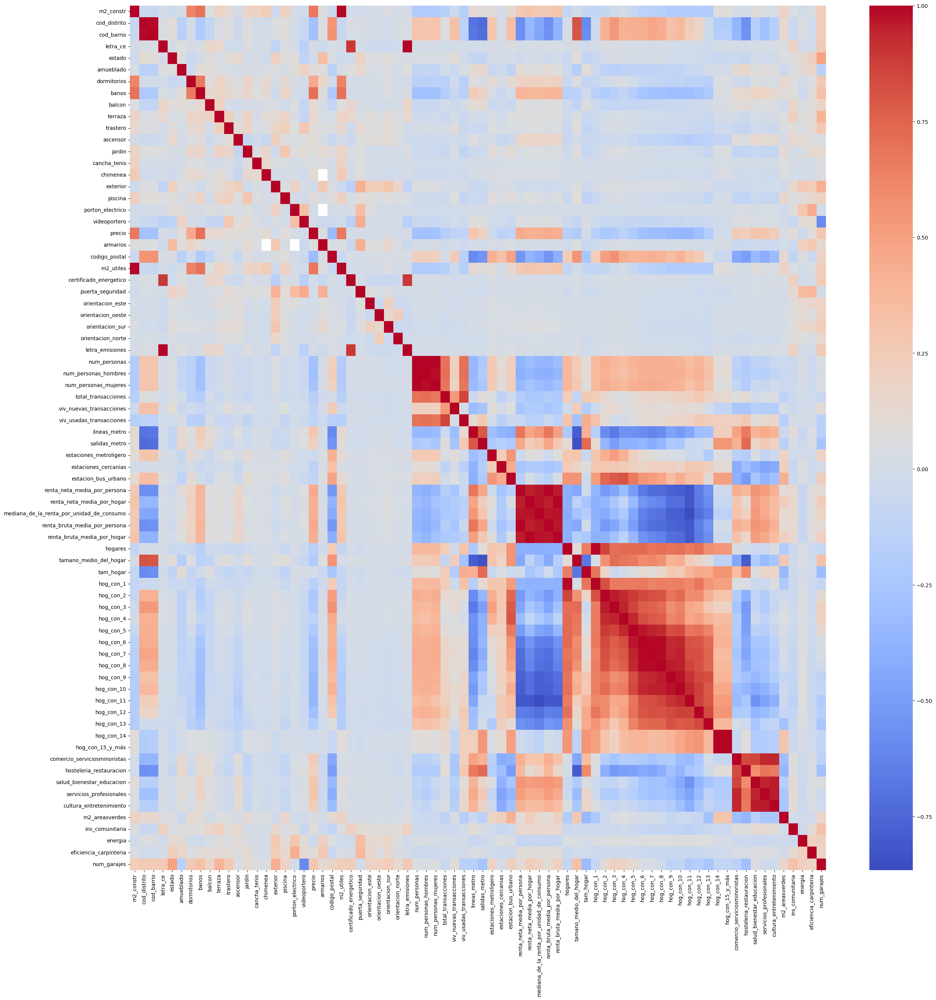

In [2935]:
# Calcular la matriz de correlación
correlation_matrix = dfn.corr()

# Graficar el heatmap
plt.figure(figsize=(30, 30))
sns.heatmap(correlation_matrix, fmt=".2f",cmap='coolwarm')
plt.show()

En la matriz de correlación, observamos la presencia de algunos puntos rojos. Esto indica que existen variables altamente correlacionadas entre sí, lo que significa que están proporcionando información redundante al modelo. Por lo tanto, procederemos a generar una lista de columnas que se pueden eliminar, ya que otras variables ya representan la misma información de manera efectiva. Este proceso nos ayudará a optimizar el modelo y evitar problemas de multicolinealidad

Creamos un dataset que incluye únicamente las variables numéricas. Luego, analizamos la correlación entre ellas para identificar aquellas que están altamente correlacionadas (con un coeficiente superior al 90%). Posteriormente, eliminamos una de las variables en cada par altamente correlacionado para reducir la multicolinealidad y optimizar el rendimiento del modelo. Este proceso no solo mejora la interpretabilidad, sino que también ayuda a evitar redundancias en los datos

In [2936]:
# Establecer un umbral para la correlación (90%)
threshold = 0.90

# Identificar pares de variables con correlación
correlations = []
already_seen = set()

for col in dfcorr.columns:
    for row in dfcorr.index:
        if abs(dfcorr.loc[row, col]) > threshold and col != row:
            pair = tuple(sorted((row, col)))  # Crear pares únicos
            if pair not in already_seen:
                correlations.append((row, col, dfcorr.loc[row, col]))
                already_seen.add(pair)  # Marcar par como ya visto

# Imprimir los resultados
print("Pares de variables con correlación mayor al 90%:")
for var1, var2, corr in correlations:
    print(f"{var1} y {var2}: {corr:.2f}")


Pares de variables con correlación mayor al 90%:
m2_utiles y m2_constr: 0.98
cod_barrio y cod_distrito: 0.99
num_personas_hombres y num_personas: 1.00
num_personas_mujeres y num_personas: 1.00
num_personas_mujeres y num_personas_hombres: 0.98
renta_neta_media_por_hogar y renta_neta_media_por_persona: 0.95
mediana_de_la_renta_por_unidad_de_consumo y renta_neta_media_por_persona: 0.97
renta_bruta_media_por_persona y renta_neta_media_por_persona: 1.00
renta_bruta_media_por_hogar y renta_neta_media_por_persona: 0.96
mediana_de_la_renta_por_unidad_de_consumo y renta_neta_media_por_hogar: 0.98
renta_bruta_media_por_persona y renta_neta_media_por_hogar: 0.95
renta_bruta_media_por_hogar y renta_neta_media_por_hogar: 1.00
renta_bruta_media_por_persona y mediana_de_la_renta_por_unidad_de_consumo: 0.97
renta_bruta_media_por_hogar y mediana_de_la_renta_por_unidad_de_consumo: 0.98
renta_bruta_media_por_hogar y renta_bruta_media_por_persona: 0.96
hog_con_1 y hogares: 0.99
hog_con_3 y hog_con_2: 0.96

Para determinar qué variable eliminaremos entre las que están correlacionadas, analizaremos la correlación de cada una de ellas con la variable objetivo, ademas tendremos en cuenta el % de nulos que tenia la variable en dataset original. Este enfoque nos permitirá identificar cuál aporta menos información relevante al modelo y, de esa manera, optimizar el conjunto de variables.

In [2937]:
dfcorr[['precio']].sort_values(by = 'precio',ascending = False).style.background_gradient()

,precio
precio,1.000000
m2_utiles,0.778173
banos,0.707543
m2_constr,0.674621
renta_bruta_media_por_persona,0.450327
renta_neta_media_por_persona,0.449267
dormitorios,0.443961
renta_bruta_media_por_hogar,0.426238
mediana_de_la_renta_por_unidad_de_consumo,0.422643
renta_neta_media_por_hogar,0.418733


### Análisis de las variables a eliminar

#### Comparaciones entre variables:
- **m2_utiles y m2_constr:**  
  Eliminamos `m2_utiles`, ya que `m2_constr` no tenía valores nulos en el dataset original.

- **cod_barrio y cod_distrito:**  
  De momento mantenemos las dos, lnecesitaremos ambas varaibles en para realizar la imputación de nulos.
  
- **num_persona,num_personas_mujeres y num_personas_hombres:**  
  Nos quedamos con `num_personas`, ya que está más correlacionada con la variable target.

- **viv_usadas_transacciones y total_transacciones:**  
  Nos quedamos con `total_transacciones`, ya que está más correlacionada con la variable target.


#### Bloque de variables relacionadas con la renta:
- **Variables analizadas:**  
  `renta_neta_media_por_persona`, `renta_neta_media_por_hogar`, `mediana_de_la_renta_por_unidad_de_consumo`, `renta_bruta_media_por_persona`, `renta_bruta_media_por_hogar`

- **Decisión:**  
  Nos quedamos con `renta_bruta_media_por_persona`, ya que es la variable más correlacionada con el precio.


#### Bloque de variables relacionadas con los hogares:
- **Variables analizadas:**  
  `habitantes`, `hogares`, `hog_con_1`, `hog_con_2`, `hog_con_3`, `hog_con_4`, `hog_con_5`, `hog_con_6`,  
  `hog_con_7`, `hog_con_8`, `hog_con_9`, `hog_con_10`, `hog_con_11`, `hog_con_12`, `hog_con_13`, `hog_con_14`, `hog_con_15_y_más`

- **Decisión:**  
  Nos quedamos con las columnas `habitantes`, `hog_con_10` y `hog_con_15_y_más`.

#### Bloque de variables relacionadas con servicios deen el barrio:
- **Variables analizadas:** 
 `servicios_profesionales `, `comercio_serviciosminoristas `, `cultura_entretenimiento `,  `salud_bienestar_educacion `

 - **Decisión:**  
  Nos quedamos con las todas las columnas, se creará una columna como suma de las cuatro.


In [2938]:
dfEDA.columns

Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'antiguedad',
       'jardin', 'tipo_inmueble', 'cancha_tenis', 'chimenea', 'exterior',
       'piscina', 'porton_electrico', 'videoportero', 'precio', 'web',
       'armarios', 'codigo_postal', 'm2_utiles', 'tipo_suelo',
       'certificado_energetico', 'puerta_seguridad', 'orientacion_este',
       'orientacion_oeste', 'orientacion_sur', 'aire', 'grupo_cocina',
       'orientacion_norte', 'letra_emisiones', 'num_personas',
       'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones',
       'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'lineas_metro',
       'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias',
       'estacion_bus_urbano', 'renta_neta_media_por_persona',
       'renta_neta_media_por_hogar',
       'mediana_de_la

In [2939]:

# Lista de variables a eliminar
cols_eliminar = ['m2_utiles','num_personas_hombres', 'num_personas_mujeres', 'viv_usadas_transacciones', 'renta_neta_media_por_persona', 
    'renta_neta_media_por_hogar', 'mediana_de_la_renta_por_unidad_de_consumo', 'renta_bruta_media_por_hogar', 
    'hogares', 'hog_con_1', 'hog_con_2', 'hog_con_3',  'hog_con_4', 'hog_con_5',  'hog_con_6',    'hog_con_7', 'hog_con_8', 
    'hog_con_9', 'hog_con_11', 'hog_con_12', 'hog_con_13',  'hog_con_14']

# Eliminar las variables del DataFrame
dfEDA = dfEDA.drop(columns=cols_eliminar)

print("Variables eliminadas correctamente. El nuevo DataFrame tiene estas columnas:")
print(dfEDA.columns)


Variables eliminadas correctamente. El nuevo DataFrame tiene estas columnas:
Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'antiguedad',
       'jardin', 'tipo_inmueble', 'cancha_tenis', 'chimenea', 'exterior',
       'piscina', 'porton_electrico', 'videoportero', 'precio', 'web',
       'armarios', 'codigo_postal', 'tipo_suelo', 'certificado_energetico',
       'puerta_seguridad', 'orientacion_este', 'orientacion_oeste',
       'orientacion_sur', 'aire', 'grupo_cocina', 'orientacion_norte',
       'letra_emisiones', 'num_personas', 'total_transacciones',
       'viv_nuevas_transacciones', 'lineas_metro', 'salidas_metro',
       'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano',
       'renta_bruta_media_por_persona', 'tamano_medio_del_hogar', 'tam_hogar',
       'hog_con_10', 'hog_con_15_y_má

Generamos una copia del dataframe antes de realizar la division en train y test

In [2940]:
dfEDA_completo=dfEDA.copy()

# *10. Division entre train y test*

## *10.1. Agrupación viviendas por precio promedio barrio*

In [2941]:
print(f"El DataFrame dfEDA tiene {dfEDA.shape[0]} filas y {dfEDA.shape[1]} columnas.")

El DataFrame dfEDA tiene 9863 filas y 63 columnas.


Para garantizar que los conjuntos de entrenamiento, validación y test estén equilibrados en términos de rangos de precio y barrios, se realizará una agrupación de las viviendas basada en el precio promedio por barrio. El procedimiento incluye los siguientes pasos:

1. **Cálculo del precio promedio por barrio**:
   - Agrupar los datos por la columna `cod_barrio` y calcular el promedio de los precios de las viviendas en cada barrio.

2. **Clasificación en cinco grupos**:
   - Utilizar `pd.qcut()` para dividir los barrios en cinco grupos equitativos según el precio promedio. Cada grupo será etiquetado con números del `1` al `5`.

3. **Creación del mapeo**:
   - Generar un diccionario que asigne cada `cod_barrio` a su grupo correspondiente (`cod_barrio_group`). Este mapeo luego será aplicado al DataFrame original para etiquetar las viviendas con sus respectivos grupos.

4. **Conteo de viviendas por grupo**:
   - Contar las viviendas en cada grupo y ordenar los resultados para garantizar que los conjuntos estén bien distribuidos.

5. **Exportación del mapeo**:
   - Guardar el diccionario `cod_barrio_mapping` en un archivo JSON para facilitar su reutilización en análisis futuros o actualizaciones del modelo.

Al seguir este proceso, los conjuntos de entrenamiento, validación y test contendrán viviendas de todos los rangos de precio y de diferentes barrios, lo que garantizará que el modelo sea entrenado con datos representativos y equilibrados.

Los grupos quedaran con estos rangos 
Grupo 1: Este grupo contiene 1599 viviendas. Rango de precios: 111940.91 - 232568.00. 
Grupo 2: Este grupo contiene 1206 viviendas. Rango de precios: 232568.00 - 334194.44. 
Grupo 3: Este grupo contiene 1322 viviendas. Rango de precios: 334194.44 - 590108.70. 
Grupo 4: Este grupo contiene 2148 viviendas. Rango de precios: 590108.70 - 937714.29. 
Grupo 5: Este grupo contiene 3588 viviendas. Rango de precios: 937714.29 - 3109250.00. 


In [2942]:
# Cálculo del precio promedio por barrio:
# Se agrupan los datos por cod_barrio y se calcula el promedio de los precios.
# Clasificación en cinco grupos:
# Se utiliza pd.qcut() para dividir los barrios en 5 grupos equitativos según el precio medio, asignando etiquetas del 1 al 5.
# Creación del mapeo:
# Se genera un diccionario que asigna cada cod_barrio a su grupo (cod_barrio_group), y luego se aplica al DataFrame original.
# Conteo de viviendas por grupo:
# Se cuentan las viviendas en cada grupo y se ordenan por índice.
# Definición de descripciones para cada grupo:
# Se proporciona una interpretación de cada grupo, destacando su nivel de precio en comparación con los demás.
# Exportación del mapeo a JSON:
# Se guarda el diccionario cod_barrio_mapping en un archivo JSON para poder reutilizarlo en análisis futuros.

#Se agrupan los datos por cod_barrio y se calcula el promedio de los precios.
codbarrio_precios = dfEDA.groupby('cod_barrio')['precio'].mean().reset_index()

# Clasificar los códigos de barrio en cinco grupos y obtener los límites de los intervalos
codbarrio_precios['cod_barrio_group'], bins = pd.qcut(
    codbarrio_precios['precio'], q=5, labels=[1, 2, 3, 4, 5], retbins=True
)

# Crear un diccionario de mapeo para asignar grupos a cada barrio en el DataFrame original
cod_barrio_mapping = dict(zip(codbarrio_precios['cod_barrio'], codbarrio_precios['cod_barrio_group']))
dfEDA['cod_barrio_group'] = dfEDA['cod_barrio'].map(cod_barrio_mapping)


# Función para asignar grupo en función del precio si el barrio no está en el mapeo
def asignar_grupo_por_precio(precio):
    for i in range(len(bins) - 1):
        if bins[i] <= precio < bins[i + 1]:
            return i + 1  # Grupos están etiquetados del 1 al 5
    return 5  # Si el precio es mayor que el último bin, asignar al grupo más alto


# Asignar grupo por precio si el barrio no está en el mapeo
dfEDA['cod_barrio_group'] = dfEDA.apply(
    lambda row: row['cod_barrio_group'] if pd.notna(row['cod_barrio_group']) 
    else asignar_grupo_por_precio(row['precio']), axis=1
)

# Contar viviendas por grupo
cod_barrio_group_counts = dfEDA["cod_barrio_group"].value_counts(dropna=False).sort_index()

# Descripciones de los grupos con rangos de precios
descriptions = {
    1: "las más baratas entre todas las categorías",
    2: "con precios moderadamente bajos en relación con los demás grupos",
    3: "con un rango de precios similar a las del Grupo 4",
    4: "más costosas que las del Grupo 3, pero similares",  
    5: "las viviendas más caras en el conjunto de datos"
}

# Mostrar la descripción de cada grupo con su rango de precios
for i, (group, count) in enumerate(cod_barrio_group_counts.items()):
    lower_bound = bins[i]  # Límite inferior del grupo
    upper_bound = bins[i + 1]  # Límite superior del grupo
    print(
        f"Grupo {group}: Este grupo contiene {count} viviendas. "
        f"Rango de precios: {lower_bound:.2f} - {upper_bound:.2f}. "
        f"Estas viviendas son {descriptions.get(group, 'una descripción no especificada.')}"
    )



# Exportar el mapeo y los bins para futuras asignaciones
data_to_save = {
    "cod_barrio_mapping": cod_barrio_mapping,
    "bins": bins.tolist()
}

# Guardar el archivo JSON


with open(rutajson + "cod_barrio_mapping.json", "w") as f:
    json.dump(data_to_save, f)


Grupo 1: Este grupo contiene 1599 viviendas. Rango de precios: 111940.91 - 232568.00. Estas viviendas son las más baratas entre todas las categorías
Grupo 2: Este grupo contiene 1206 viviendas. Rango de precios: 232568.00 - 334194.44. Estas viviendas son con precios moderadamente bajos en relación con los demás grupos
Grupo 3: Este grupo contiene 1322 viviendas. Rango de precios: 334194.44 - 590108.70. Estas viviendas son con un rango de precios similar a las del Grupo 4
Grupo 4: Este grupo contiene 2148 viviendas. Rango de precios: 590108.70 - 937714.29. Estas viviendas son más costosas que las del Grupo 3, pero similares
Grupo 5: Este grupo contiene 3588 viviendas. Rango de precios: 937714.29 - 3109250.00. Estas viviendas son las viviendas más caras en el conjunto de datos


Cada barrio está en un grupo cod_barrio_group

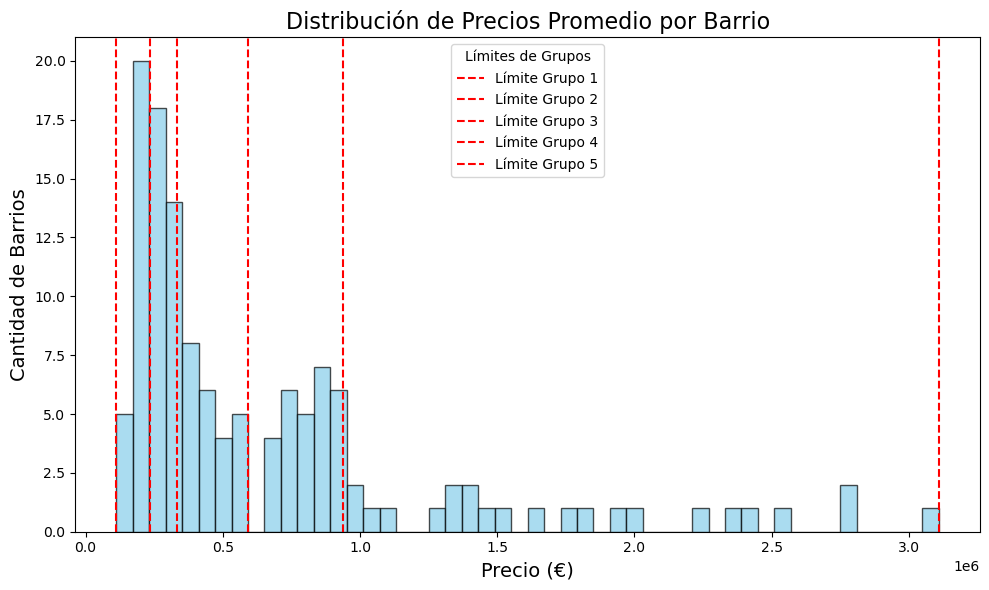

In [2943]:
# Histograma de precios
plt.figure(figsize=(10, 6))
plt.hist(codbarrio_precios['precio'], bins=50, color='skyblue', edgecolor='black', alpha=0.7)
plt.title('Distribución de Precios Promedio por Barrio', fontsize=16)
plt.xlabel('Precio (€)', fontsize=14)
plt.ylabel('Cantidad de Barrios', fontsize=14)

# Añadir límites de los grupos
for i, b in enumerate(bins):
    plt.axvline(x=b, color='red', linestyle='--', label=f'Límite Grupo {i+1}' if i < len(bins)-1 else None)

# Leyenda y visualización
plt.legend(title='Límites de Grupos', fontsize=10)
plt.tight_layout()
plt.show()


<Figure size 2000x1400 with 0 Axes>

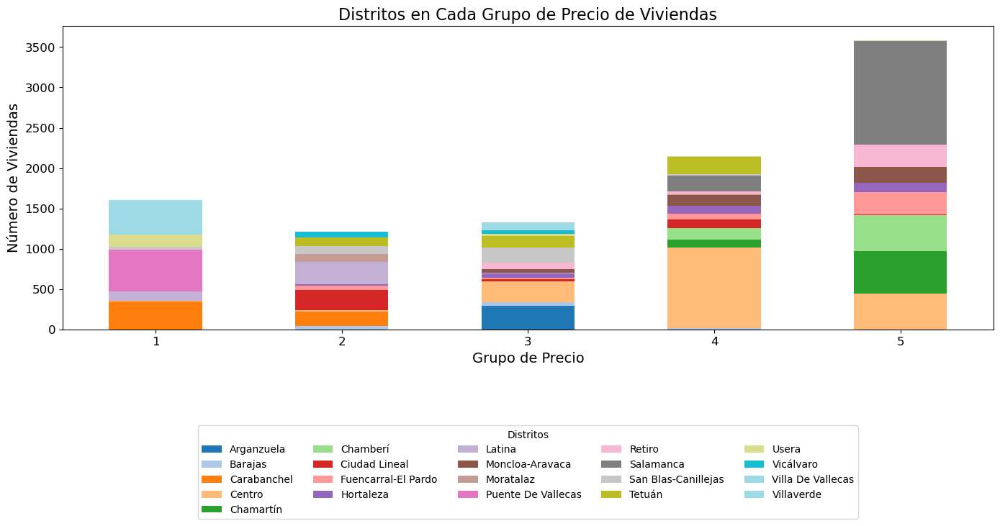

In [2944]:
# Crear una tabla cruzada de grupos y barrios
cross_tab = pd.crosstab(dfEDA['cod_barrio_group'], dfEDA['distrito'])

# Crear el gráfico de barras apiladas
plt.figure(figsize=(20, 14))
cross_tab.plot(kind='bar', stacked=True, figsize=(14, 8), colormap='tab20')

# Etiquetas y título del gráfico
plt.title('Distritos en Cada Grupo de Precio de Viviendas', fontsize=16)
plt.xlabel('Grupo de Precio', fontsize=14)
plt.ylabel('Número de Viviendas', fontsize=14)
plt.xticks(fontsize=12, rotation=0)
plt.yticks(fontsize=12)
plt.legend(
    title='Distritos',
    bbox_to_anchor=(0.5, -0.3),  # Centrado horizontalmente debajo del gráfico
    loc='upper center',  # Colocar en el centro superior de la caja especificada por bbox_to_anchor
    fontsize=10,
    ncol=5  # Organizar en múltiples columnas según el número de elementos
)
plt.tight_layout()


# Mostrar el gráfico
plt.show()


En el grafico se aprecia que las viviendas del distrito de Salmanca estan entre el grupo 4 y 5, y el grupo 1 está formado por viviendas de los barrios de Puente de Vallecas, Carabanchel Villaverde y Villa de Vallecas fundamentalmente.

10.2 Division entre train ,validacion y test

Vamos a generar dos divisiones que trataremos durante todo el dataframe, una dicision entre train, validacion y test y otra otra entre validacion y test.
En l a primera test tendrá el 20% de los datos y validacion el 20% de los datos de train.

En la segunda train tendrá el 80% de los datos y test el 20%.La division se realizó estratificando por la columna 'cod_barrio_group'

El número de observaciones de cada conjunto de datos fué 
Número de observaciones
- Train:  6312
- Test:   1973
- Val:    1578

y

Número de observaciones
- Train1:  6312
- Test1:   1973


Nota: Se podria haber hecho un unica dcisión y al final dividir train entre train y validación.

- La división se realizó **estratificando por la columna `cod_barrio_group`**, asegurando que todas las categorías de barrios estén representadas proporcionalmente en los tres conjuntos.
Para manejar el conjunto de datos de manera eficiente, se realizaron dos divisiones que se utilizarán a lo largo de todo el análisis:

### Primera División: **Train, Validación y Test**
- En esta división, se definió:
  - **Test**: 20% de los datos totales.
  - **Validación**: 20% de los datos del conjunto de **Train**.

- **Número de observaciones resultantes**:
  - **Train**: 6312 observaciones.
  - **Test**: 1973 observaciones.
  - **Validación**: 1578 observaciones.

### Segunda División: **Train y Test**
- En esta división, se tomó:
  - **Train**: 80% de los datos.
  - **Test**: 20% de los datos.
- También se realizó **estratificación por la columna `cod_barrio_group`** para garantizar representatividad.
- **Número de observaciones resultantes**:
  - **Train1**: 6312 observaciones.
  - **Test1**: 1973 observaciones.


Nota:
Se consideró que, en lugar de realizar dos divisiones separadas, se podría haber optado por una única división inicial, seguida de la separación del conjunto de **Train** en **Train** y **Validación**. Este enfoque simplificaría el procedimiento, pero ambas opciones son válidas dependiendo de las necesidades del análisis.


In [2945]:
#Incluyo la columna url para crear df_ids para almacenar los identificadores de lcada vivienda
dfM=dfEDA.copy()
print(dfM['cod_barrio_group'].value_counts())

cod_barrio_group
5    3588
4    2148
1    1599
3    1322
2    1206
Name: count, dtype: int64


In [2946]:
# Dividir las columnas objetivo y características

y = dfM['precio'].values  # Asegúrate de usar la columna correcta para 'cod_barrio_group'

df_ids = dfM[['url']]

X = dfM.drop(columns=['precio'])
# Primera clasificación entre train y test, estratificando por 'cod_barrio_group'
X_train, X_test, y_train, y_test, ids_train, ids_test = train_test_split(X, y, df_ids, test_size=0.2, random_state=42, stratify=X['cod_barrio_group'], shuffle=True
)

#Realizo otra division para modelos en los que necesite soo dividir entre train y test
# Primera clasificación entre train y test, estratificando por 'cod_barrio_group'
X_train1, X_test1, y_train1, y_test1, ids_train1, ids_test1 = train_test_split(X, y, df_ids, test_size=0.2, random_state=42, stratify=X['cod_barrio_group'], shuffle=True
)

# Verificar la distribución de las clases en train y test
print("Distribución en el conjunto de entrenamiento:")
print(pd.Series(y_train).value_counts())
print("Distribución en el conjunto de test:")
print(pd.Series(y_test).value_counts())

# Segunda división: Train y Validación a partir de X_train, estratificando también
X_train, X_val, y_train, y_val = train_test_split(
    X_train, y_train, test_size=0.2, random_state=42, stratify=X_train['cod_barrio_group'], shuffle=True
)

# Verificar la distribución de las clases en train y validación
print("Distribución en el conjunto de validación:")

print(pd.Series(y_val).value_counts())
# Número de registros del dataset de train, test y validación
print("Número de observaciones")
print("- Train: ", X_train.shape[0])
print("- Test:  ", X_test.shape[0])
print("- Val:   ", X_val.shape[0])


# Número de registros del dataset de train, test y validación
print("Número de observaciones")
print("- Train1: ", X_train.shape[0])
print("- Test1:  ", X_test.shape[0])


# Resetear los índices para cada conjunto
dftrain = X_train
dftest = X_test
dfval = X_val

# Resetear los índices para cada conjunto
dftrain1 = X_train1
dftest1 = X_test1


#Incluimos variable target en los datarframes dftrain,dfvalidacion,dftest para utilizarlos donde sea necesario
dftrain ["target"]= y_train

dftrain1 ["target"]= y_train1




Distribución en el conjunto de entrenamiento:
240000.00    50
230000.00    49
220000.00    49
210000.00    47
350000.00    45
             ..
135900.00     1
553000.00     1
504900.00     1
269600.00     1
180600.00     1
Name: count, Length: 1440, dtype: int64
Distribución en el conjunto de test:
330000.00     18
950000.00     17
320000.00     15
280000.00     15
1149000.00    14
              ..
1425000.00     1
110000.00      1
214900.00      1
151900.00      1
107900.00      1
Name: count, Length: 726, dtype: int64
Distribución en el conjunto de validación:
180000.00     13
220000.00     13
250000.00     13
260000.00     13
199000.00     12
              ..
89000.00       1
825000.00      1
6950000.00     1
679900.00      1
770000.00      1
Name: count, Length: 654, dtype: int64
Número de observaciones
- Train:  6312
- Test:   1973
- Val:    1578
Número de observaciones
- Train1:  6312
- Test1:   1973


Comprobamos que entrenameros con viviendas de los 131 barriode de Madrid

In [2947]:
dfEDA.shape,dftrain.shape

((9863, 64), (6312, 64))

In [2948]:
dftrain['cod_barrio'].nunique(),dftrain1['cod_barrio'].nunique()

(131, 131)

# *11. Feature Engineering*

## *11.1 Variables pendientes de imputar nulos*

In [2949]:
# Función `columnas_por_tipo` que muestra un resumen de los tipo de columnas que hay en el dataframe
boolean_columns, cols_num, cat_columns,object_columns,other_columns,num_nobool, cols_noboolean = columnas_por_tipo(dftrain)

Número de columnas de tipo entero: 16
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'letra_ce', 'estado', 'jardin', 'exterior', 'piscina', 'codigo_postal', 'letra_emisiones', 'num_personas', 'total_transacciones', 'viv_nuevas_transacciones', 'ins_comunitaria', 'energia', 'eficiencia_carpinteria', 'cod_barrio_group']
------------------------------------------------------
Número de columnas de tipo float: 37
Columnas de tipo float: ['m2_constr', 'amueblado', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'chimenea', 'porton_electrico', 'videoportero', 'armarios', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'lineas_metro', 'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano', 'renta_bruta_media_por_persona', 'tamano_medio_del_hogar', 'tam_hogar', 'hog_con_10', 'hog_con_15_y_más', 'comercio_serviciosminoristas', 'hosteleria_r

In [2950]:
# Calcular el porcentaje de nulos para cada columna
porcentaje_nulos = (dftrain.isnull().sum() / len(dftrain)) * 100

# Filtrar columnas con valores nulos
columnas_con_nulos = porcentaje_nulos[porcentaje_nulos > 0]

# Mostrar el porcentaje de nulos
print(columnas_con_nulos.sort_values(ascending=False))


armarios           87.64
num_garajes        79.96
porton_electrico   69.31
puerta_seguridad   69.04
videoportero       66.59
ascensor           53.41
planta             41.29
banos               4.10
dormitorios         1.63
dtype: float64


La siguiente llista contiene las columnas que aún tienen valores nulos y su respectivo porcentaje:

| **Columna**           | **% de Nulos** |
|------------------------|----------------|
| **armarios**           | 87.64%         |
| **num_garajes**        | 79.96%         |
| **porton_electrico**   | 69.31%         |
| **puerta_seguridad**   | 69.04%         |
| **videoportero**       | 66.59%         |
| **ascensor**           | 53.41%         |
| **planta**             | 41.29%         |
| **baños**              | 4.10%          |
| **dormitorios**        | 1.63%          |

A estas columnas les aplicaremos distintos procesos para realizar proceso de imputación.


#### *11.1.1 Imputacion de nulos con la moda por barrio en variables booleanas*

La imputación de valores nulos en variables booleanas se realizará utilizando la **moda de cada barrio** después de dividir los datos en los conjuntos de entrenamiento, validación y test. Este procedimiento asegura que la información entre los conjuntos permanezca independiente, evitando fugas de datos (*data leakage*). 

Si la imputación se llevara a cabo antes de la división, el modelo de entrenamiento podría beneficiarse indirectamente de información proveniente de los conjuntos de validación o test, lo que generaría resultados demasiado optimistas y poco realistas. Al realizar la imputación posteriormente, garantizamos que las métricas obtenidas en validación y test sean fiables y representen de manera precisa el rendimiento del modelo en datos desconocidos.

Las variables a las que se aplicará este procedimiento y sus respectivos porcentajes de valores nulos son:
- **ascensor**: 54.29%
- **porton_electrico**: 69.29%
- **videoportero**: 66.62%
- **puerta_seguridad**: 69.04%

Además guardaresmos en un ficheros las modas imputadas para utilizarlas cunado el modelo esté en producción "estadisticos_imp_nulos_bool.json"

In [2951]:
[col for col in boolean_columns if dfEDA[col].isna().any()]

['ascensor', 'porton_electrico', 'videoportero', 'puerta_seguridad']

In [2952]:

modas_por_barrio_bol = calcular_estadistico_por_col(dftrain, 'cod_barrio', boolean_columns, 'mode')
modas_por_barrio_bol1 = calcular_estadistico_por_col(dftrain1, 'cod_barrio', boolean_columns, 'mode')

modas_por_distrito_bol = calcular_estadistico_por_col(dftrain, 'cod_distrito', boolean_columns, 'mode')
modas_por_distrito_bol1 = calcular_estadistico_por_col(dftrain1, 'cod_distrito', boolean_columns, 'mode')

# Imputar valores nulos con la moda por barrio en  dftrain, X_val y X_test
dftrain_imputado = imputar_valores(dftrain, modas_por_barrio_bol, 'cod_barrio')
X_val_imputado = imputar_valores(X_val, modas_por_barrio_bol, 'cod_barrio')
X_test_imputado = imputar_valores(X_test, modas_por_barrio_bol, 'cod_barrio')
dftrain1_imputado = imputar_valores(dftrain1, modas_por_barrio_bol1, 'cod_barrio')

X_test1_imputado = imputar_valores(X_test1, modas_por_barrio_bol1, 'cod_barrio')

# Guardar en un diccionario para exportar
estadisticos = {
    "modas_por_barrio_bol": modas_por_barrio_bol,
    "modas_por_barrio_bol1": modas_por_barrio_bol1,
    "modas_por_distrito_bol": modas_por_distrito_bol,
    "modas_por_distrito_bol1": modas_por_distrito_bol1,
 
}

# Guardar en un archivo JSON
with open(rutajson + "estadisticos_imp_nulos_bool.json", "w") as f:
    json.dump(estadisticos, f)

print("Estadísticos guardados en 'estadisticos_imputacion_bool.json'.")


Estadísticos guardados en 'estadisticos_imputacion_bool.json'.


In [2953]:
#comprobamos una de las columnas
dftrain_imputado["ascensor"].value_counts(dropna=False)

ascensor
1.00    6011
0.00     279
NaN       22
Name: count, dtype: int64

In [2954]:
#itlizando la moda por barrio quedan nulos por que hay barrios que todos los valores son nan, aplico la moda del distrito
dftrain_imputado = imputar_valores(dftrain, modas_por_distrito_bol, 'cod_distrito')
X_val_imputado = imputar_valores(X_val, modas_por_distrito_bol, 'cod_distrito')
X_test_imputado = imputar_valores(X_test, modas_por_distrito_bol, 'cod_distrito')
dftrain1_imputado = imputar_valores(dftrain1, modas_por_distrito_bol1, 'cod_distrito')
X_test1_imputado = imputar_valores(X_test1, modas_por_distrito_bol1, 'cod_distrito')

#Igualamos dftrain_imputado  a dftrain

In [2955]:
dftrain =dftrain_imputado.copy() 
X_val =X_val_imputado.copy()  
X_test =X_test_imputado.copy()  
dftrain1 =dftrain1_imputado.copy()  
X_test1 =X_test_imputado.copy()  

In [2956]:
dftrain.shape

(6312, 64)

In [2957]:
modas_por_barrio_bol.keys()

dict_keys(['balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'chimenea', 'porton_electrico', 'videoportero', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte'])

In [2958]:
valores_ascensor = modas_por_barrio_bol.get("ascensor")
print(valores_ascensor)

{11: 1.0, 12: 1.0, 13: 1.0, 14: 1.0, 15: 1.0, 16: 1.0, 21: 1.0, 22: 1.0, 23: 1.0, 24: 1.0, 25: 1.0, 26: 1.0, 27: 1.0, 31: 1.0, 32: 1.0, 33: 1.0, 34: 1.0, 35: 1.0, 36: 1.0, 41: 1.0, 42: 1.0, 43: 1.0, 44: 1.0, 45: 1.0, 46: 1.0, 51: 1.0, 52: 1.0, 53: 1.0, 54: 1.0, 55: 1.0, 56: 1.0, 61: 1.0, 62: 1.0, 63: 1.0, 64: 1.0, 65: 1.0, 66: 1.0, 71: 1.0, 72: 1.0, 73: 1.0, 74: 1.0, 75: 1.0, 76: 1.0, 81: 1.0, 82: 1.0, 83: 1.0, 84: 1.0, 85: 1.0, 86: 0.0, 87: 1.0, 88: nan, 91: nan, 92: 1.0, 93: 1.0, 94: 1.0, 95: 1.0, 96: 0.0, 97: 1.0, 101: 1.0, 102: 1.0, 103: 1.0, 104: 1.0, 105: 1.0, 106: 1.0, 107: 1.0, 111: 1.0, 112: 1.0, 113: 1.0, 114: 1.0, 115: 1.0, 116: 1.0, 117: 1.0, 121: 1.0, 122: 1.0, 123: 1.0, 124: 1.0, 125: 1.0, 126: 0.0, 127: 1.0, 131: 1.0, 132: 1.0, 133: 1.0, 134: 1.0, 135: 1.0, 136: 1.0, 141: 1.0, 142: 1.0, 143: 1.0, 144: 1.0, 145: 1.0, 146: 1.0, 151: 1.0, 152: 1.0, 153: 1.0, 154: 1.0, 155: 1.0, 156: 1.0, 157: 1.0, 158: 1.0, 159: 1.0, 161: 1.0, 162: 1.0, 163: 1.0, 164: 1.0, 165: 1.0, 166: 1.

In [2959]:
#Comprobamos que no tenemos nulos en varibles binarias
[col for col in dftrain.columns if dftrain_imputado[col].isnull().sum() > 0]

['planta', 'dormitorios', 'banos', 'armarios', 'num_garajes']

### *11.2.1 Imputacion de nulos con la mediana de varables no booleanos*



Imputación de valores nulos en `planta`, `baños`, `dormitorios` y `num_garajes`:

**Variable `baños`**:
   - Los valores nulos se imputarán utilizando la **mediana** agrupada por **barrio** y la columna `cod_barrio_m2_contr` (metros construidos por barrio).

**Variable `dormitorios`**:
   - Se aplicará un enfoque similar, utilizando la **mediana** por agrupación de **barrio** y `cod_barrio_m2_contr`.

**Variable `armarios`**:
   - Se aplicará un enfoque similar, utilizando la **mediana** por agrupación de **barrio** y `cod_barrio_m2_contr`.

**Variable `planta`**:
   - Los valores nulos se imputarán en dos pasos principales:
     1. **Para la tipología `Atico`**: 
        - Se utiliza un diccionario que contiene los **máximos** de `planta` por **barrio** y **distrito**, calculados a partir de los conjuntos de entrenamiento (`dftrain` y `dftrain1`).
     2. **Para el resto de tipologías**:
        - Se calcula la **mediana** de `planta` agrupando por **barrio** y **tipología** o por **distrito** y **tipología**.

       - Si todavía quedan valores nulos, se asigna un valor por defecto de `2`.

**Variable `num_garajes`**:
   - Los valores nulos se imputarán utilizando la **moda** calculada:
     - Primero, por **barrio** (`cod_barrio`).
     - Luego, en caso de valores restantes, por **distrito** (`cod_distrito`).


Clasificación por rangos de metros construidos (`m2_constr`) utilizado para `baños` , `dormitorios` y  `armarios`:

Para `X_train`:
| **Grupo** | **Número de viviendas** | **Rango (m2_constr)**          |
|-----------|--------------------------|---------------------------------|
| Grupo 1   | 824                      | 53.86 - 79.67                  |
| Grupo 2   | 1090                     | 79.67 - 92.31                  |
| Grupo 3   | 1115                     | 92.31 - 121.21                 |
| Grupo 4   | 1713                     | 121.21 - 147.80                |
| Grupo 5   | 1570                     | 147.80 - 913.27                |

Para `X_train1`:
| **Grupo** | **Número de viviendas** | **Rango (m2_constr)**          |
|-----------|--------------------------|---------------------------------|
| Grupo 1   | 968                      | 53.58 - 78.17                  |
| Grupo 2   | 1484                     | 78.17 - 90.53                  |
| Grupo 3   | 1543                     | 90.53 - 124.80                 |
| Grupo 4   | 1989                     | 124.80 - 151.52                |
| Grupo 5   | 1906                     | 151.52 - 968.73                |



Diccionarios generados para `planta`:

1. **Máximos de planta por barrio y distrito**:
   - **`max_planta_barrio_dict`** y **`max_planta_distrito_dict`**: Diccionarios creados con los valores máximos de `planta` calculados por **barrio** y **distrito** a partir del conjunto `dftrain`.
   - **`max_planta_barrio_dict1`** y **`max_planta_distrito_dict1`**: Similares, pero para el conjunto `dftrain1`.

2. **Medianas de planta por agrupaciones**:
   - **`median_por_barrio_bol_dict`** y **`median_por_distrito_bol_dict`**: Contienen las **medianas** por **barrio** y **tipología**, o por **distrito** y **tipología**, calculadas en `dftrain`.
   - **`median_por_barrio_bol_dict1`** y **`median_por_distrito_bol_dict1`**: Similares, pero calculadas en `dftrain1`.


Diccionarios generados para `baños`, `dormitorios` y `num_garajes`:

1. **Diccionario `median_codbarrio_m2_constr.json`**:
   - Incluye las medianas calculadas para baños y dormitorios por **barrio** y **distrito**.

2. **Diccionario `median_global_m2_constr.json`**:
   - Almacena las medianas globales para casos donde no haya datos disponibles por barrio o distrito.

3. **Diccionario `moda_num_garajes.json`**:
   - Contiene las modas de `num_garajes` calculadas por **barrio** y **distrito** para imputaciones más precisas.


Todos los diccionarios se guardan en archivos JSON, permitiendo reutilizarlos en otros análisis o imputaciones posteriores sin necesidad de recalcular.




Llamamos a la funcion clasificar_barrios_por_m2 para crear en los conjuntos de train la agrupación de m2_constr y barrio

In [2960]:

# Clasificación en dftrain y obtener los límites de corte
dftrain, bins_xtrain = clasificar_barrios_por_m2(dftrain, num_grupos=5)
dftrain1, bins_xtrain1 = clasificar_barrios_por_m2(dftrain1, num_grupos=5)


Clasificación de barrios según m2_constr:
Grupo 1: 824 viviendas, rango de m2_constr: 53.86 - 79.67
Grupo 2: 1090 viviendas, rango de m2_constr: 79.67 - 92.31
Grupo 3: 1115 viviendas, rango de m2_constr: 92.31 - 121.21
Grupo 4: 1713 viviendas, rango de m2_constr: 121.21 - 147.80
Grupo 5: 1570 viviendas, rango de m2_constr: 147.80 - 913.27

Clasificación de barrios según m2_constr:
Grupo 1: 968 viviendas, rango de m2_constr: 53.58 - 78.17
Grupo 2: 1484 viviendas, rango de m2_constr: 78.17 - 90.53
Grupo 3: 1543 viviendas, rango de m2_constr: 90.53 - 124.80
Grupo 4: 1989 viviendas, rango de m2_constr: 124.80 - 151.52
Grupo 5: 1906 viviendas, rango de m2_constr: 151.52 - 968.73


Aplicamos la clasificación realizada en dftrain a los conjuntos de datos de validación y test

In [2961]:
# Aplicar clasificación en X_val y X_test
X_val = aplicar_clasificacion(X_val, bins_xtrain )
X_test = aplicar_clasificacion(X_test, bins_xtrain )
X_test1 = aplicar_clasificacion(X_test1, bins_xtrain1)

In [2962]:

dftrain['cod_barrio'].unique()

array([213,  46,  13,  11,  16, 107, 114,  14,  66, 214, 203, 116,  52,
        42, 174,  15, 172, 171,  41,  92,  75,  97,  76, 131,  84,  63,
        21,  12,  81, 124,  45, 144, 117,  65, 102,  91, 135, 113, 205,
        56,  94,  34,  51, 208, 111,  62,  23,  95, 192, 143, 206, 201,
       191, 164,  87, 155,  32, 204,  72,  93,  74,  43, 105, 132, 153,
        73,  44, 112,  31, 115, 207, 202, 181,  55, 104, 122, 166, 136,
        22, 151, 175, 154, 145, 183, 215, 146, 163,  83, 133,  71,  64,
       103,  54, 152,  36, 101, 126,  35,  61, 123, 162, 165, 182, 161,
        96, 159, 134, 157, 158, 156,  26, 211,  53, 121,  25,  82, 194,
        27, 125,  24,  33, 127, 173,  86,  85, 141, 212, 106,  88, 193,
       142])

#### *11.2.1.1 Baños y dormitorios*

In [2963]:
dftrain['banos'].value_counts(dropna=False)

banos
1.00     2465
2.00     2024
3.00      828
5.00      413
NaN       259
4.00      250
6.00       44
7.00       15
8.00        5
11.00       2
10.00       2
9.00        2
12.00       2
13.00       1
Name: count, dtype: int64

In [2964]:
dftrain['dormitorios'].value_counts(dropna=False)

dormitorios
3.00     2172
2.00     1756
4.00      850
1.00      801
5.00      308
6.00      119
NaN       103
0.00       89
7.00       57
8.00       26
9.00       14
10.00      10
11.00       4
12.00       3
Name: count, dtype: int64

In [2965]:
cols=["dormitorios","banos","armarios"]
cols_agr=["cod_barrio",'cod_barrio_m2_contr']
cols_agr2=["cod_distrito",'cod_barrio_m2_contr']

median_por_barrio = calcular_est_por_cols(dftrain, cols_agr, cols, 'median')
median_por_barrio1 = calcular_est_por_cols(dftrain1, cols_agr, cols, 'median')

median_por_distrito = calcular_est_por_cols(dftrain, cols_agr2, cols, 'median')
median_por_distrito1 = calcular_est_por_cols(dftrain1, cols_agr2, cols, 'median')

# Guardar en un diccionario estructurado
estadisticos = {
    "median_por_barrio": median_por_barrio,
    "median_por_barrio1": median_por_barrio1,
    "median_por_distrito": median_por_distrito,
    "median_por_distrito1": median_por_distrito1,  
}

# Convertir el diccionario estadisticos_str
estadisticos_str = convertir_claves_a_str(estadisticos)

# Guardar en JSON
with open(rutajson + "median_codbarrio_m2_constr.json", "w", encoding="utf-8") as f:
    json.dump(estadisticos_str, f, ensure_ascii=False, indent=4)

print("Archivo JSON guardado con las claves convertidas en cadenas.")

Archivo JSON guardado con las claves convertidas en cadenas.


In [2966]:
# Imputar valores nulos con la moda por barrio en  dftrain, X_val y X_test
dftrain_imputado = imputar_cols_valores(dftrain, median_por_barrio, cols_agr)
X_val_imputado = imputar_cols_valores(X_val, median_por_barrio, cols_agr)
X_test_imputado = imputar_cols_valores(X_test, median_por_barrio, cols_agr)
dftrain1_imputado = imputar_cols_valores(dftrain1, median_por_barrio1, cols_agr)
X_test1_imputado = imputar_cols_valores(X_test1, median_por_barrio1, cols_agr)

In [2967]:
# Imputar valores nulos con la moda por distito en  dftrain, X_val y X_test
dftrain_imputado = imputar_cols_valores(dftrain, median_por_distrito, cols_agr)
X_val_imputado = imputar_cols_valores(X_val, median_por_distrito, cols_agr)
X_test_imputado = imputar_cols_valores(X_test, median_por_distrito, cols_agr)
dftrain1_imputado = imputar_cols_valores(dftrain1, median_por_distrito1, cols_agr)
X_test1_imputado = imputar_cols_valores(X_test1, median_por_distrito1, cols_agr)

Comprobación en los nulos de baño, del barrio de Embajadores, doc_barrio=12

In [2968]:
dfEDA.query("banos.isnull() and m2_constr==32")[["m2_constr","barrio","distrito"]]

,m2_constr,barrio,distrito
106,32.00,Embajadores,Centro
1872,32.00,Palomeras Bajas,Puente De Vallecas
4380,32.00,Ríos Rosas,Chamberí


In [2969]:
dftrain_imputado.query(" m2_constr==32 & barrio=='Embajadores'")[["banos","distrito","m2_constr","barrio","cod_barrio_m2_contr"]]

,banos,distrito,m2_constr,barrio,cod_barrio_m2_contr
2945,1.00,Centro,32.00,Embajadores,2
106,1.00,Centro,32.00,Embajadores,2
2165,1.00,Centro,32.00,Embajadores,2


In [2970]:
print(f"Porcentaje de valores nulos en la columna 'banos': {(dftrain_imputado['banos'].isna().sum() / len(dftrain_imputado) * 100):.2f}%")
print(f"Porcentaje de valores nulos en la columna 'dormitorios': {(dftrain_imputado['dormitorios'].isna().sum() / len(dftrain_imputado) * 100):.2f}%")
print(f"Porcentaje de valores nulos en la columna 'armarios': {(dftrain_imputado['armarios'].isna().sum() / len(dftrain_imputado) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'banos': 3.77%
Porcentaje de valores nulos en la columna 'dormitorios': 1.51%
Porcentaje de valores nulos en la columna 'armarios': 84.25%


In [2971]:

# Aplicación de la imputación y obtención de los diccionarios de medianas
dftrain_imputado, mediana_dict = imputar_col_con_mediana(dftrain, cols)
dftrain1_imputado, mediana_dict1 = imputar_col_con_mediana(dftrain1, cols)

X_val_imputado, _ = imputar_col_con_mediana(X_val, cols, mediana_dict)
X_test_imputado, _ = imputar_col_con_mediana(X_test, cols, mediana_dict)
X_test1_imputado, _ = imputar_col_con_mediana(X_test1, cols, mediana_dict1)

# Convertir los diccionarios de medianas a strings si es necesario
mediana_dict_str = convertir_claves_a_str(mediana_dict)
mediana_dict1_str = convertir_claves_a_str(mediana_dict1)

# Guardar los diccionarios en un archivo JSON
estadisticos_imputacion = {
    "mediana_dict": mediana_dict_str,
    "mediana_dict1": mediana_dict1_str
}

# Guardar en un archivo JSON
with open(rutajson +"median_global_m2_constr.json", "w", encoding="utf-8") as f:
    json.dump(estadisticos_imputacion, f, ensure_ascii=False, indent=4)

print("Archivo JSON con las medianas de imputación guardado exitosamente.")


Archivo JSON con las medianas de imputación guardado exitosamente.


In [2972]:
#Eliminamos la columna cod_barrio_m2_contr creada para la imputacion de nulos

In [2973]:
dftrain_imputado=dftrain_imputado.drop(columns="cod_barrio_m2_contr")
X_test_imputado=X_test_imputado.drop(columns="cod_barrio_m2_contr")
X_test1_imputado=X_test1_imputado.drop(columns="cod_barrio_m2_contr")
dftrain1_imputado=dftrain1_imputado.drop(columns="cod_barrio_m2_contr")
X_val_imputado=X_val_imputado.drop(columns="cod_barrio_m2_contr")

In [2974]:
dftrain =dftrain_imputado.copy()  
X_val =X_val_imputado.copy()  
X_test =X_test_imputado.copy()  
dftrain1 =dftrain1_imputado.copy()  
X_test1 =X_test_imputado.copy()  

In [2975]:
dftrain.shape

(6312, 64)

#### *11.2.1.2 Planta*

In [2976]:
dftrain['planta'].value_counts(dropna=False)

planta
 NaN     2606
 1        801
 2        538
 3        470
 0        440
 4        349
 5        197
 6        185
 0        123
 7         85
 1.0       84
 2.0       80
 3.0       65
 4.0       49
0.50       47
 8         39
 5.0       34
 9         27
 6.0       21
 10        12
 7.0       10
 11         9
 13         7
 3          6
 8.0        5
 12         4
 9.0        3
 14         3
 15         2
 10.0       2
 22         2
-0.50       1
 -1         1
 16         1
 27         1
 0.0        1
 -1         1
 18         1
Name: count, dtype: int64

In [2977]:
# Convertir la columna 'planta' a valores numéricos (reemplaza no numéricos con NaN)
dftrain['planta'] = pd.to_numeric(dftrain['planta'], errors='coerce')
dftrain1['planta'] = pd.to_numeric(dftrain1['planta'], errors='coerce')

In [2978]:
# Cálculos de los máximos por barrio y distrito
max_planta_barrio = dftrain[dftrain['cod_barrio'].notnull() & dftrain['planta'].notnull()].groupby('cod_barrio')['planta'].max().astype(int)
max_planta_distrito = dftrain[dftrain['cod_distrito'].notnull() & dftrain['planta'].notnull()].groupby('cod_distrito')['planta'].max().astype(int)

max_planta_barrio1 = dftrain1[dftrain1['cod_barrio'].notnull() & dftrain['planta'].notnull()].groupby('cod_barrio')['planta'].max().astype(int)
max_planta_distrito1 = dftrain1[dftrain1['cod_distrito'].notnull() & dftrain['planta'].notnull()].groupby('cod_distrito')['planta'].max().astype(int)

# Convertir los resultados a diccionarios
max_planta_barrio_dict = max_planta_barrio.to_dict()
max_planta_distrito_dict = max_planta_distrito.to_dict()

max_planta_barrio_dict1 = max_planta_barrio1.to_dict()
max_planta_distrito_dict1 = max_planta_distrito1.to_dict()

# Convertir las claves a cadenas si es necesario
max_planta_barrio_dict_str = convertir_claves_a_str(max_planta_barrio_dict)
max_planta_distrito_dict_str = convertir_claves_a_str(max_planta_distrito_dict)
max_planta_barrio_dict1_str = convertir_claves_a_str(max_planta_barrio_dict1)
max_planta_distrito_dict1_str = convertir_claves_a_str(max_planta_distrito_dict1)

# Guardar en un archivo JSON
estadisticos_max_planta = {
    "max_planta_barrio_dict": max_planta_barrio_dict_str,
    "max_planta_distrito_dict": max_planta_distrito_dict_str,
    "max_planta_barrio_dict1": max_planta_barrio_dict1_str,
    "max_planta_distrito_dict1": max_planta_distrito_dict1_str
}

# Guardar el archivo JSON
with open(rutajson +"max_planta.json", "w", encoding="utf-8") as f:
    json.dump(estadisticos_max_planta, f, ensure_ascii=False, indent=4)

print("Archivo JSON con los valores máximos de plantas por barrio y distrito guardado exitosamente.")


Archivo JSON con los valores máximos de plantas por barrio y distrito guardado exitosamente.


In [2979]:
def imputar_planta_por_barrio(df, max_planta_barrio_dict,tipologia):
    """
    Imputa los valores nulos en la columna 'planta' de un DataFrame para las filas donde la tipología es 'Atico',
    usando los valores máximos de planta por barrio provenientes de un diccionario.

    Args:
        df: DataFrame con los datos a imputar.
        max_planta_barrio_dict: Diccionario con los máximos de planta por barrio.
    
    Returns:
        DataFrame con los valores imputados en la columna 'planta'.
    """
    df['planta'] = df.apply(
        lambda row: max_planta_barrio_dict.get(row['cod_barrio'], row['planta']) 
        if row['tipologia'] == tipologia and pd.isnull(row['planta']) 
        else row['planta'],
        axis=1
    )
    return df




In [2980]:
# Uso de la función
dftrain_imputado = imputar_planta_por_barrio(dftrain, max_planta_barrio_dict,'Atico')
X_test_imputado = imputar_planta_por_barrio(X_test, max_planta_barrio_dict,'Atico')
X_val_imputado = imputar_planta_por_barrio(X_val, max_planta_barrio_dict,'Atico')
dftrain1_imputado = imputar_planta_por_barrio(dftrain1, max_planta_barrio_dict1,'Atico')
X_test1_imputado = imputar_planta_por_barrio(X_test1, max_planta_barrio_dict1,'Atico')

In [2981]:
dftrain =dftrain_imputado.copy()
X_val =X_val_imputado.copy()
X_test =X_test_imputado.copy()
dftrain1 =dftrain1_imputado.copy()
X_test1 =X_test_imputado.copy()

Ahora imputo los nulos de planta del resto de tipologias diferentes a Atico

In [2982]:
lista = dfEDA['tipologia'].unique()
tipol_NoAticos = [tipologia for tipologia in lista if tipologia != 'Atico']

In [2983]:
tipol_NoAticos

['Piso', 'Chalet', 'Casa', 'Duplex', 'Estudio']

In [2984]:
dftrain.query("planta.isnull()").count()

url                              2487
m2_constr                        2487
distrito                         2487
cod_distrito                     2487
barrio                           2487
cod_barrio                       2487
letra_ce                         2487
tipologia                        2487
estado                           2487
amueblado                        2487
planta                              0
dormitorios                      2487
banos                            2487
balcon                           2487
terraza                          2487
trastero                         2487
ascensor                         2487
antiguedad                       2487
jardin                           2487
tipo_inmueble                    2487
cancha_tenis                     2487
chimenea                         2487
exterior                         2487
piscina                          2487
porton_electrico                 2487
videoportero                     2487
web         

In [2985]:
print(dftrain["planta"].dtype)  # Debería ser float64 o int64
print(dftrain["planta"].unique())  # Para revisar los valores existentes


float64
[ nan  1.   2.   3.   4.   0.5  0.  13.   9.   5.   7.   6.  10.  -1.
 22.   8.  15.  11.  -0.5 14.  27.  16.  12.  18. ]


In [2986]:
cols=["planta"]
cols_agr=["cod_barrio",'tipologia']
cols_agr2=["cod_distrito",'tipologia']

# Asumimos que 'tipol_NoAticos' está definida previamente
# Filtrar los dataframes para que no contengan los áticos
dftrain_filtrado = dftrain.loc[dftrain['tipologia'].isin(tipol_NoAticos)]
dftrain_filtrado1 = dftrain1.loc[dftrain1['tipologia'].isin(tipol_NoAticos)]

# Cálculos de las estadísticas
median_por_barrio_bol = calcular_est_por_cols(dftrain_filtrado, cols_agr, cols, 'median')
median_por_barrio_bol1 = calcular_est_por_cols(dftrain_filtrado1, cols_agr, cols, 'median')
median_por_distrito_bol = calcular_est_por_cols(dftrain_filtrado, cols_agr2, cols, 'median')
median_por_distrito_bol1 = calcular_est_por_cols(dftrain_filtrado1, cols_agr2, cols, 'median')


# Convertir las claves a cadenas si es necesario
median_por_barrio_bol_dict_str = convertir_claves_a_str(median_por_barrio_bol)
median_por_distrito_bol_dict_str = convertir_claves_a_str(median_por_distrito_bol)
median_por_barrio_bol_dict1_str = convertir_claves_a_str(median_por_barrio_bol)
median_por_distrito_bol_dict1_str = convertir_claves_a_str(median_por_distrito_bol)



# Guardar en JSON
estadisticos_imputacion = {
    "median_por_barrio_bol_dict": median_por_barrio_bol_dict_str,
    "median_por_distrito_bol_dict": median_por_distrito_bol_dict_str,
    "median_por_barrio_bol_dict1": median_por_barrio_bol_dict1_str,
    "median_por_distrito_bol_dict1": median_por_distrito_bol_dict1_str,
  
}

# Guardar el archivo JSON
with open(rutajson +"media_planta_porbarrioNoaticos.json", "w", encoding="utf-8") as f:
    json.dump(estadisticos_imputacion, f, ensure_ascii=False, indent=4)

print("Archivo JSON con las estadísticas de imputación guardado exitosamente.")


Archivo JSON con las estadísticas de imputación guardado exitosamente.


In [2987]:
# Imputar valores nulos con la moda por barrio en  dftrain_filtrado, X_val y X_test
dftrain_imputado = imputar_cols_valores(dftrain, median_por_barrio_bol, cols_agr)
X_val_imputado = imputar_cols_valores(X_val, median_por_barrio_bol, cols_agr)
X_test_imputado = imputar_cols_valores(X_test, median_por_barrio_bol, cols_agr)
dftrain1_imputado = imputar_cols_valores(dftrain1, median_por_barrio_bol1, cols_agr)
X_test1_imputado = imputar_cols_valores(X_test1, median_por_barrio_bol1, cols_agr)

La mediana por barrio se quedará vacio si hay algun barrio que no tenga ningun valor de planta

In [2988]:
# Imputar valores nulos con la moda por barrio en  dftrain_filtrado, X_val y X_test
dftrain_imputado = imputar_cols_valores(dftrain, median_por_distrito_bol, cols_agr2)
X_val_imputado = imputar_cols_valores(X_val, median_por_distrito_bol, cols_agr2)
X_test_imputado = imputar_cols_valores(X_test, median_por_distrito_bol, cols_agr2)
dftrain1_imputado = imputar_cols_valores(dftrain1, median_por_distrito_bol1, cols_agr2)
X_test1_imputado = imputar_cols_valores(X_test1, median_por_distrito_bol1, cols_agr2)

In [2989]:
dftrain_imputado.query("planta.isnull()").count()

url                              16
m2_constr                        16
distrito                         16
cod_distrito                     16
barrio                           16
cod_barrio                       16
letra_ce                         16
tipologia                        16
estado                           16
amueblado                        16
planta                            0
dormitorios                      16
banos                            16
balcon                           16
terraza                          16
trastero                         16
ascensor                         16
antiguedad                       16
jardin                           16
tipo_inmueble                    16
cancha_tenis                     16
chimenea                         16
exterior                         16
piscina                          16
porton_electrico                 16
videoportero                     16
web                              16
armarios                    

In [2990]:
# Si despues de agrupar la mediana por tipologia y distrito sigue habiendo nulos, aplico la planta 2 a todos los nulos


In [2991]:
dftrain_imputado.loc[dftrain_imputado['planta'].isnull(), 'planta'] = 2
X_val_imputado.loc[X_val_imputado['planta'].isnull(), 'planta'] = 2
X_test_imputado.loc[X_test_imputado['planta'].isnull(), 'planta'] = 2
dftrain1_imputado.loc[dftrain1_imputado['planta'].isnull(), 'planta'] = 2
X_test1_imputado.loc[X_test1_imputado['planta'].isnull(), 'planta'] = 2

In [2992]:
print(f"Porcentaje de valores nulos en la columna 'planta': {(dftrain_imputado['planta'].isna().sum() / len(dftrain_imputado) * 100):.2f}%")


Porcentaje de valores nulos en la columna 'planta': 0.00%


In [2993]:
#convertimos a entero el valor de planta
# Convertir la columna 'planta' a valores numéricos (reemplaza no numéricos con NaN)
dftrain_imputado['planta'] = dftrain_imputado['planta'].astype(float)
X_val_imputado['planta'] = X_val_imputado['planta'].astype(float)
X_test_imputado['planta'] = X_test_imputado['planta'].astype(float)
X_test1_imputado['planta'] = X_test1_imputado['planta'].astype(float)
dftrain1_imputado['planta'] = dftrain1_imputado['planta'].astype(float)


In [2994]:
dftrain =dftrain_imputado.copy()  
X_val =X_val_imputado.copy()  
X_test =X_test_imputado.copy()  
dftrain1 =dftrain1_imputado.copy()  
X_test1 =X_test_imputado.copy()  

In [2995]:
dftrain.shape,X_val.shape,X_test.shape,dftrain1.shape,X_test1.shape

((6312, 64), (1578, 63), (1973, 63), (7890, 64), (1973, 63))

#### *11.2.1.3 Numero garajes*

In [2996]:
dfEDA["num_garajes"].value_counts(dropna=False)

num_garajes
NaN     7916
1.00    1331
0.00     611
4.00       3
2.00       2
Name: count, dtype: int64

Voy a imputar el numero de garajes con la moda por barrio

In [2997]:
dftrain.query("num_garajes.isnull()").count()

url                              5047
m2_constr                        5047
distrito                         5047
cod_distrito                     5047
barrio                           5047
cod_barrio                       5047
letra_ce                         5047
tipologia                        5047
estado                           5047
amueblado                        5047
planta                           5047
dormitorios                      5047
banos                            5047
balcon                           5047
terraza                          5047
trastero                         5047
ascensor                         5047
antiguedad                       5047
jardin                           5047
tipo_inmueble                    5047
cancha_tenis                     5047
chimenea                         5047
exterior                         5047
piscina                          5047
porton_electrico                 5047
videoportero                     5047
web         

In [2998]:


# Definir la columna de interés
cols = ["num_garajes"]

# Calcular la moda por barrio y distrito
modas_por_barrio = calcular_estadistico_por_col(dftrain, 'cod_barrio', cols, 'mode')
modas_por_barrio1 = calcular_estadistico_por_col(dftrain1, 'cod_barrio', cols, 'mode')

modas_por_distrito = calcular_estadistico_por_col(dftrain, 'cod_distrito', cols, 'mode')
modas_por_distrito1 = calcular_estadistico_por_col(dftrain1, 'cod_distrito', cols, 'mode')


# Imputar valores nulos con la moda por barrio en dftrain, X_val y X_test
dftrain_imputado = imputar_valores(dftrain, modas_por_barrio, 'cod_barrio')
X_val_imputado = imputar_valores(X_val, modas_por_barrio, 'cod_barrio')
X_test_imputado = imputar_valores(X_test, modas_por_barrio, 'cod_barrio')
dftrain1_imputado = imputar_valores(dftrain1, modas_por_barrio1, 'cod_barrio')

X_test1_imputado = imputar_valores(X_test1, modas_por_barrio1, 'cod_barrio')



# Convertir las claves a cadenas si es necesario
modas_por_barrio_dict_str = convertir_claves_a_str(modas_por_barrio)
modas_por_distrito_dict_str = convertir_claves_a_str(modas_por_distrito)
modas_por_barrio_dict1_str = convertir_claves_a_str(modas_por_barrio1)
modas_por_distrito_dict1_str = convertir_claves_a_str(modas_por_distrito1)


# Guardar en JSON
estadisticos_imputacion = {
    "modas_por_barrio_dict": modas_por_barrio_dict_str,
    "modas_por_distrito_dict": modas_por_distrito_dict_str,
    "modas_por_barrio_dict1": modas_por_barrio_dict1_str,
    "modas_por_distrito_dict1": modas_por_distrito_dict1_str
   
}
# Guardar el archivo JSON
with open(rutajson +"moda_num_garajes.json", "w", encoding="utf-8") as f:
    json.dump(estadisticos_imputacion, f, ensure_ascii=False, indent=4)




In [2999]:
dftrain_imputado["num_garajes"].value_counts(dropna=False)

num_garajes
1.00    4087
0.00    2143
NaN       79
4.00       3
Name: count, dtype: int64

In [3000]:

# Imputar valores nulos con la moda por barrio en  dftrain, X_val y X_test
dftrain_imputado = imputar_valores(dftrain, modas_por_distrito, 'cod_distrito')
X_val_imputado = imputar_valores(X_val, modas_por_distrito, 'cod_distrito')
X_test_imputado = imputar_valores(X_test, modas_por_distrito, 'cod_distrito')
dftrain1_imputado = imputar_valores(dftrain1, modas_por_distrito1, 'cod_distrito')

X_test1_imputado = imputar_valores(X_test1, modas_por_distrito1, 'cod_distrito')

In [3001]:
dftrain_imputado["num_garajes"].value_counts(dropna=False)

num_garajes
1.00    5057
0.00    1252
4.00       3
Name: count, dtype: int64

In [3002]:
dftrain =dftrain_imputado.copy()  
X_val =X_val_imputado.copy()  
X_test =X_test_imputado.copy()  
dftrain1 =dftrain1_imputado .copy() 
X_test1 =X_test_imputado.copy()  

In [3003]:
def mostrar_porcentaje_nulos(df):
    """
    Muestra el porcentaje de valores nulos por columna en un DataFrame.

    Args:
        df (pd.DataFrame): DataFrame de pandas.
    """
    for col in df.columns:
        porcentaje_nulos = df[col].isnull().mean() * 100
        if porcentaje_nulos > 0:
            print(f'Columna {col}: {porcentaje_nulos:.2f}% nulos')


In [3004]:
mostrar_porcentaje_nulos(dftrain)

In [3005]:
mostrar_porcentaje_nulos(X_val)

In [3006]:
mostrar_porcentaje_nulos(X_test)

In [3007]:

mostrar_porcentaje_nulos(dftrain1)

In [3008]:
mostrar_porcentaje_nulos(X_test1)

In [3009]:
#Guardamos una copia de los datos con los datos limpios e imputados los valores nulos
dftrain_sinagrupar=dftrain.copy()
X_test_sinagrupar=X_test.copy()
X_val_sinagrupar=X_val.copy()
dftrain1_sinagrupar=dftrain1.copy()
X_test1_sinagrupar=X_test1.copy()

## *11.2 Generación de nuevas variables*

Para optimizar el entrenamiento del modelo, se crearán las siguientes variables, diseñadas para aportar información relevante y mejorar la precisión del análisis:


**Precio medio por barrio**  
- Promedio de precios de viviendas en cada barrio. Ayuda a identificar diferencias económicas entre áreas geográficas.


**Precio medio por tipología y distrito**  
- Calcula el promedio de precios agrupando por **tipología de vivienda** (chalet, piso, ático, etc.) y **distrito**. Es útil para observar cómo los precios varían según el tipo de vivienda y su ubicación.


**Total estaciones**  
- Número total de estaciones de transporte público disponibles en un radio específico alrededor de cada propiedad. Evalúa la accesibilidad del transporte público como un factor clave de conveniencia.


**Habitaciones**  
- Representa el número total de habitaciones en la vivienda, incluyendo dormitorios y baños. Es un atributo esencial para clasificar propiedades.


**Proporción entre `m2_constr` y habitaciones**  
- Relación entre los metros cuadrados construidos (`m2_constr`) y el número de habitaciones. Refleja el promedio de espacio por habitación, indicador importante para evaluar comodidad y diseño.


**Atributos lujo**  
- Agrupación de características de lujo como piscina, cancha de tenis, jardín privado, etc. Destaca propiedades con características exclusivas.


**Resto Atributos**  
- Incluye características adicionales no clasificadas como lujo, como trastero, ascensor, balcón, etc. Proporciona un análisis general de equipamientos y servicios presentes.

**Servicios Barrio**  
- Evalúa la disponibilidad de servicios como supermercados, colegios, parques, centros médicos en el barrio. Determina la calidad de vida asociada a la ubicación de cada propiedad.


**Codificación por Frecuencia del Barrio**  
- Calcula la frecuencia absoluta de cada categoría de `cod_barrio` en el conjunto de datos. Estas frecuencias se asignan a cada fila utilizando un mapeo (`map`), generando una nueva columna llamada `cod_barrio_frecuency`. Esto transforma el barrio en una variable numérica proporcional a su prevalencia en el dataset.


Este enfoque permite crear variables informativas que capturan diferentes aspectos de las propiedades y sus ubicaciones, ayudando al modelo a identificar patrones y relaciones importantes. 

#### *11.2.1 Precio medio por barrio*

In [3010]:
dftrain.shape

(6312, 64)

In [3011]:

# Calculate the media del precio por barrio
# # Calcular 'precio_medio_barrio' para el conjunto de entrenamiento
precio_medio_barrio_train = dftrain.groupby('cod_barrio')['target'].transform('mean')
precio_medio_barrio_train1 = dftrain1.groupby('cod_barrio')['target'].transform('mean')
# # Añadir la columna al conjunto de entrenamiento
dftrain['precio_mean_b'] = precio_medio_barrio_train
dftrain1['precio_mean_b'] = precio_medio_barrio_train1
# # Crear un mapeo para aplicar a los conjuntos de test y validación
precio_mean_barrio_mapping = dftrain.groupby('cod_barrio')['precio_mean_b'].mean().to_dict()
precio_mean_barrio_mapping1 = dftrain1.groupby('cod_barrio')['precio_mean_b'].mean().to_dict()
# # Aplicar el promean calculado en el conjunto de entrenamiento a test y validación
X_test['precio_mean_b'] = X_test['cod_barrio'].map(precio_mean_barrio_mapping)
X_val['precio_mean_b'] = X_val['cod_barrio'].map(precio_mean_barrio_mapping)
X_test1['precio_mean_b'] = X_test1['cod_barrio'].map(precio_mean_barrio_mapping1)

# # Manejar barrios que no están en el conjunto de entrenamiento
# # Si un barrio no existe en el mapeo (es NaN), asignamos el promean general de los barrios
precio_global = dftrain['precio_mean_b'].mean()
precio_global1 = dftrain1['precio_mean_b'].mean()
X_test['precio_mean_b'].fillna(precio_global, inplace=True)
X_val['precio_mean_b'].fillna(precio_global, inplace=True)
X_test1['precio_mean_b'].fillna(precio_global1, inplace=True)

# Guardar en JSON
data_to_save = {
    "mapping": precio_medio_barrio_train.to_dict(),
    "mapping1": precio_medio_barrio_train1.to_dict(),
    "median": float(precio_global),
    "median1": float(precio_global1)
}

with open(rutajson +"precio_mean_b.json", "w") as f:
    json.dump(data_to_save, f)




#### *11.2.2 Precio medio por tipologia y distrito*

Esto puede ayudar a entender si una propiedad está sobrevaluada o subvaluada en relación con los ingresos de la zona. Un valor más alto indicaría que los precios son más altos en relación con el ingreso de las personas.

In [3012]:


# Calcular el precio medio por tipología y distrito en el conjunto de entrenamiento
precio_medio_tplogia_distr = dftrain.groupby(['tipologia', 'distrito'],observed=True)['target'].mean()
# Crear una nueva columna en el conjunto de entrenamiento con el target medio por tipología y distrito
dftrain['pm_tlogia_distrito'] = dftrain.set_index(['tipologia', 'distrito']).index.map(precio_medio_tplogia_distr)
# Asignar el precio medio al conjunto de prueba
X_test['pm_tlogia_distrito'] = X_test.set_index(['tipologia', 'distrito']).index.map(precio_medio_tplogia_distr)
# Asignar el precio medio al conjunto de prueba
X_val['pm_tlogia_distrito'] = X_val.set_index(['tipologia', 'distrito']).index.map(precio_medio_tplogia_distr)
# Si hay valores NaN en X_test porque no existían combinaciones en dftrain, los rellenamos con la media gloabal
#X_test['pm_tlogia_distrito'].fillna(dftrain['target'].mean(), inplace=True)
#X_val['pm_tlogia_distrito'].fillna(dftrain['target'].mean(), inplace=True)


precio_medio_tplogia_distr1 = dftrain1.groupby(['tipologia', 'distrito'])['target'].mean()
# Crear una nueva columna en el conjunto de entrenamiento con el target medio por tipología y distrito
dftrain1['pm_tlogia_distrito'] = dftrain1.set_index(['tipologia', 'distrito']).index.map(precio_medio_tplogia_distr1)
# Asignar el precio medio al conjunto de prueba
X_test1['pm_tlogia_distrito'] = X_test1.set_index(['tipologia', 'distrito']).index.map(precio_medio_tplogia_distr1)
# Si hay valores NaN en X_test porque no existían combinaciones en dftrain1, los rellenamos con la media gloabal
#X_test1['pm_tlogia_distrito'].fillna(dftrain1['target'].mean(), inplace=True)

median_value = precio_medio_tplogia_distr.median()
median_value1 = precio_medio_tplogia_distr1.median()

X_test['pm_tlogia_distrito'].fillna(median_value, inplace=True)
X_val['pm_tlogia_distrito'].fillna(median_value, inplace=True)
X_test1['pm_tlogia_distrito'].fillna(median_value1, inplace=True)


# Convertir las claves de tipo tuple a cadenas
precio_medio_tplogia_distr_str = {str(k): v for k, v in precio_medio_tplogia_distr.items()}
precio_medio_tplogia_distr1_str = {str(k): v for k, v in precio_medio_tplogia_distr1.items()}
# Guardar en JSON


# Crear el diccionario para guardar
data_to_save = {
    "mapping": precio_medio_tplogia_distr_str,
    "mapping1": precio_medio_tplogia_distr1_str,
    "median": float(median_value),
    "median1": float(median_value1)
}



with open(rutajson +"precio_medio_tplogia_dist.json", "w") as f:
    json.dump(data_to_save, f)




In [3013]:
euro_m2_por_barrio = dftrain.groupby('barrio')['target'].sum() / dftrain.groupby('barrio')['m2_constr'].sum()
euro_m2_por_barrio1 = dftrain1.groupby('barrio')['target'].sum() / dftrain1.groupby('barrio')['m2_constr'].sum()

# Convertir las columnas a tipo float al crear la nueva columna
dftrain['euro_m2_barrio'] = dftrain['barrio'].map(euro_m2_por_barrio).astype(float)
X_test['euro_m2_barrio'] = X_test['barrio'].map(euro_m2_por_barrio).astype(float)
X_val['euro_m2_barrio'] = X_val['barrio'].map(euro_m2_por_barrio).astype(float)

dftrain1['euro_m2_barrio'] = dftrain1['barrio'].map(euro_m2_por_barrio1)
X_test1['euro_m2_barrio'] = X_test1['barrio'].map(euro_m2_por_barrio1).astype(float)

# Calcular las medianas
median_value = euro_m2_por_barrio.median()
median_value1 = euro_m2_por_barrio1.median()

# Rellenar los valores nulos con las medianas correspondientes
X_test['euro_m2_barrio'] = X_test['euro_m2_barrio'].fillna(median_value)
X_val['euro_m2_barrio'] = X_val['euro_m2_barrio'].fillna(median_value)
X_test1['euro_m2_barrio'] = X_test1['euro_m2_barrio'].fillna(median_value1)

# Guardar en JSON
data_to_save = {
    "mapping": euro_m2_por_barrio.to_dict(),
    "mapping1": euro_m2_por_barrio1.to_dict(),
    "median": float(median_value),
    "median1": float(median_value1)
}

with open(rutajson +"euro_m2_por_barrio.json", "w") as f:
    json.dump(data_to_save, f)



#### *1.2.2 Total estaciones*

In [3014]:


cols=['estaciones_metroligero', 'estaciones_cercanias','estacion_bus_urbano', 'salidas_metro']

# Aplicar la función a cada conjunto de datos con 5 columnas
dftrain = create_col_suma(dftrain, 'total_estaciones', cols)
X_test = create_col_suma(X_test, 'total_estaciones', cols)
X_val = create_col_suma(X_val, 'total_estaciones', cols)
dftrain1 = create_col_suma(dftrain1, 'total_estaciones', cols)
X_test1 = create_col_suma(X_test1, 'total_estaciones', cols)






#### *11.2.3 Habitaciones*

In [3015]:

cols=['dormitorios', 'banos']

# Aplicar la función a cada conjunto de datos con 5 columnas
dftrain = create_col_suma(dftrain, 'habitaciones', cols)
X_test = create_col_suma(X_test, 'habitaciones', cols)
X_val = create_col_suma(X_val, 'habitaciones', cols)
dftrain1 = create_col_suma(dftrain1, 'habitaciones', cols)
X_test1 = create_col_suma(X_test1, 'habitaciones', cols)


### 11.2.3 Proporción entre m2_constr y habitaciones

In [3016]:
dftrain['m2_por_hab'] = dftrain['m2_constr'] / dftrain['habitaciones']
X_test['m2_por_hab'] = X_test['m2_constr'] / X_test['habitaciones']
X_val['m2_por_hab']= X_val['m2_constr'] / X_val['habitaciones']
dftrain1 ['m2_por_hab']= dftrain1['m2_constr'] / dftrain1['habitaciones']
X_test1 ['m2_por_hab']= X_test1['m2_constr'] /X_test1['habitaciones']


#### *11.2.4 Atributos lujo*

In [3017]:

cols=['cancha_tenis', 'piscina','terraza','jardin','num_garajes','trastero','chimenea']

# Aplicar la función a cada conjunto de datos con 5 columnas
dftrain = create_col_suma(dftrain, 'atrib_lujo', cols)
X_test = create_col_suma(X_test, 'atrib_lujo', cols)
X_val = create_col_suma(X_val, 'atrib_lujo', cols)
dftrain1 = create_col_suma(dftrain1, 'atrib_lujo', cols)
X_test1 = create_col_suma(X_test1, 'atrib_lujo', cols)


#### *11.2.5 Resto Atributos*

In [3018]:

cols=['ascensor', 'balcon','armarios','amueblado','exterior','porton_electrico', 'videoportero','letra_ce','puerta_seguridad']

# Aplicar la función a cada conjunto de datos con 5 columnas
dftrain= create_col_suma(dftrain, 'atrib', cols)
X_test = create_col_suma(X_test, 'atrib', cols)
X_val = create_col_suma(X_val, 'atrib', cols)
dftrain1 = create_col_suma(dftrain1, 'atrib', cols)
X_test1 = create_col_suma(X_test1, 'atrib', cols)


#### *11.2.6 Servicios Barrio*

In [3019]:

cols=['comercio_serviciosminoristas','hosteleria_restauracion','salud_bienestar_educacion','servicios_profesionales','cultura_entretenimiento']
	
# Aplicar la función a cada conjunto de datos con 5 columnas
dftrain = create_col_suma(dftrain, 'serv_barrio', cols)
X_test = create_col_suma(X_test, 'serv_barrio', cols)
X_val = create_col_suma(X_val, 'serv_barrio', cols)
dftrain1 = create_col_suma(dftrain1, 'serv_barrio', cols)
X_test1 = create_col_suma(X_test1, 'serv_barrio', cols)

##### Eliminación  variables que se han utilizado en la generación de otras variables
#Elimino estas columnas que no nos sirven ni aportan para el entrenamiento del modelo


#### *11.2.6 Codificación por Frecuencia del Barrio*



In [3020]:

# Cálculo de frecuencias en el conjunto de entrenamiento
freq = dftrain['cod_barrio'].value_counts()
freq1 = dftrain1['cod_barrio'].value_counts()
# Aplicar la codificación al conjunto de entrenamiento
dftrain['cod_barrio_frecuency'] = dftrain['cod_barrio'].map(freq)
dftrain1['cod_barrio_frecuency'] = dftrain1['cod_barrio'].map(freq1)

# Aplicar la misma codificación al conjunto de prueba
X_test['cod_barrio_frecuency'] = X_test['cod_barrio'].map(freq)
X_val['cod_barrio_frecuency'] = X_val['cod_barrio'].map(freq)

X_test1['cod_barrio_frecuency'] = X_test1['cod_barrio'].map(freq1)

# Rellena con un valor por defecto si hay categorías en test que no estén en train
X_test['cod_barrio_frecuency'] = X_test['cod_barrio_frecuency'].fillna(0)
X_val['cod_barrio_frecuency'] = X_val['cod_barrio_frecuency'].fillna(0)

X_test1['cod_barrio_frecuency'] = X_test1['cod_barrio_frecuency'].fillna(0)


In [3021]:
#Guardamos una copia de los datos con los datos limpios e imputados los valores nulos
dftrain_sg_connv=dftrain.copy()
X_test_sg_connv=X_test.copy()
X_val_sg_connv=X_val.copy()
dftrain1_sg_connv=dftrain1.copy()
X_test1_sg_connv=X_test1.copy()

In [3022]:
# eliminamos la variable 'cod_barrio_group' por que tiene datos del precio en  test 
cols_eliminar=["web","dormitorios","banos",'estaciones_metroligero', 'estaciones_cercanias','estacion_bus_urbano', 'salidas_metro','ascensor', 'balcon','armarios','cancha_tenis',
               'piscina','terraza','jardin','num_garajes','trastero','chimenea','exterior','porton_electrico',
                 'videoportero','puerta_seguridad','letra_ce','letra_emisiones','comercio_serviciosminoristas','hosteleria_restauracion',
                 'salud_bienestar_educacion','servicios_profesionales','cultura_entretenimiento']
	

# Aplicar la función a cada conjunto de datos con 5 columnas
dftrain = dftrain.drop(columns=cols_eliminar)
X_test = X_test.drop(columns=cols_eliminar)
X_val = X_val.drop(columns=cols_eliminar)
dftrain1 = dftrain1.drop(columns=cols_eliminar)
X_test1 = X_test1.drop(columns=cols_eliminar)



In [3023]:
dftrain.columns
dftrain_sg_connv.columns

Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'antiguedad',
       'jardin', 'tipo_inmueble', 'cancha_tenis', 'chimenea', 'exterior',
       'piscina', 'porton_electrico', 'videoportero', 'web', 'armarios',
       'codigo_postal', 'tipo_suelo', 'certificado_energetico',
       'puerta_seguridad', 'orientacion_este', 'orientacion_oeste',
       'orientacion_sur', 'aire', 'grupo_cocina', 'orientacion_norte',
       'letra_emisiones', 'num_personas', 'total_transacciones',
       'viv_nuevas_transacciones', 'lineas_metro', 'salidas_metro',
       'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano',
       'renta_bruta_media_por_persona', 'tamano_medio_del_hogar', 'tam_hogar',
       'hog_con_10', 'hog_con_15_y_más', 'comercio_serviciosminoristas',
       'hosteleria_restauracion', 'salud_bienestar_

In [3024]:
dftrain.shape,dftrain1.shape

((6312, 46), (7890, 46))

## *11.3 Categorical encoding*


### Codificación de Variables Categóricas

Realizaremos la transformación de variables categóricas mediante **OneHotEncoder** y combinaremos los resultados con las columnas no codificadas. Este proceso tiene como objetivo:

- **Representar variables categóricas de forma binaria**, facilitando su uso en algoritmos de Machine Learning que no manejan categorías directamente.
- **Preservar consistencia entre conjuntos**: Los codificadores entrenados en `X_train` y `X_train1` serán reutilizados para codificar los conjuntos de validación (`X_val`) y prueba (`X_test` y `X_test1`), evitando inconsistencias y asegurando uniformidad en el tratamiento de los datos.
- **Garantizar la integridad de la información**: Las columnas no categóricas se combinarán con las transformadas, asegurando que ninguna característica relevante se pierda durante el proceso.


### Variables a Codificar

Este procedimiento se aplicará a las siguientes variables categóricas:
- `tipologia`
- `antiguedad`
- `tipo_inmueble`
- `aire`
- `tipo_suelo`
- `grupo_cocina`


In [3025]:
# Tomamos todas las variables que comienzan por census y 
# Volvemos a calcular la tipología de las variables después de borrar columnas
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(dftrain)

Número de columnas de tipo entero: 12
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'estado', 'codigo_postal', 'num_personas', 'total_transacciones', 'viv_nuevas_transacciones', 'ins_comunitaria', 'energia', 'eficiencia_carpinteria', 'cod_barrio_group', 'cod_barrio_frecuency']
------------------------------------------------------
Número de columnas de tipo float: 25
Columnas de tipo float: ['m2_constr', 'amueblado', 'planta', 'certificado_energetico', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'lineas_metro', 'renta_bruta_media_por_persona', 'tamano_medio_del_hogar', 'tam_hogar', 'hog_con_10', 'hog_con_15_y_más', 'm2_areasverdes', 'target', 'precio_mean_b', 'pm_tlogia_distrito', 'euro_m2_barrio', 'total_estaciones', 'habitaciones', 'm2_por_hab', 'atrib_lujo', 'atrib', 'serv_barrio']
------------------------------------------------------
Número de columnas de tipo object: 4
Columnas de tipo object: ['url', 'tipo_suelo', 'aire', 'grupo_coc

Para realizar el categorial enooding nos quedamos con X_train, eliminando la variable target del dataframe

In [3026]:
dftrain.shape,dftrain1.shape


((6312, 46), (7890, 46))

In [3027]:
dftrain_sinagrupar.shape

(6312, 64)

In [3028]:
y_train=dftrain["target"]
X_train = dftrain.drop(columns=['target'])
X_train1 = dftrain1.drop(columns=['target'])


# ahora realizamos OneHotEncoder sobre el conjunto de train y lo aplicamos en test y validacion

# Realizamos el encoding de las varibles categoricas
cols=['tipologia', 'antiguedad', 'tipo_inmueble', 'aire','tipo_suelo', 'grupo_cocina']
# Guardar las columnas originales que no están en `cols`
non_encoded_columns = [col for col in X_train.columns if col not in cols]
non_encoded_columns1 = [col for col in X_train1.columns if col not in cols]
# Transformar las columnas categóricas con OneHotEncoder

encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore').set_output(transform="pandas")
encoder1 = OneHotEncoder(sparse_output=False, handle_unknown='ignore').set_output(transform="pandas")

X_train_encoded =encoder.fit_transform(X_train[cols])
X_train1_encoded =encoder1.fit_transform(X_train1[cols])

# Codificar las columnas categóricas y combinar con las columnas originales


X_test_encoded = encoder.transform(X_test[cols])
X_val_encoded = encoder.transform(X_val[cols])

X_test1_encoded = encoder1.transform(X_test1[cols])


# Combinar las columnas codificadas con las originales que no fueron transformadas
X_train_final = pd.concat([X_train[non_encoded_columns], X_train_encoded], axis=1)
X_test_final = pd.concat([X_test[non_encoded_columns], X_test_encoded], axis=1)
X_val_final = pd.concat([X_val[non_encoded_columns], X_val_encoded], axis=1)

#  repite el mismo proceso

X_train1_final = pd.concat([X_train1[non_encoded_columns1], X_train1_encoded], axis=1)
X_test1_final = pd.concat([X_test1[non_encoded_columns1], X_test1_encoded], axis=1)


X_train_final.columns.tolist()

['url',
 'm2_constr',
 'distrito',
 'cod_distrito',
 'barrio',
 'cod_barrio',
 'estado',
 'amueblado',
 'planta',
 'codigo_postal',
 'certificado_energetico',
 'orientacion_este',
 'orientacion_oeste',
 'orientacion_sur',
 'orientacion_norte',
 'num_personas',
 'total_transacciones',
 'viv_nuevas_transacciones',
 'lineas_metro',
 'renta_bruta_media_por_persona',
 'tamano_medio_del_hogar',
 'tam_hogar',
 'hog_con_10',
 'hog_con_15_y_más',
 'm2_areasverdes',
 'ins_comunitaria',
 'energia',
 'eficiencia_carpinteria',
 'cod_barrio_group',
 'precio_mean_b',
 'pm_tlogia_distrito',
 'euro_m2_barrio',
 'total_estaciones',
 'habitaciones',
 'm2_por_hab',
 'atrib_lujo',
 'atrib',
 'serv_barrio',
 'cod_barrio_frecuency',
 'tipologia_Atico',
 'tipologia_Casa',
 'tipologia_Chalet',
 'tipologia_Duplex',
 'tipologia_Estudio',
 'tipologia_Piso',
 'antiguedad_10_30',
 'antiguedad_30_50',
 'antiguedad_5_10',
 'antiguedad_Desconocido',
 'antiguedad_mas_50',
 'antiguedad_menos_5',
 'tipo_inmueble_Desconoc

In [3029]:
X_train_encoded.columns

Index(['tipologia_Atico', 'tipologia_Casa', 'tipologia_Chalet',
       'tipologia_Duplex', 'tipologia_Estudio', 'tipologia_Piso',
       'antiguedad_10_30', 'antiguedad_30_50', 'antiguedad_5_10',
       'antiguedad_Desconocido', 'antiguedad_mas_50', 'antiguedad_menos_5',
       'tipo_inmueble_Desconocido', 'tipo_inmueble_económico',
       'tipo_inmueble_lujo', 'tipo_inmueble_medio', 'tipo_inmueble_señorial',
       'aire_Desconocido', 'aire_Eficiente', 'aire_Normal', 'aire_Sin_Aire',
       'tipo_suelo_Baldosa', 'tipo_suelo_Desconocido', 'tipo_suelo_Gres',
       'tipo_suelo_Madera', 'tipo_suelo_Otros', 'tipo_suelo_Piedra',
       'tipo_suelo_Radiante', 'grupo_cocina_Abierta', 'grupo_cocina_Amueblada',
       'grupo_cocina_Desconocido', 'grupo_cocina_Equipada',
       'grupo_cocina_Independiente', 'grupo_cocina_Isla',
       'grupo_cocina_Sin_reforma'],
      dtype='object')

In [3030]:
X_train_final.shape,X_train1_final.shape,X_train.shape,X_train1.shape

((6312, 74), (7890, 76), (6312, 45), (7890, 45))

In [3031]:
X_train_final.columns

Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'estado', 'amueblado', 'planta', 'codigo_postal',
       'certificado_energetico', 'orientacion_este', 'orientacion_oeste',
       'orientacion_sur', 'orientacion_norte', 'num_personas',
       'total_transacciones', 'viv_nuevas_transacciones', 'lineas_metro',
       'renta_bruta_media_por_persona', 'tamano_medio_del_hogar', 'tam_hogar',
       'hog_con_10', 'hog_con_15_y_más', 'm2_areasverdes', 'ins_comunitaria',
       'energia', 'eficiencia_carpinteria', 'cod_barrio_group',
       'precio_mean_b', 'pm_tlogia_distrito', 'euro_m2_barrio',
       'total_estaciones', 'habitaciones', 'm2_por_hab', 'atrib_lujo', 'atrib',
       'serv_barrio', 'cod_barrio_frecuency', 'tipologia_Atico',
       'tipologia_Casa', 'tipologia_Chalet', 'tipologia_Duplex',
       'tipologia_Estudio', 'tipologia_Piso', 'antiguedad_10_30',
       'antiguedad_30_50', 'antiguedad_5_10', 'antiguedad_Desconocido',
       'antiguedad_m

# *12. Análisis estadístico final: hallazgos clave y patrones relevantes*


Vamos a realizar las siguientes tareas

- Resúmenes estadísticos: Valores como la media, mediana, desviación estándar y percentiles.
- Graficas con las distribuciones de las variables relevantes.
- Relaciones entre variables: Correlaciones o dependencias entre las variables mediante gráficos como diagramas de dispersión o mapas de calor.
- Valores atípicos y anomalías: Identificación de datos fuera de lo esperado o que puedan influir en el modelo.


Tabla con la definicion de las columnas tenemos en el dataset final

| **Variable**                         | **Descripción** |
|--------------------------------------|----------------|
| **cod_distrito**                      | Código del distrito donde se encuentra la vivienda |
| **cod_barrio**                        | Código del barrio donde se ubica la vivienda |
| **codigo_postal**                     | Código postal de la vivienda |
| **cod_barrio_frecuency**              | Frecuencia del código de barrio en el dataset |
| **precio_mean_b**                     | Precio medio de las viviendas en el barrio |
| **renta_bruta_media_por_persona**     | Renta bruta media por persona en la zona | 
  **habitaciones**                      | Cantidad de habitaciones (dormitorios+ baños) de la vivienda |
| **total_transacciones**               | Número total de transacciones de viviendas en la zona |
| **pm_tlogia_distrito**                | Precio medio por tipología en el distrito |
| **hog_con_10**                        | Número de hogares con 10 personas |
| **viv_nuevas_transacciones**          | Número de transacciones de viviendas nuevas en la zona |
| **tamano_medio_del_hogar**            | Tamaño medio del hogar en la zona |
| **lineas_metro**                      | Número de líneas de metro cercanas |
| **m2_areasverdes**                    | Metros cuadrados de áreas verdes cercanas |
| **total_estaciones**                  | Número total de estaciones de transporte público cercanas |
| **estado**                            | Estado de conservación de la vivienda |
| **energia**                           | Tipo de energia de califección y agua caliente |
| **atrib**                             | Características adicionales de la vivienda |
| **planta**                            | Planta en la que se encuentra la vivienda |
| **ins_comunitaria**                   | Indica si tiene el agua caliente o la calefaccion es individual o comunitaria |
| **num_personas**                      | Número de personas que residen en el barrio |
| **tam_hogar**                         | Tamaño del hogar |
| **atrib_lujo**                        | Suma de las caracteristicas de lujo de la vivienda |
| **serv_barrio**                       | Cantidad de servicios disponibles en el barrio |
| **m2_por_hab**                        | Metros cuadrados por habitacion en la vivienda |
| **m2_constr**                         | Metros cuadrados construidos de la vivienda |
| **hog_con_15_y_más**                  | Número de hogares con 15 o más personas |
| **amueblado**                         | Indica si la vivienda está amueblada |
| **eficiencia_carpinteria**            | Nivel de eficiencia de la carpintería en la vivienda |
| **url**                               | URL del anuncio de la vivienda |
| **certificado_energetico**            | Indica si tiene o no certificado de eficiencia energetica |
| **orientacion_este, oeste, sur, norte** | Variables binarias que indican la orientación de la vivienda |
| **tipologia_Atico, Casa, Chalet, Duplex, Estudio, Piso** | Variables binarias que indican el tipo de vivienda |
| **antiguedad_10_30, 30_50, 5_10, Desconocido, más_50, menos_5** | Variables binarias que indican la antigüedad de la vivienda |
| **tipo_inmueble_Desconocido, económico, lujo, medio, señorial** | Variables binarias que indican el tipo de inmueble |
| **aire_Desconocido, Eficiente, Normal, Sin_Aire** | Variables binarias que indican la presencia y tipo de aire acondicionado |
| **tipo_suelo_Baldosa, Desconocido, Gres, Madera, Otros, Piedra, Radiante** | Variables binarias que indican el tipo de suelo |
| **grupo_cocina_Abierta, Amueblada, Desconocido, Equipada, Independiente, No_amueblada, Reformada, Sin_reforma** | Variables binarias que indican el tipo de cocina |



##### Union variable target a X_train

Para hacer el analisis estaditico final sobre el conjunto de datos X_train_final le uniremos la variable target ("precio")

In [3032]:
X_train_final['precio'] = y_train
X_test_final['precio'] = y_test
X_val_final['precio'] = y_val
X_train1_final['precio'] = y_train1
X_test1_final['precio'] = y_test1


#### Tipos de variables

In [3033]:
# Tomamos todas las variables que comienzan por census y 
# Volvemos a calcular la tipología de las variables después de borrar columnas
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(X_train_final)

Número de columnas de tipo entero: 12
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'estado', 'codigo_postal', 'num_personas', 'total_transacciones', 'viv_nuevas_transacciones', 'ins_comunitaria', 'energia', 'eficiencia_carpinteria', 'cod_barrio_group', 'cod_barrio_frecuency']
------------------------------------------------------
Número de columnas de tipo float: 60
Columnas de tipo float: ['m2_constr', 'amueblado', 'planta', 'certificado_energetico', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'lineas_metro', 'renta_bruta_media_por_persona', 'tamano_medio_del_hogar', 'tam_hogar', 'hog_con_10', 'hog_con_15_y_más', 'm2_areasverdes', 'precio_mean_b', 'pm_tlogia_distrito', 'euro_m2_barrio', 'total_estaciones', 'habitaciones', 'm2_por_hab', 'atrib_lujo', 'atrib', 'serv_barrio', 'tipologia_Atico', 'tipologia_Casa', 'tipologia_Chalet', 'tipologia_Duplex', 'tipologia_Estudio', 'tipologia_Piso', 'antiguedad_10_30', 'antiguedad_30_50', 'antiguedad

##### Resumen estadistico

In [3034]:
X_train_final.describe().T

,count,mean,std,min,25%,50%,75%,max
m2_constr,6312.00,137.81,147.33,10.00,68.00,99.00,150.00,3250.00
cod_distrito,6312.00,7.84,5.74,1.00,4.00,6.00,12.00,21.00
cod_barrio,6312.00,82.01,57.51,11.00,41.00,66.00,125.00,215.00
estado,6312.00,1.39,1.52,0.00,0.00,1.00,2.00,5.00
amueblado,6312.00,0.10,0.30,0.00,0.00,0.00,0.00,1.00
planta,6312.00,2.59,2.22,-1.00,1.00,2.00,3.00,27.00
codigo_postal,6312.00,28021.37,15.19,28001.00,28009.00,28017.00,28033.00,28055.00
certificado_energetico,6312.00,0.19,0.39,0.00,0.00,0.00,0.00,1.00
orientacion_este,6312.00,0.06,0.23,0.00,0.00,0.00,0.00,1.00
orientacion_oeste,6312.00,0.05,0.22,0.00,0.00,0.00,0.00,1.00


**En esta tabla podemos ver que:**

**Valores extremos en 'm2_constr'**  : El valor máximo de 3250 m² parece muy alto comparado con el percentil 75 (150 m²). 

**Valores inusuales en 'm2_por_hab'**  :  - El valor máximo es 415 m² por habitación, lo cual es excesivo. Posible error en la cantidad de habitaciones o en los metros cuadrados.

**'m2_areasverdes' tiene una gran dispersión** :   - Rango enorme desde 19,677 hasta 19,901,426 m². Puede haber errores en la unidad de medida.

**Valores extremos en precios**  :  - 'precio_mean_b' y 'pm_tlogia_distrito' tienen valores muy altos, lo que podría implicar la presencia de outliers o grandes diferencias entre barrios.




## *11.1 Distribución variable target*

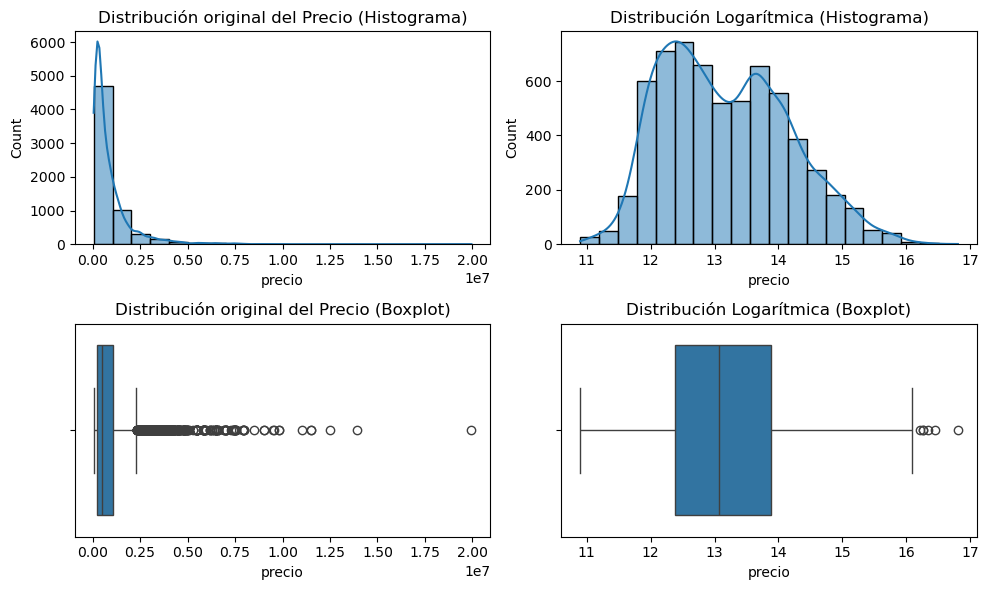

In [3035]:

# Crear una figura con 2 filas y 2 columnas para los gráficos
fig, axes = plt.subplots(2, 2, figsize=(10, 6))

# Primer gráfico: Histograma de la distribución original
sns.histplot(X_train_final["precio"], bins=20, kde=True, ax=axes[0, 0])
axes[0, 0].set_title("Distribución original del Precio (Histograma)")

# Segundo gráfico: Histograma de la distribución logarítmica
sns.histplot(np.log1p(X_train_final["precio"]), bins=20, kde=True, ax=axes[0, 1])
axes[0, 1].set_title("Distribución Logarítmica (Histograma)")

# Tercer gráfico: Boxplot de la distribución original
sns.boxplot(x=X_train_final["precio"], ax=axes[1, 0])
axes[1, 0].set_title("Distribución original del Precio (Boxplot)")

# Cuarto gráfico: Boxplot de la distribución logarítmica
sns.boxplot(x=np.log1p(X_train_final["precio"]), ax=axes[1, 1])
axes[1, 1].set_title("Distribución Logarítmica (Boxplot)")

# Ajustar el diseño para evitar superposiciones
plt.tight_layout()
plt.show()


Las gráficas muestran la distribución de la variable "precio" en su forma original y después de aplicar una transformación logarítmica.

####   Distribución Original del Precio (Histogramas y Boxplots)
- Histograma : La distribución del precio es altamente sesgada a la derecha (sesgo positivo). La mayoría de los valores están concentrados en el rango bajo, mientras que hay algunos valores extremadamente altos (colas largas).
- Boxplot : Se observa una gran cantidad de valores atípicos (outliers) que se alejan del cuerpo principal de la distribución, lo que sugiere que hay precios muy elevados en comparación con la mayoría.

####  Distribución Logarítmica del Precio
- Histograma : Después de aplicar una transformación logarítmica, la distribución se vuelve más simétrica y cercana a una distribución normal. Se reducen los efectos de la asimetría y la dispersión.
- Boxplot : Se observa que los valores están más equilibrados y los outliers están menos pronunciados, lo que indica que la transformación logarítmica ayuda a reducir la influencia de los valores extremos.

Por lo tanto, la transformación logaritmica suaviza considerablemente la distribución de la variable precio.

## *11.2 Distribución variables númericas continuas*

Vamos a analizar la distribución de las variables continuas con histogramas y graficos de violín

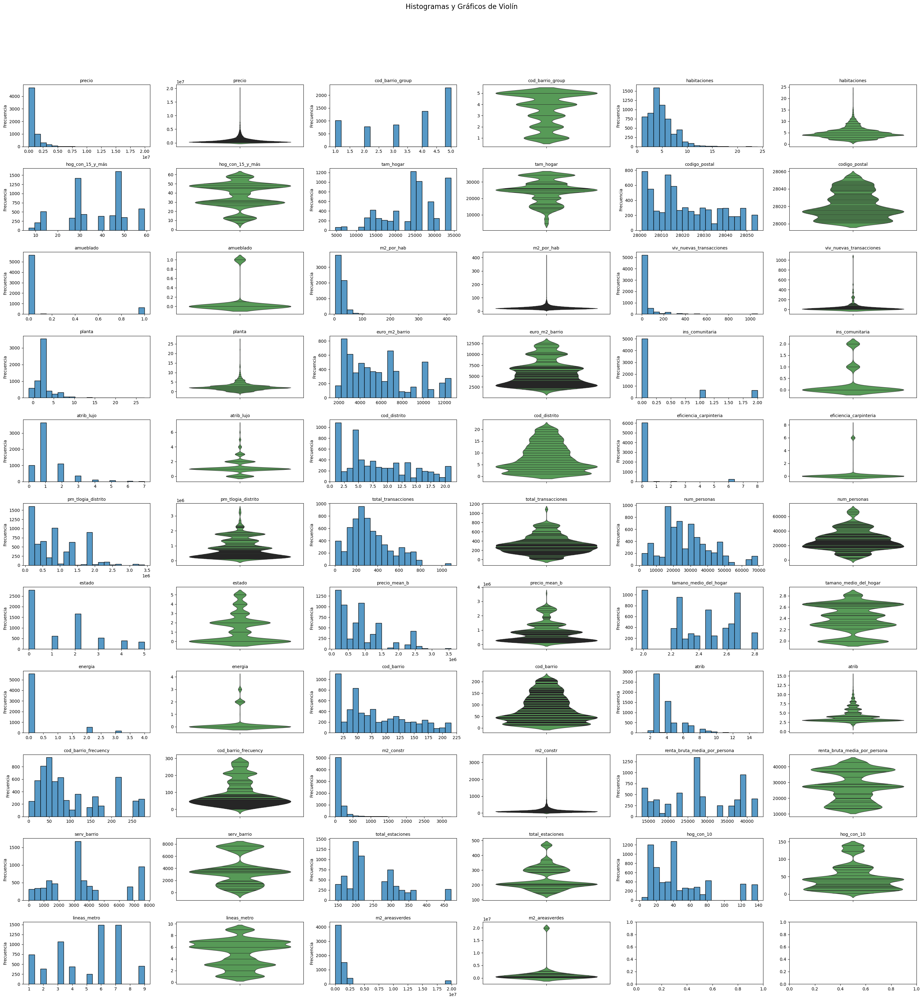

In [3036]:
# Gráfico con histogramas y violín

# Parámetros
var_porfila = 3  # Número de variables por fila
graf_porvariable = 2  # Histograma y violín
tot_var = len(num_nobool)

# Calcular el número de filas y columnas
n_cols = var_porfila * graf_porvariable  # Total de columnas por fila
n_rows = math.ceil(tot_var / var_porfila)  # Número de filas necesarias

# Crear subplots dinámicamente
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(30, 3 * n_rows))
fig.suptitle('Histogramas y Gráficos de Violín', fontsize=16)

if n_rows == 1:
    axes = axes.reshape(1, -1)  # Convierte a 2D si hay solo una fila

# Añadir gráficos
for i, col in enumerate(num_nobool):
    row = i // var_porfila  # Fila correspondiente
    col_hist = (i % var_porfila) * graf_porvariable  # Columna del histograma
    col_violin = col_hist + 1  # Columna del gráfico de violín

    # Histograma
    sns.histplot(X_train_final[col].dropna(), bins=20, ax=axes[row, col_hist])
    axes[row, col_hist].set_title(f'{col}', fontsize=10)
    axes[row, col_hist].set_xlabel("")
    axes[row, col_hist].set_ylabel("Frecuencia")

    # Gráfico de violín

    sns.violinplot(y=X_train_final[col].dropna(), ax=axes[row, col_violin], inner="stick", color='green', alpha=0.7)

    axes[row, col_violin].set_title(f'{col}', fontsize=10)
    axes[row, col_violin].set_ylabel("")
    axes[row, col_violin].set_xlabel("")

# Ajustar el diseño
plt.tight_layout()
plt.subplots_adjust(top=0.9)  # Reduce el espacio superior


Vamos a analizar algunas graficas de varaibles creadas en el proceso de featuring engineers

* cod_barrio_frecuency: Presenta varios barrios con frecuencias distintas. Algunos barrios tienen muchas propiedades mientras que otros tienen pocas.En el grafico de violin la presencia de  múltiples picos refuerza la idea de que hay diferencias significativas en la cantidad de propiedades por barrio. Analizaremos su impacto en el precio.
* pm_tipologia_distrito : Parece tener valores discretos, lo que sugiere que está categorizando distintos tipos de inmuebles dentro de cada distrito.
 Es posible que haya distritos con una mayor variedad de tipologías que otros.
* atrib : En el histograma podemos observar que la mayoría de los valores concentrados en un rango bajo.
El grafico de violín presenta una fuerte asimetría, lo que sugiere que la mayoría de las propiedades tienen pocos atributos y unas pocas tienen muchos.
* atrib_lujo: La mayoría de los valores parecen estar en 0, con unos pocos casos de valores altos,las viviendas de lujo son una minoría en el dataset.Analizaremos esta variable con el precio.
* euro_m2_barrio: Tiene una distribución más normal que otras varaibles.En el grafico de violin se
observan variaciones en los valores por barrio, indicando que algunos barrios tienen un precio por metro cuadrado significativamente más alto que otros. También pueden existir algunos valores extremos que representen barrios exclusivos o errores en los datos. Analizaremos esos valores.


atrib_lujo y euro_m2_barrio podrían estar directamente relacionados con precios altos y con zonas exclusivas, por lo que su análisis es clave para la predicción de precios.


## *11.3 Distribución variables númericas booleanas*

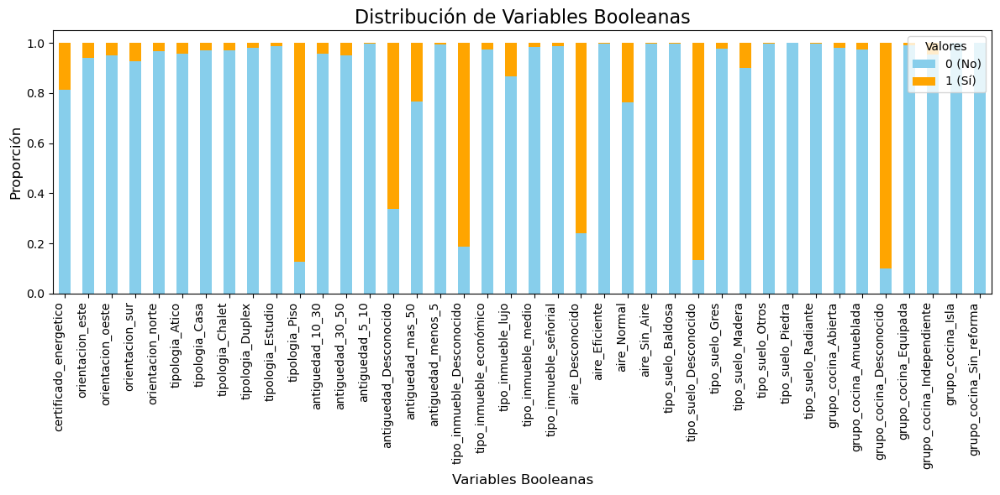

In [3037]:
graficar_booleanas_apiladas(X_train_final, cols_bool, titulo="Distribución de Variables Booleanas")

## *11.4 Relaciones entre variables*

##### Variable atrib_lujo vs precio

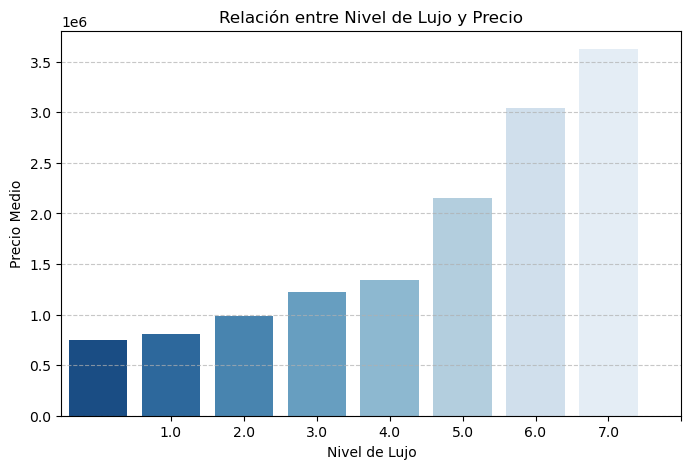

In [3039]:

# Suponiendo que tu DataFrame se llama X_train_final y tiene las columnas 'atrib_lujo' y 'precio'
plt.figure(figsize=(8, 5))
sns.barplot(x='atrib_lujo', y='precio', data=X_train_final, estimator=np.mean, ci=None, palette='Blues_r')

plt.xlabel('Nivel de Lujo')
plt.ylabel('Precio Medio')
plt.title('Relación entre Nivel de Lujo y Precio')
plt.xticks(range(1, 9))  # Asegura que solo se muestren los niveles del 1 al 8
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()


El grafico muestra como la media el precio es mayor cuando mayor es el valor de la variable atrib_lujo

##### Variable eurom2_barrio vs precio

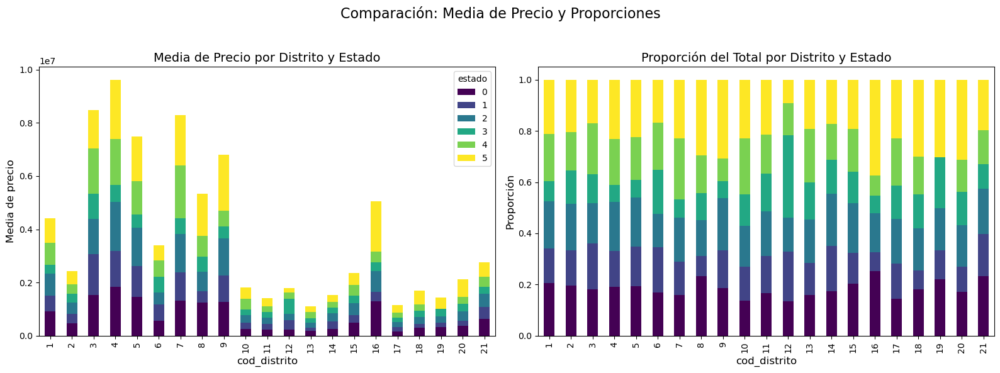

In [3040]:
# Llamar a la función para generar los gráficos
stacked_bar_plot_dual(
    df=X_train_final,
    x_var='cod_distrito',
    hue_var='estado',
    value_var='precio',
    title='Comparación: Media de Precio y Proporciones')

En la variable `estado`, el valor **0** indica datos desconocidos, el **1** corresponde a viviendas que requieren reforma, el **2** representa propiedades en buen estado, el **3** identifica viviendas en perfecto estado, el **4** señala viviendas reformadas y el **5** clasifica propiedades de obra nueva.

En el grafico de la izquierdamuestra cómo varía la media de los precios en cada distrito y cómo influye el estado de las viviendas. Por ejemplo, en el distrito 4 hay una media de precio muy alta con una gran proporción de viviendas en estado 5 (obra nueva), lo que sugiere que los precios más altos están en viviendas nuevas.
En el de la derechase observa la composición porcentual de los estados de las viviendas en cada distrito. Por ejemplo, algunos distritos tienen una alta proporción de viviendas en estado 5 (obra nueva), pe distrito 16, mientras que otros tienen más viviendas en estado 1 (necesitan reforma). Esto ayuda a entender la distribución del mercado inmobiliario en cada zona.



##### Matriz de correlación

In [3041]:
dfcorr =X_train_final.corr(numeric_only=True).copy()

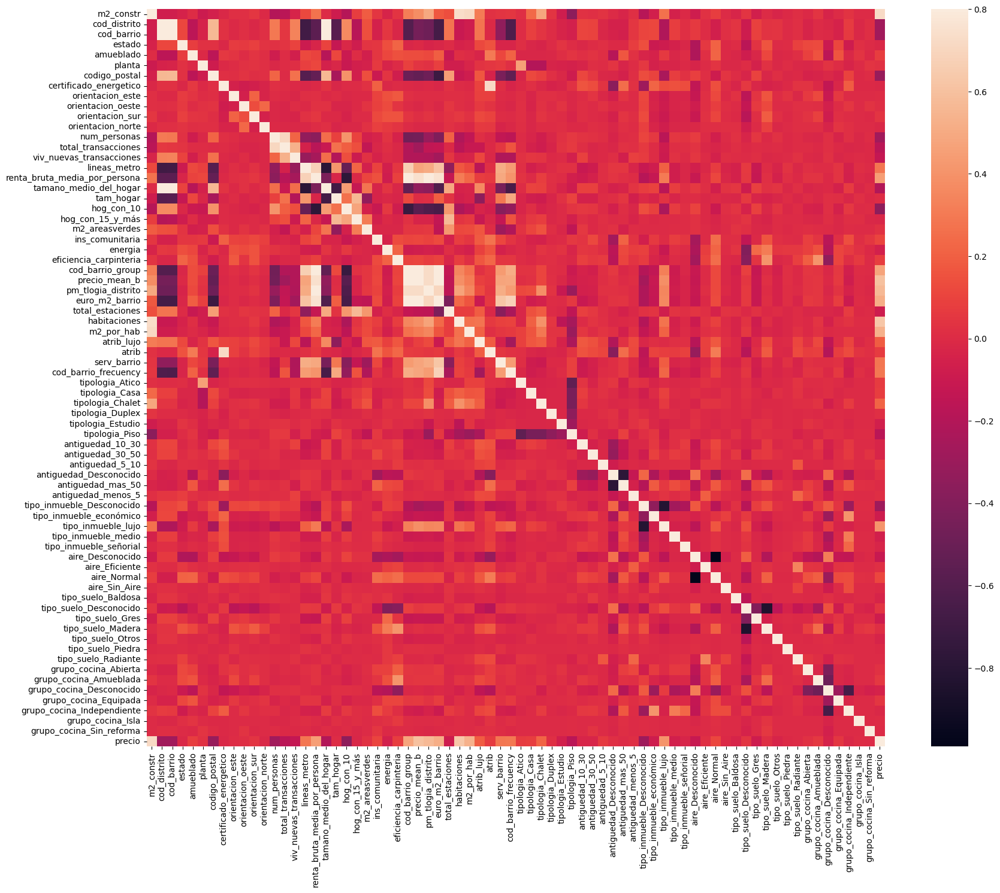

In [3042]:

f, ax = plt.subplots(figsize=(20, 16))
sns.heatmap(dfcorr, vmax=0.8, square=True);

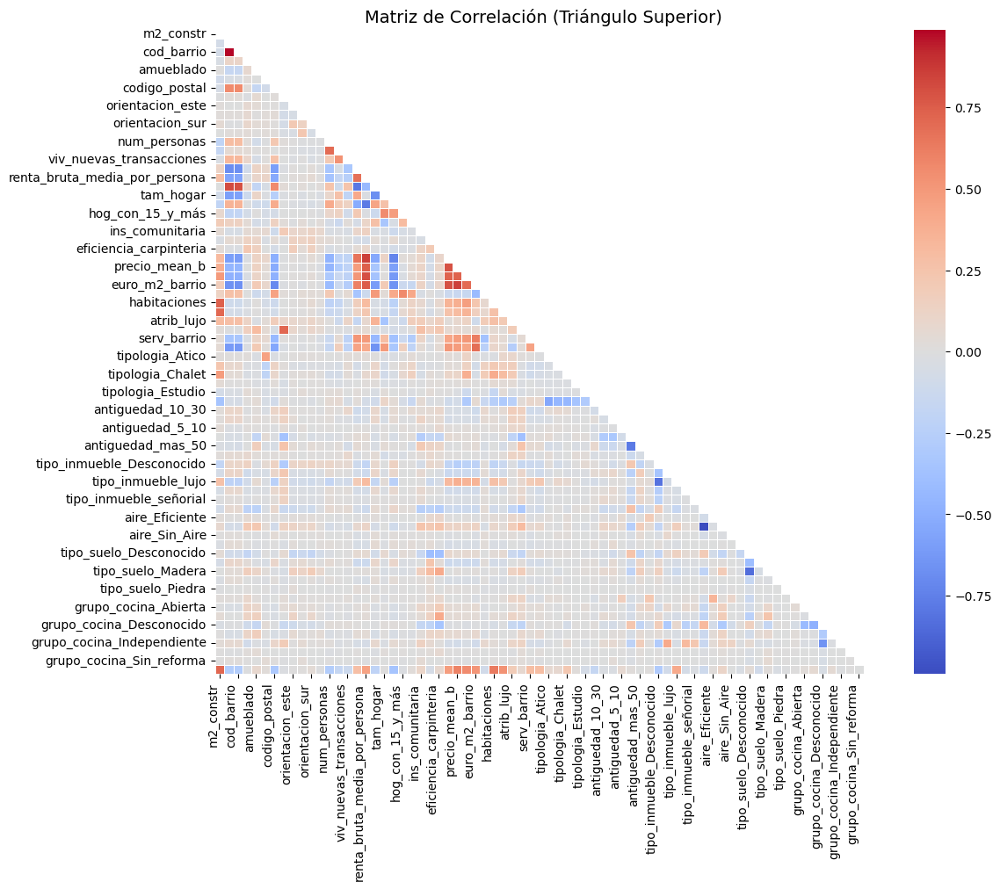

In [3043]:

# Establecer la máscara para el triángulo superior
mask = np.triu(np.ones_like(dfcorr, dtype=bool))

# Configurar el tamaño de la figura
plt.figure(figsize=(12, 10))

# Crear mapa de calor
sns.heatmap(dfcorr, mask=mask, cmap='coolwarm', annot=False, fmt=".2f", linewidths=0.5)

# Rotar etiquetas
plt.xticks(rotation=90, ha='right', fontsize=10)
plt.yticks(fontsize=10)

# Ajustar el diseño
plt.tight_layout()

# Mostrar gráfico
plt.title("Matriz de Correlación (Triángulo Superior)", fontsize=14)
plt.show()



**Relaciones fuertes y positivas**:
   - Algunas variables como `precio`, `m2_constr` (metros cuadrados construidos) y `euro_m2_barrio` (euros por metro cuadrado del barrio) probablemente tienen una correlación positiva alta. Esto refleja que precios más altos tienden a estar asociados con propiedades más grandes o ubicadas en barrios más caros.
   
**Relaciones negativas**:
   - Variables como `antiguedad` (años desde la construcción) pueden mostrar correlaciones negativas con el `precio`, lo cual indica que viviendas más antiguas tienden a ser menos costosas.

**Variables categóricas codificadas**:
   - Las categorías codificadas como `tipo_inmueble_lujo` o `aire_Eficiente` parecen tener correlaciones específicas con ciertos atributos de lujo o energía.

#### Valores Atipicos

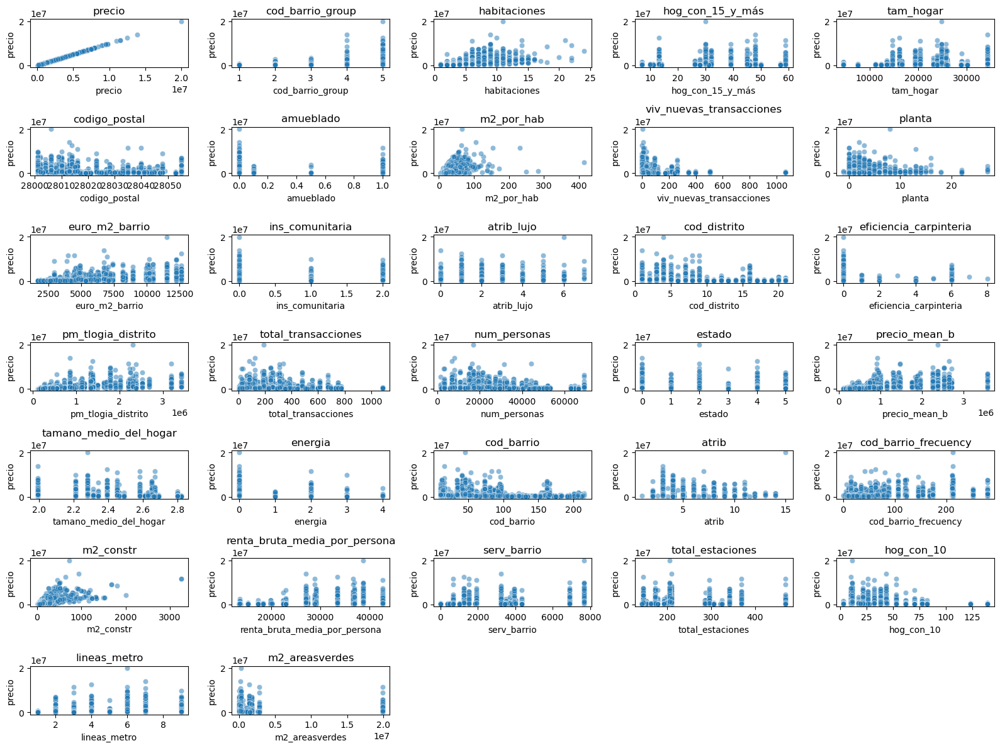

In [3044]:
# Ejemplo de uso: 
plot_scatter_matrix(X_train_final, num_nobool, target='precio')



 **1. Outliers en precio**  
- Hay algunas observaciones con precios extremadamente altos (en el orden de **10M+**).  
- Estos valores son propiedades de lujo ya que se ha comprobado que no son errores en los datos.  
- Será conveniente realizar la transformación logarítmica para tratarlos.  

 **2.Otras variables con outliers claros**  
- **m2_constr**: Hay algunas viviendas con **más de 2000-3000 m²**, lo cual es atípico para la mayoría de los casos.  
- **num_personas**: Existen algunos valores extremadamente altos, llegando a más de **60,000**, lo que indica que hay barrios con más población que otros.
- **serv_barrio**: Hay algunas observaciones con valores extremadamente altos, lo que indica que hay barrios con más dotación de servicios que otros.
- **renta_bruta_media_por_persona**: Se observan puntos alejados con valores superiores a **40,000**, que pueden ser valores de distritos con mejor nivel econmico.
- **m2_por_hab**: Hay valores inusualmente altos (**más de 800 m² por habitación**), lo que podría indicar errores en los datos.  


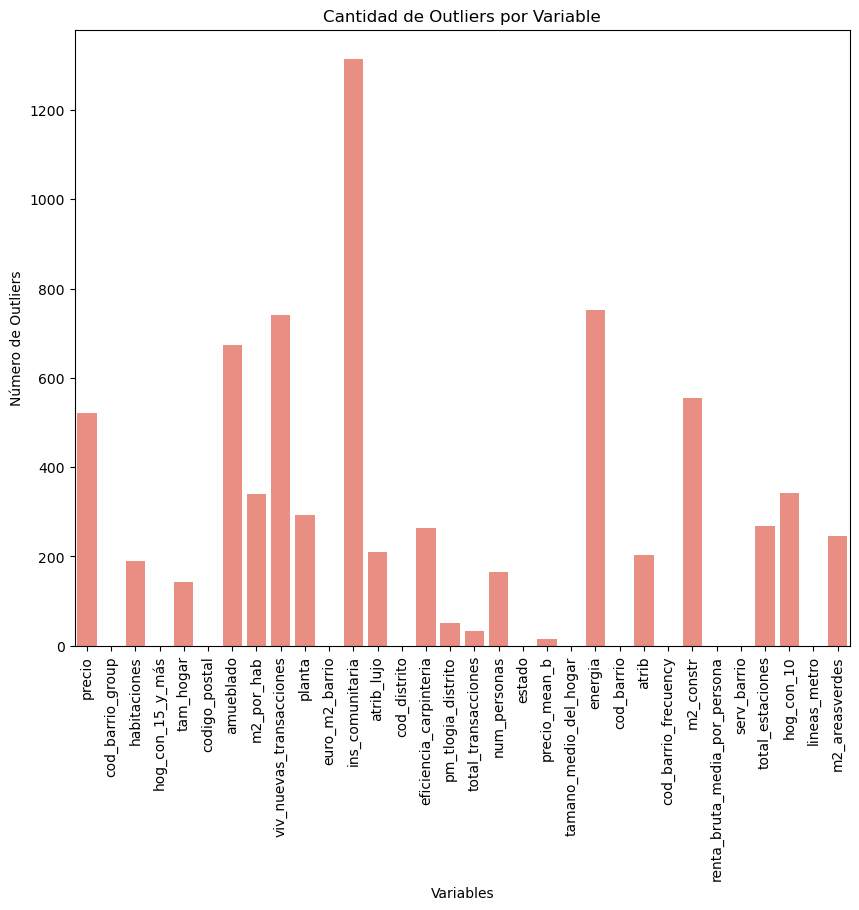

In [3045]:

plot_outliers_bar(X_train_final,num_nobool)

In [3046]:
X_train_final.query("m2_por_hab>200")

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,estado,amueblado,planta,codigo_postal,certificado_energetico,orientacion_este,orientacion_oeste,orientacion_sur,orientacion_norte,num_personas,total_transacciones,viv_nuevas_transacciones,lineas_metro,renta_bruta_media_por_persona,tamano_medio_del_hogar,tam_hogar,hog_con_10,hog_con_15_y_más,m2_areasverdes,ins_comunitaria,energia,eficiencia_carpinteria,cod_barrio_group,precio_mean_b,pm_tlogia_distrito,euro_m2_barrio,total_estaciones,habitaciones,m2_por_hab,atrib_lujo,atrib,serv_barrio,cod_barrio_frecuency,tipologia_Atico,tipologia_Casa,tipologia_Chalet,tipologia_Duplex,tipologia_Estudio,tipologia_Piso,antiguedad_10_30,antiguedad_30_50,antiguedad_5_10,antiguedad_Desconocido,antiguedad_mas_50,antiguedad_menos_5,tipo_inmueble_Desconocido,tipo_inmueble_económico,tipo_inmueble_lujo,tipo_inmueble_medio,tipo_inmueble_señorial,aire_Desconocido,aire_Eficiente,aire_Normal,aire_Sin_Aire,tipo_suelo_Baldosa,tipo_suelo_Desconocido,tipo_suelo_Gres,tipo_suelo_Madera,tipo_suelo_Otros,tipo_suelo_Piedra,tipo_suelo_Radiante,grupo_cocina_Abierta,grupo_cocina_Amueblada,grupo_cocina_Desconocido,grupo_cocina_Equipada,grupo_cocina_Independiente,grupo_cocina_Isla,grupo_cocina_Sin_reforma,precio
488,https://www.indomio.es/anuncios/95469291/,3250.00,Fuencarral-El Pardo,8,Peñagrande,83,0,0.00,0.00,28035,0.00,0.00,0.00,0.00,0.00,44341,336,20,3.00,28798.00,2.67,23923.00,53.00,48.00,2811379.00,0,0,0,4,915554.76,2204586.21,3982.32,469.00,14.00,232.14,3.00,3.00,660.00,42,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,11500000.00
2389,https://www.indomio.es/anuncios/96793989/,830.00,Chamartín,5,Hispanoamérica,54,2,0.00,1.00,28016,1.00,0.00,0.00,0.00,0.00,31470,311,12,7.00,42678.00,2.45,20435.00,32.00,45.00,214209.00,2,0,0,5,1472185.17,1130437.48,6986.99,296.00,2.00,415.00,1.00,6.00,1920.00,81,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,5000000.00
9364,https://www.pisosmadrid.com.es/propiedad/3984840-piso-en-venta-en-malasana-madrid,566.00,Centro,1,Universidad,15,0,1.00,2.00,28015,0.00,0.00,0.00,0.00,0.00,32783,613,30,7.00,27030.00,1.99,34155.00,43.00,48.00,223280.00,0,0,0,4,747468.25,852051.31,7225.79,210.00,2.00,283.00,0.00,4.00,3240.00,252,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1030000.00
1565,https://www.indomio.es/anuncios/96562297/,500.00,Ciudad Lineal,15,Pueblo Nuevo,152,0,0.00,0.00,28017,0.00,0.00,0.00,0.00,0.00,62840,774,31,5.00,22440.00,2.46,28853.00,62.00,46.00,572705.00,0,0,0,2,291661.31,1917900.00,3309.86,287.00,2.00,250.00,1.00,3.00,3792.00,84,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,695000.00


In [3047]:
#Eliminamos la propiedad https://www.pisosmadrid.com.es/propiedad/3984839-atico-en-venta-en-malasana-madrid	no tiene casi informaciin y si tuviera esa superficie seria mas caro
#lo eleiminamos por que es un error en los datos
X_train_final=X_train_final
# Filtrar las filas eliminando las que tienen esa URL
X_train_final = X_train_final[X_train_final['url'] != 'https://www.pisosmadrid.com.es/propiedad/3984839-atico-en-venta-en-malasana-madrid']
dftrain1_sinagrupar=dftrain1_sinagrupar[dftrain1_sinagrupar['url'] != 'https://www.pisosmadrid.com.es/propiedad/3984839-atico-en-venta-en-malasana-madrid']


In [3048]:
# Forzar la recolección de basura
gc.collect()

238975

# *13. Generación de ficheros .csv*


## *13.1 Exportación train,test,validacion para generación del modelo*

In [3049]:
# Ruta relativa del archivo
ruta_guardado_relativa = '../04-modelos/data/'

# Crear el directorio de destino si no existe
directorio_destino = os.path.dirname(ruta_guardado_relativa)
os.makedirs(directorio_destino, exist_ok=True)

# Guardar el DataFrame dfEDA en la ruta relativa especificada
#df_clustering.to_csv(ruta_guardado_relativa,sep=";", index=False)

In [3050]:
cols_eliminar=["cod_barrio_group","cod_distrito","cod_barrio","aire_Desconocido","barrio","distrito"]

# Aplicar la función a cada conjunto de datos con 5 columnas
X_train_final = X_train_final.drop(columns=cols_eliminar)
X_test_final  = X_test_final.drop(columns=cols_eliminar)
X_val_final = X_val_final.drop(columns=cols_eliminar)
X_train1_final = X_train1_final.drop(columns=cols_eliminar)
X_test1_final  = X_test1_final .drop(columns=cols_eliminar)



X_train_final.to_csv(ruta_guardado_relativa+"X_train.csv",sep=";",index=False)
X_test_final.to_csv(ruta_guardado_relativa+"X_test.csv",sep=";",index=False)
X_val_final.to_csv(ruta_guardado_relativa+"X_val.csv",sep=";",index=False)
X_train1_final.to_csv(ruta_guardado_relativa+"X_train_VC.csv",sep=";",index=False)
X_test1_final.to_csv(ruta_guardado_relativa+"X_test_VC.csv",sep=";",index=False)
df_ids.to_csv(ruta_guardado_relativa + "df_ids.csv", sep=";", index=False)

## *13.2 Exportación Clustering*



Se va a generar un dataframe con todos los datos para realizar el analisis del clustering

#Cambiar tipo de dato "cod_barrio","cod_distrito","cod_postal" a entero




In [3051]:
df_clustering = pd.concat([dftrain1_sinagrupar, X_test1_sinagrupar], axis=0, ignore_index=True)
# df_cluster_sinencoder = pd.concat([dftrain1sg, dftest1sg], axis=0, ignore_index=True)
# # Eliminar cualquier índice previo y reiniciar antes de guardar
df_clustering=df_clustering.drop(columns=["url","web"])
df_clustering.reset_index(drop=True, inplace=True)
df_clustering=reduce_mem_usage(df_clustering, turn_cat=False, silence=True)
# Ruta relativa del archivo
ruta_guardado_relativa = '../03-clustering/data/dfClustering.csv'

# Crear el directorio de destino si no existe
directorio_destino = os.path.dirname(ruta_guardado_relativa)
os.makedirs(directorio_destino, exist_ok=True)
# # Guardar el DataFrame dfEDA en la ruta relativa especificada
df_clustering.to_csv(ruta_guardado_relativa,sep=";", index=False)

In [3052]:

df_clustering1 = pd.concat([dftrain1_sg_connv, X_test1_sg_connv], axis=0, ignore_index=True)
# df_cluster_sinencoder = pd.concat([dftrain1sg, dftest1sg], axis=0, ignore_index=True)
# # Eliminar cualquier índice previo y reiniciar antes de guardar
df_clustering1=df_clustering1.drop(columns=["url","web"])
df_clustering1.reset_index(drop=True, inplace=True)
df_clustering1=reduce_mem_usage(df_clustering1, turn_cat=False, silence=True)
# Ruta relativa del archivo
ruta_guardado_relativa = '../03-clustering/data/dfClustering1.csv'

# Crear el directorio de destino si no existe
directorio_destino = os.path.dirname(ruta_guardado_relativa)
os.makedirs(directorio_destino, exist_ok=True)
# # Guardar el DataFrame dfEDA en la ruta relativa especificada
df_clustering1.to_csv(ruta_guardado_relativa,sep=";", index=False)

In [3053]:
cols = dfEDA_completo.columns
dfCluster_ChatGPT = dfEDA['url']

dfCluster_ChatGPT['detalle'] = dfEDA_completo[cols].apply(lambda row: ', '.join([f"{col}: {row[col]}" for col in cols]), axis=1)
    


# Ruta relativa del archivo
ruta_guardado_relativa = '../03-clustering/data/pisosCluster_ChatGPT.csv'

# Crear el directorio de destino si no existe
directorio_destino = os.path.dirname(ruta_guardado_relativa)
os.makedirs(directorio_destino, exist_ok=True)

# Guardar el DataFrame dfEDA en la ruta relativa especificada
dfCluster_ChatGPT.to_csv(ruta_guardado_relativa, index=False)

# *14. Conclusiones*

A partir del análisis realizado, se han obtenido varias conclusiones clave que deben tenerse en cuenta al preparar el modelo para predecir precios inmobiliarios en Madrid:

### 1. **Distribución del Precio:**
   - El precio muestra una **asimetría positiva**, con la mayoría de las propiedades en rangos de precio bajos, pero una pequeña proporción de propiedades de lujo eleva el promedio.
   - La **transformación logarítmica** de la variable de precio ayuda a suavizar la distribución, haciendo los datos más adecuados para el análisis.

### 2. **Impacto de las Variables Numéricas:**
   - Variables como **metros cuadrados construidos (m2_constr)**, **número de dormitorios** y **baños** están correlacionadas positivamente con el precio, lo que indica que las propiedades más grandes son más caras.
   - Factores socioeconómicos como la **renta bruta media por persona** y los **servicios del barrio** también influyen en el precio de manera significativa.

### 3. **Influencias de Variables Categóricas:**
   - **Ubicación** (distrito y barrio) es un factor clave que determina los precios, con barrios exclusivos (como Salamanca) mostrando precios más altos.
   - Otras variables como el **estado** de la propiedad y **atributos de lujo** (piscina, jardín privado) también tienen un fuerte impacto en los precios.

### 4. **Limpieza y Transformación de Datos:**
   - **Imputación de valores nulos**: Se abordaron valores nulos en variables clave (baños, dormitorios) utilizando estadísticas del barrio/distrito.
   - Se eliminaron columnas con más del 95% de valores nulos.
   - **Transformaciones y agrupaciones** de variables, como la codificación de categorías y el desglose de algunas características (como calefacción), facilitaron el análisis.

### 5. **Patrones del Mercado Inmobiliario:**
   - **Ubicación premium**: Los distritos exclusivos muestran precios altos independientemente del tamaño, lo que indica una fuerte influencia de la demanda.
   - Las propiedades con **atributos de lujo** tienen un precio significativamente más alto.
   - El mercado muestra una **gran variabilidad** en características como el tamaño y los servicios del barrio, lo que refleja la diversidad del mercado.

### 6. **Preparación para el Modelado:**
   - **División de datos estratificada** según el precio promedio para asegurar que los conjuntos de entrenamiento, validación y test sean representativos.
   - **Feature engineering**: Se generaron nuevas variables (precio medio por barrio, proporción m2/ habitaciones) que proporcionan contexto adicional para mejorar la precisión del modelo.

### Inputs claves para el Modelo:
1. **Variables económicas y de localización**: La incorporación de variables como el **precio medio por barrio** y la **renta bruta media por persona** es crucial para capturar el contexto socioeconómico y la influencia de la ubicación en los precios.
2. **Accesibilidad y servicios**: Variables como **total estaciones** y **servicios barrio** aportan información sobre la calidad de vida y la accesibilidad al transporte, factores clave en la valoración de propiedades.
3. **Atributos de la vivienda**: La codificación de variables categóricas, como **tipología** y **estado**, facilitará la integración de estos datos en el modelo.
4. **Outliers**: Se deben evaluar los **valores atípicos** para determinar si afectan negativamente el rendimiento del modelo. Se aplicarán tecnicas como RobustScaler para para manejar estos valores sin perder información importante.

En conclusión, con el tratamiento adecuado de los datos, la incorporación de nuevas variables y elanálisis estadístico detallado, el modelo será más preciso y podrá predecir de manera más efectiva los precios inmobiliarios.